In [1]:
import cv2
import ast
import os
import json
import numpy as np
import tensorflow as tf
import math
import collections
import sys
import matplotlib.pyplot as plt
from matplotlib.image import imread
import Network as net
import matplotlib
import os.path

C:\Users\SimJaekyu\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
def make_heatmap(batch_anno_data, width = 44, height = 44, num_of_maps = 22):
    batch_size = len(batch_anno_data)
    width = 44
    height = 44
    num_of_maps = 22
    output = np.zeros((batch_size, width, height, num_of_maps))
    for index, joint_data in enumerate(batch_anno_data):

        heatmap = np.zeros((width, height, num_of_maps), np.int16)#batch 일단 뺌

        for joints in joint_data:
            #print(joints)
            buffer = list(joints.items())
            key_buffer = joints.keys()

            for i in range(len(buffer)):
                buffer[i] = list(buffer[i])
                buffer[i][0] = int(buffer[i][0])
            bubble_sort(buffer)

            idx = 0
            for j in range(22):

                #print(j)
                if('%d' %j in key_buffer):
                    center_x = buffer[idx][1][0]
                    center_y = buffer[idx][1][1]
                    #joint = buffer[idx][1]
                    joint = [center_y, center_x]
                    idx = idx + 1
                    _put_heatmap_on_plane(heatmap, plane_idx = j, joint = joint, sigma = 3, height = height, width = width, stride = 1)
                else:
                    pass
            idx = 0
        heatmap[:, :, -1] = np.clip(1.0 - np.amax(heatmap, axis=2), 0.0, 1.0)
        output[index] = heatmap
    return output

def make_paf_field(batch_joint_data, width = 44, height = 44, num_of_maps = 22):
    batch_size = len(batch_joint_data)
    output1 = np.zeros((batch_size, width, height, num_of_maps*2))
    output2 = np.zeros((batch_size, width, height, num_of_maps))
    for index, joint_data in enumerate(batch_joint_data):
        joint_pairs = list(zip(
            [0, 1, 2, 3, 0, 5, 6, 7, 0, 9,  10, 11,  0, 13, 14, 15,  0, 17, 18, 19],
            [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20]))
        #make vector map
        width = 44
        height = 44
        num_of_maps = 22
        vectormap = np.zeros((width, height, num_of_maps*2), dtype=np.float32)#batch 일단 뺌
        countmap = np.zeros((width, height, num_of_maps), np.int16)#batch 일단 뺌

        for joints in joint_data:
            key = (joints.keys())
            for plane_idx, (j_idx1, j_idx2) in enumerate(joint_pairs):
                if(('%d' %j_idx1 in key) and ('%d' %j_idx2 in key)):

                    center_from = joints['%d'%j_idx1]
                    center_to = joints['%d'%j_idx2]

                    if not center_from or not center_to:
                        continue
                    _put_paf_on_plane(vectormap=vectormap, countmap=countmap, plane_idx=plane_idx, center_from=center_from, center_to=center_to, threshold=1, height=44, width=44, stride = 1)

        nonzeros = np.nonzero(countmap)


        for x, y, p in zip(nonzeros[0], nonzeros[1], nonzeros[2]):
            if countmap[x][y][p] <= 0:
                continue
            vectormap[x][y][p*2+0] /= countmap[x][y][p]
            vectormap[x][y][p*2+1] /= countmap[x][y][p]

        output1[index] = vectormap.astype(np.float32)
        output2[index] = countmap
    return output1, output2 #output1 -> vectormap, output2 -> countmap

def _put_heatmap_on_plane(heatmap, plane_idx, joint, sigma, height, width, stride):
    start = stride / 2.0 - 0.5

    center_x, center_y = joint

    for g_y in range(height):
        for g_x in range(width):
            x = start + g_x * stride
            y = start + g_y * stride
            d2 = (x-center_x) * (x-center_x) + (y-center_y) * (y-center_y)
            exponent = d2 / 2.0 / sigma / sigma
            if exponent > 4.6052:
                continue

            heatmap[g_y, g_x, plane_idx] += math.exp(-exponent)
            if heatmap[g_y, g_x, plane_idx] > 1.0:
                heatmap[g_y, g_x, plane_idx] = 1.0
                
                
def _put_paf_on_plane(vectormap, countmap, plane_idx, center_from, center_to, threshold, height, width, stride):
    center_from = (center_from[0] // stride, center_from[1] // stride)
    center_to = (center_to[0] // stride, center_to[1] // stride)

    vec_x = center_to[0] - center_from[0]
    vec_y = center_to[1] - center_from[1]

    min_x = max(0, int(min(center_from[0], center_to[0]) - threshold))
    min_y = max(0, int(min(center_from[1], center_to[1]) - threshold))

    max_x = min(width, int(max(center_from[0], center_to[0]) + threshold))
    max_y = min(height, int(max(center_from[1], center_to[1]) + threshold))

    norm = math.sqrt(vec_x ** 2 + vec_y ** 2)
    if norm < 1e-8: #1e-8 이하는 0으로 인식되서 0으로 나눌수 없다는 에러 발생. 따라서 return처리 해줌
        return

    vec_x /= norm
    vec_y /= norm
    
    for x in range(min_x, max_x):
        for y in range(min_y, max_y):
            bec_x = x - center_from[0]
            bec_y = y - center_from[1]
            dist = abs(bec_x * vec_y - bec_y * vec_x)

            if dist > threshold:
                continue

            countmap[x][y][plane_idx] = countmap[x][y][plane_idx] + 1

            vectormap[x][y][plane_idx*2+0] = vec_x
            vectormap[x][y][plane_idx*2+1] = vec_y
def bubble_sort(L):
    for i in range(len(L)-1):
        for j in range(len(L)-1):
            if L[j] > L[j+1]:
                temp = L[j+1]
                L[j+1] = L[j]
                L[j] = temp      

In [3]:
#joint_result = np.load('./dataset/Hands/hand_labels/Annotation/hands_joint_data.npy')

In [4]:
#img_list = np.load('./dataset/Hands/hand_labels/Annotation/hands_img_data.npy')

In [5]:
"""img_list[0].index('in/')
path = []
for i in range(len(img_list)):
    path.append('./dataset/Hands/hand_labels/Resized_Image/' + img_list[i][img_list[i].index('in/') + 3:])
for i in range(len(img_list)):
    img_data = cv2.imread(img_list[i])
    resized_img = cv2.resize(img_data, (356, 356))
    
    cv2.imwrite(path[i], resized_img)"""

"img_list[0].index('in/')\npath = []\nfor i in range(len(img_list)):\n    path.append('./dataset/Hands/hand_labels/Resized_Image/' + img_list[i][img_list[i].index('in/') + 3:])\nfor i in range(len(img_list)):\n    img_data = cv2.imread(img_list[i])\n    resized_img = cv2.resize(img_data, (356, 356))\n    \n    cv2.imwrite(path[i], resized_img)"

In [6]:
"""img_data = cv2.imread(path[0])
aa = make_heatmap([[joint_result[0]]])
aaa = np.transpose(aa[0], [2, 1, 0])
buffer = np.zeros((356, 356))
for i in range(len(aaa)-1):
    #plt.imshow(aaa[i])
    #plt.show()
    #print(np.max(aaa[i]))
    buffer = buffer + aaa[i]
plt.imshow(buffer)
plt.show()
resized_heatmap = cv2.resize(buffer, (np.shape(img_data)[1], np.shape(img_data)[0]))
plt.imshow(img_data[:, :, [2, 1, 0]])
plt.imshow(resized_heatmap[:,:], alpha=.7)#alpha -> 이미지 얼마나 선명한가. heatmap_avg[:,:,0] -> 1:r_knee

fig = matplotlib.pyplot.gcf()
cax = matplotlib.pyplot.gca()
fig.set_size_inches(20, 20)
fig.subplots_adjust(right=0.93)
cbar_ax = fig.add_axes([0.95, 0.15, 0.01, 0.7])"""

'img_data = cv2.imread(path[0])\naa = make_heatmap([[joint_result[0]]])\naaa = np.transpose(aa[0], [2, 1, 0])\nbuffer = np.zeros((356, 356))\nfor i in range(len(aaa)-1):\n    #plt.imshow(aaa[i])\n    #plt.show()\n    #print(np.max(aaa[i]))\n    buffer = buffer + aaa[i]\nplt.imshow(buffer)\nplt.show()\nresized_heatmap = cv2.resize(buffer, (np.shape(img_data)[1], np.shape(img_data)[0]))\nplt.imshow(img_data[:, :, [2, 1, 0]])\nplt.imshow(resized_heatmap[:,:], alpha=.7)#alpha -> 이미지 얼마나 선명한가. heatmap_avg[:,:,0] -> 1:r_knee\n\nfig = matplotlib.pyplot.gcf()\ncax = matplotlib.pyplot.gca()\nfig.set_size_inches(20, 20)\nfig.subplots_adjust(right=0.93)\ncbar_ax = fig.add_axes([0.95, 0.15, 0.01, 0.7])'

In [7]:
"""for i in range(len(joint_result[0])):
    joint_result[0]['%d'%i] = joint_result[0]['%d'%i][0:2]
aa, bb = make_paf_field([[joint_result[0]]])
bbb = np.transpose(bb[0], [2, 1, 0])
buffer = np.zeros((356, 356))
for i in range(len(bbb)):
    plt.imshow(bbb[i])
    plt.show()
    print(np.max(bbb[i]))
    buffer = buffer + bbb[i]
plt.imshow(buffer)
plt.show()
resized_buffer = cv2.resize(buffer, (np.shape(img_data)[1], np.shape(img_data)[0]))
plt.imshow(img_data[:, :, [2, 1, 0]])
plt.imshow(resized_buffer[:,:], alpha=.7)#alpha -> 이미지 얼마나 선명한가. heatmap_avg[:,:,0] -> 1:r_knee

fig = matplotlib.pyplot.gcf()
cax = matplotlib.pyplot.gca()
fig.set_size_inches(20, 20)
fig.subplots_adjust(right=0.93)
cbar_ax = fig.add_axes([0.95, 0.15, 0.01, 0.7])"""

"for i in range(len(joint_result[0])):\n    joint_result[0]['%d'%i] = joint_result[0]['%d'%i][0:2]\naa, bb = make_paf_field([[joint_result[0]]])\nbbb = np.transpose(bb[0], [2, 1, 0])\nbuffer = np.zeros((356, 356))\nfor i in range(len(bbb)):\n    plt.imshow(bbb[i])\n    plt.show()\n    print(np.max(bbb[i]))\n    buffer = buffer + bbb[i]\nplt.imshow(buffer)\nplt.show()\nresized_buffer = cv2.resize(buffer, (np.shape(img_data)[1], np.shape(img_data)[0]))\nplt.imshow(img_data[:, :, [2, 1, 0]])\nplt.imshow(resized_buffer[:,:], alpha=.7)#alpha -> 이미지 얼마나 선명한가. heatmap_avg[:,:,0] -> 1:r_knee\n\nfig = matplotlib.pyplot.gcf()\ncax = matplotlib.pyplot.gca()\nfig.set_size_inches(20, 20)\nfig.subplots_adjust(right=0.93)\ncbar_ax = fig.add_axes([0.95, 0.15, 0.01, 0.7])"

In [3]:
def make_batch(img_path, anno_data, batch_size = 16):
    num_of_data = len(img_path)
    index = np.arange(0, num_of_data)
    np.random.shuffle(index)
    index = index[:batch_size]
    
    shuffled_img_data = [img_path[i] for i in index]
    #shuffled_anno_data = [anno_data[j] for j in index]
    shuffled_anno_data = [[anno_data[j:j+1]][0][0] for j in index]
    #shuffled_anno_data = [anno_data[j:j+1][0][0][0] for j in index]
    
    return np.asarray(shuffled_img_data), np.asarray(shuffled_anno_data)

def load_data():
    joint_result = np.load('./dataset/Hands/hand_labels/Annotation/cropped_resized_hands_joint_data.npy')
    train_file_list = np.load('./dataset/Hands/hand_labels/Annotation/cropped_resized_hands_img_list.npy')
    return train_file_list, joint_result

def path_to_image(img_path, batch_size):
    #buffer 선언
    image_data = np.zeros((batch_size, 356, 356, 3), np.uint8)
    
    index = 0
    for img in (img_path):
        image_data[index] = cv2.imread(img)
        index = index + 1

    return image_data

In [4]:
class OpenPose():
    def __init__(self, sess, epochs, batch_size):
        self.sess = sess
        self.epochs = epochs
        self.batch_size = batch_size
        self.img_input = tf.placeholder(dtype=tf.float32, shape=[None, 356, 356, 3])
        self.confidencemap = tf.placeholder(dtype = tf.float32, shape = [None, 44, 44, 22])
        self.PAFs = tf.placeholder(dtype = tf.float32, shape = [None, 44, 44, 44])
        
        self.model()
        self.optimizer()
        print("open pose init complete")
        
    def model(self):
        self.Feature = net.block_vgg_19_hand(self.img_input)#stage0_data - None, 44, 44, 512
        #self.Feature = net.block_vgg_19_hand(self.img_input)#stage0_data - None, 44, 44, 512
        
        self.stage1_branch = net.block_stage_1_hand(self.Feature)#stage1_branch - None, 44, 44, 34
        #self.stage1_branch = net.block_stage_1(self.Feature)#stage1_branch - None, 44, 44, 34
        self.stage1_data = tf.concat([self.stage1_branch, self.Feature], 3)
        
        self.stage2_branch = net.block_stage_2_hand(self.stage1_data)#stage2_branch - None, 44, 44, 34
        #self.stage2_branch = net.block_stage_2(self.stage1_data)#stage2_branch - None, 44, 44, 34
        self.stage2_data = tf.concat([self.stage2_branch, self.Feature], 3)
        
        self.stage3_branch = net.block_stage_3_hand(self.stage2_data)#stage3_branch - None, 44, 44, 34
        #self.stage3_branch = net.block_stage_3(self.stage2_data)#stage3_branch - None, 44, 44, 34
        self.stage3_data = tf.concat([self.stage3_branch, self.Feature], 3)
        
        self.stage4_branch = net.block_stage_4_hand(self.stage3_data)#stage4_branch - None, 44, 44, 34
        #self.stage4_branch = net.block_stage_4(self.stage3_data)#stage4_branch - None, 44, 44, 34
        self.stage4_data = tf.concat([self.stage4_branch, self.Feature], 3)
        
        self.stage5_branch = net.block_stage_5_hand(self.stage4_data)#stage5_branch - None, 44, 44, 17
        #self.stage5_branch = net.block_stage_5(self.stage4_data)#stage5_branch - None, 44, 44, 17
        #self.stage5_data = tf.concat([self.stage5_branch, stage0_data], 3)
        
        self.stage6_branch = net.block_stage_6_hand(self.stage5_branch)#stage6_branch - None, 44, 44, 17
        #self.stage6_branch = net.block_stage_6(self.stage5_branch)#stage6_branch - None, 44, 44, 17
        #self.stage6_data = tf.concat([self.stage6_branch, stage0_data], 3)
        
    def optimizer(self):
        W_p = 1
        #loss는 euclid loss 함수 사용
        
        #PAFs loss - branch1
        self.loss_stage1_branch = tf.nn.l2_loss(W_p*(self.stage1_branch - self.PAFs)) / self.batch_size
        self.loss_stage2_branch = tf.nn.l2_loss(W_p*(self.stage2_branch - self.PAFs)) / self.batch_size
        self.loss_stage3_branch = tf.nn.l2_loss(W_p*(self.stage3_branch - self.PAFs)) / self.batch_size
        self.loss_stage4_branch = tf.nn.l2_loss(W_p*(self.stage4_branch - self.PAFs)) / self.batch_size
        self.loss_stage5_branch = tf.nn.l2_loss(W_p*(self.stage5_branch - self.confidencemap)) / self.batch_size
        self.loss_stage6_branch = tf.nn.l2_loss(W_p*(self.stage6_branch - self.confidencemap)) / self.batch_size
        
        #confidencemap loss - branch2
        self.loss1 = tf.reduce_mean([self.loss_stage1_branch])
        self.loss2 = tf.reduce_mean([self.loss_stage2_branch])
        self.loss3 = tf.reduce_mean([self.loss_stage3_branch])
        self.loss4 = tf.reduce_mean([self.loss_stage4_branch])
        self.loss5 = tf.reduce_mean([self.loss_stage5_branch])
        self.loss6 = tf.reduce_mean([self.loss_stage6_branch])
        
        self.total_loss = (self.loss1 + self.loss2 + self.loss3 + self.loss4 + self.loss5 + self.loss6) / self.batch_size
        
        global_step = tf.Variable(0, trainable=False)
        starter_learning_rate = 4e-5
        lr = tf.train.exponential_decay(starter_learning_rate, global_step,10000, 0.333, staircase=True)
        self.optimizer_total_loss = tf.train.AdamOptimizer(learning_rate=lr).minimize(self.total_loss, global_step=global_step)
        
        
    def train(self):
        data_size = 1912#28883#41749
        batch_size = self.batch_size
        total_batch = data_size//batch_size

        confidencemap_loss_data = []
        PAFs_loss_data = []
        
        SAVE_PATH = "C:/Users/SimJaekyu/Documents/Jupyter Notebook/Pose_Estimation_with_Hand/Weight_Hand/Weight.ckpt"
        print("session start")
        self.sess.run(tf.global_variables_initializer())
        saver = tf.train.Saver()
        print("training data load start")
        self.image_path, self.annotation_data = load_data()
        print("training data load finish")
        try:
            saver.restore(self.sess, SAVE_PATH)
            print("load")
        except:
            print("first training")


        for epoch in range(self.epochs):#15
            print("epoch",epoch+1, "start")
            for i in range(total_batch):#total_batch
                #data load, batch 생성
                batch_img_path, batch_annotation= make_batch(img_path = self.image_path, anno_data = self.annotation_data, batch_size = batch_size)
                batch_img = path_to_image(batch_img_path, batch_size)

                #batch_img, batch_annotation - input data
                #print(batch_annotation)
                confidencemap = []
                PAFs = []
                countmap = []
                for ii in range(len(batch_annotation)):
                    x = make_heatmap([[batch_annotation[ii]]], width=44, height=44, num_of_maps=22)
                    #y = np.transpose(x[0], [2, 0, 1])
                    #print(np.shape(x))
                    
                    confidencemap.append(x[0])
                    a, b = make_paf_field([[batch_annotation[ii]]], width = 44, height = 44, num_of_maps = 22)
                    #print(np.shape(a), np.shape(b))
                    PAFs.append(a[0])
                    countmap.append(b[0])
                    #plt.imshow(y[16])
                    #plt.show()
                #print(np.shape(confidencemap))
                #confidencemap = np.transpose(confidencemap, [0, 2, 1, 3])
                #return batch_img, confidencemap, PAFs
                #plt.imshow(confidencemap)
                
                
                total_loss_opt, Heat_loss, Vector_loss = \
                self.sess.run([self.optimizer_total_loss, self.loss_stage6_branch, self.loss_stage4_branch],
                         feed_dict = {self.img_input : batch_img, self.confidencemap : confidencemap, self.PAFs : PAFs})
                
                confidencemap_loss_data.append(Heat_loss)
                PAFs_loss_data.append(Vector_loss)
            
            _confidencemap, _PAFs = self.sess.run([self.stage6_branch, self.stage4_branch], feed_dict = {self.img_input : batch_img})
            plt.imshow(batch_img[0])
            plt.show()
            
            __confidencemap = np.transpose(_confidencemap[0], [2, 0, 1])
            predict_buffer = np.zeros((44, 44), dtype = np.float32)
            for ii in range(len(__confidencemap)-1):
                predict_buffer = predict_buffer + __confidencemap[ii]
            
            plt.imshow(predict_buffer)
            plt.show()
            
            
            t_confidencemap = np.transpose(confidencemap, [0, 3, 2, 1])
            label_buffer = np.zeros((44, 44), dtype = np.float32)
            for ii in range(len(t_confidencemap[0])-1):
                label_buffer = label_buffer + t_confidencemap[0][ii]
            plt.imshow(label_buffer)
            plt.show()
            
            
            print("heatmap cost")
            print("Heat_loss : ", Heat_loss)
            print("vectormap cost")
            print("Vector_loss : ", Vector_loss)
            print('\n')



            plt.plot(confidencemap_loss_data)
            plt.show()
            plt.plot(PAFs_loss_data)
            plt.show()
            saver.save(self.sess, SAVE_PATH)

        
print("cell end")

cell end


open pose init complete
session start
training data load start
training data load finish
INFO:tensorflow:Restoring parameters from C:/Users/SimJaekyu/Documents/Jupyter Notebook/Pose_Estimation_with_Hand/Weight_Hand/Weight.ckpt
first training
epoch 1 start


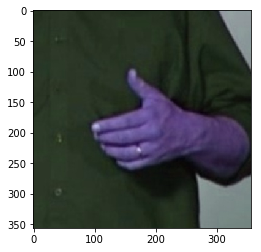

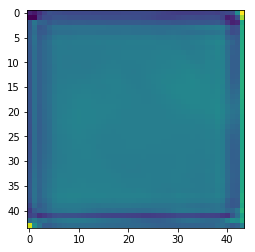

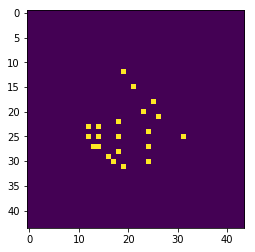

heatmap cost
Heat_loss :  36.591373
vectormap cost
Vector_loss :  145.88606




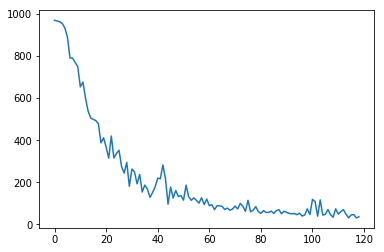

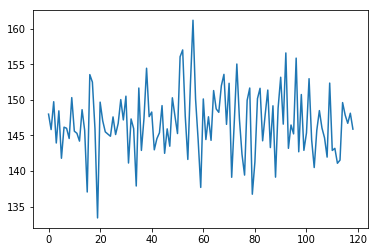

epoch 2 start


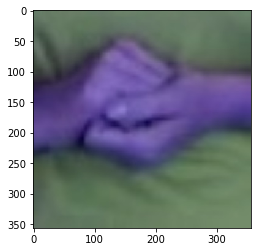

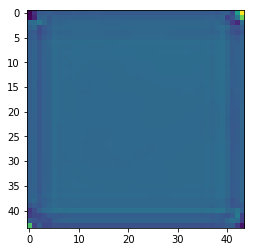

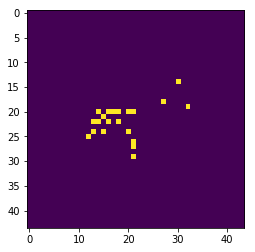

heatmap cost
Heat_loss :  20.803753
vectormap cost
Vector_loss :  132.59644




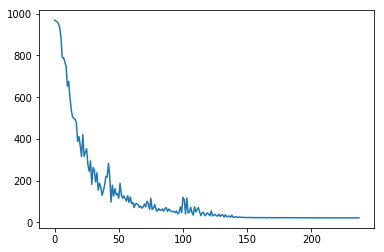

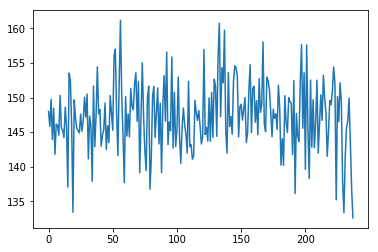

epoch 3 start


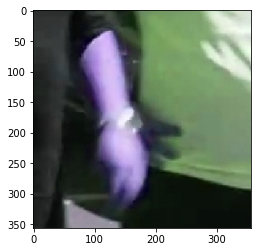

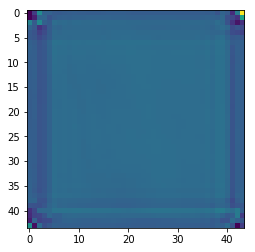

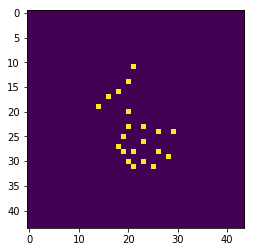

heatmap cost
Heat_loss :  20.375881
vectormap cost
Vector_loss :  141.55394




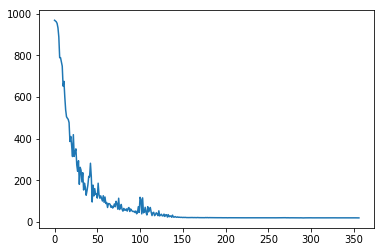

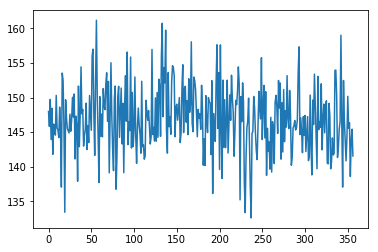

epoch 4 start


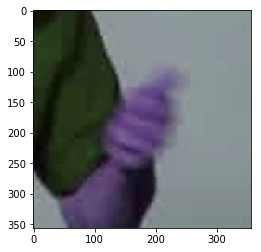

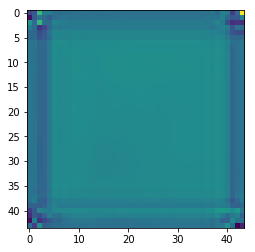

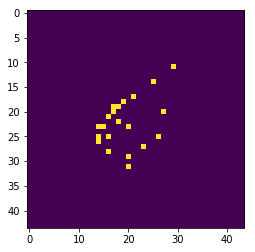

heatmap cost
Heat_loss :  20.557594
vectormap cost
Vector_loss :  143.6768




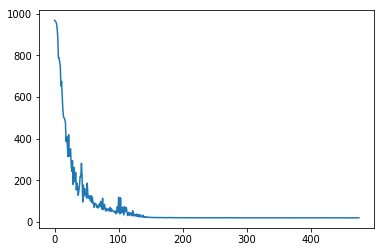

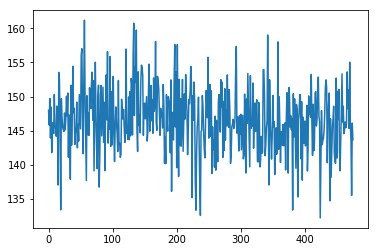

epoch 5 start


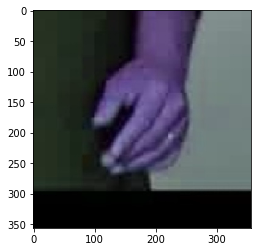

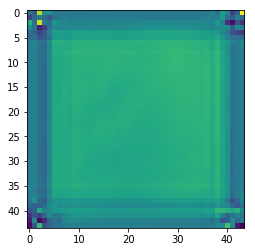

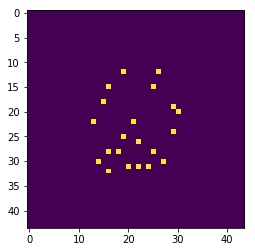

heatmap cost
Heat_loss :  20.408339
vectormap cost
Vector_loss :  144.29068




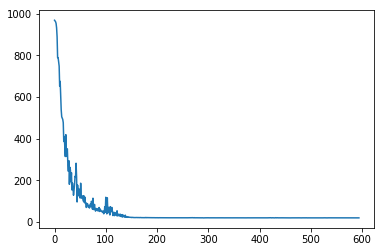

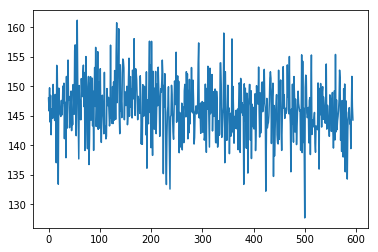

epoch 6 start


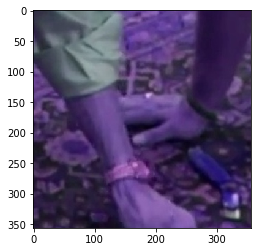

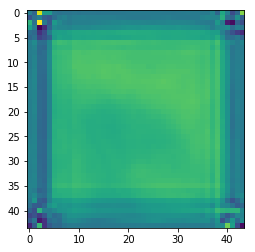

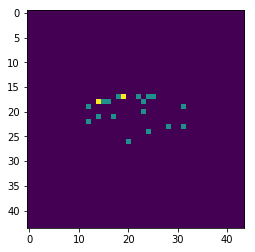

heatmap cost
Heat_loss :  20.603497
vectormap cost
Vector_loss :  139.66856




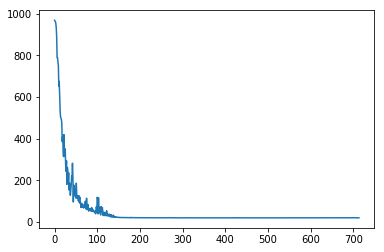

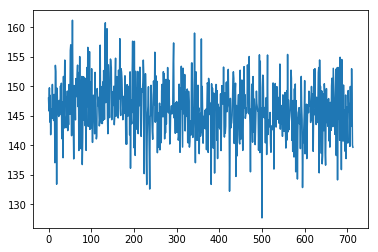

epoch 7 start


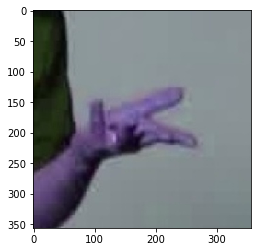

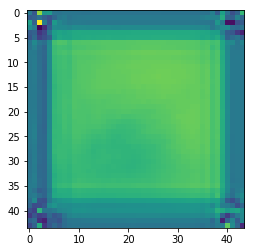

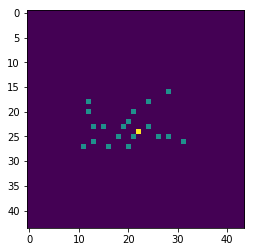

heatmap cost
Heat_loss :  20.411345
vectormap cost
Vector_loss :  139.29475




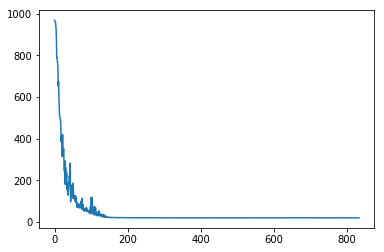

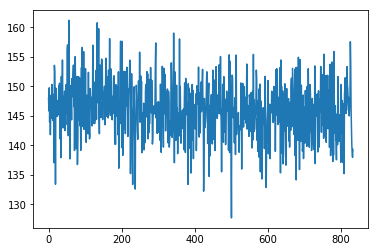

epoch 8 start


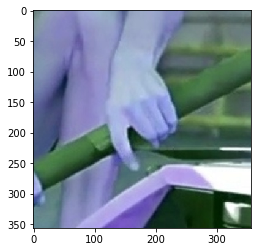

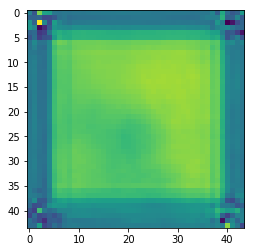

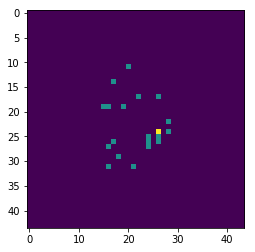

heatmap cost
Heat_loss :  20.27003
vectormap cost
Vector_loss :  141.15654




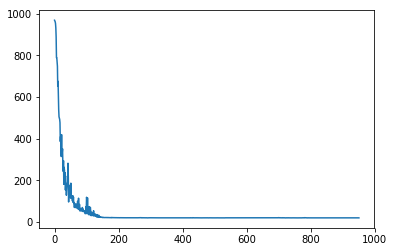

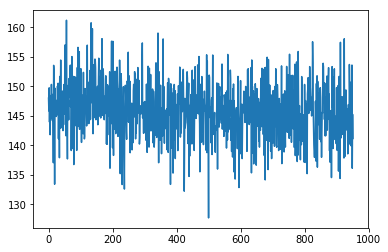

epoch 9 start


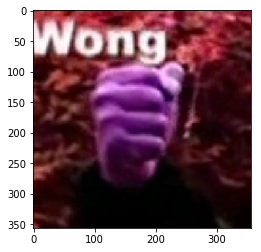

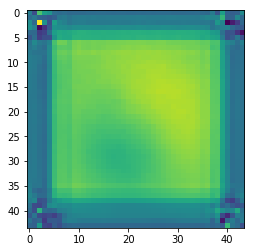

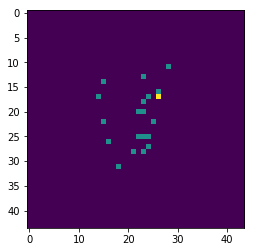

heatmap cost
Heat_loss :  20.347218
vectormap cost
Vector_loss :  145.24976




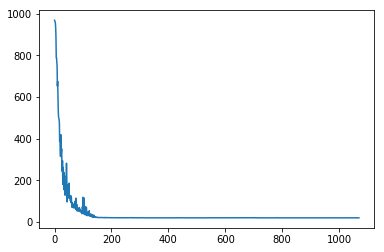

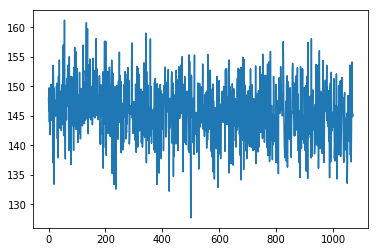

epoch 10 start


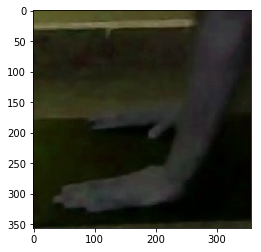

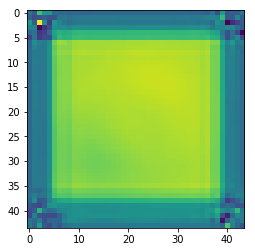

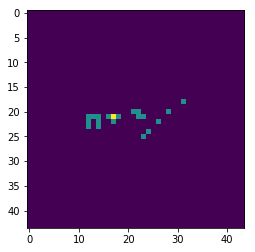

heatmap cost
Heat_loss :  20.383629
vectormap cost
Vector_loss :  147.38283




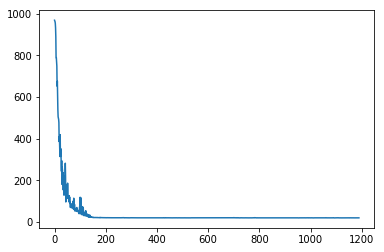

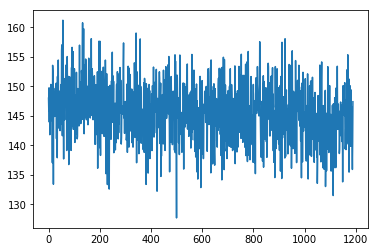

epoch 11 start


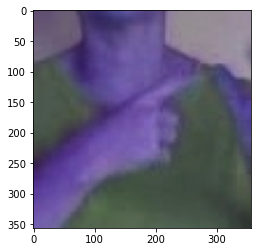

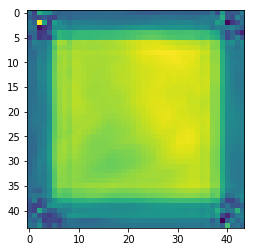

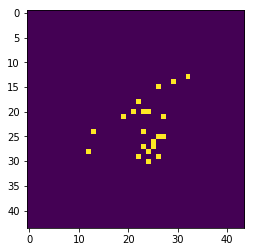

heatmap cost
Heat_loss :  20.277107
vectormap cost
Vector_loss :  142.66524




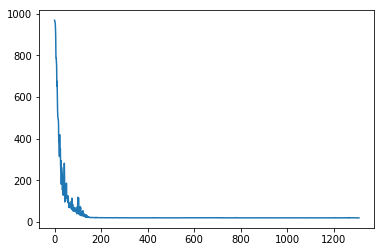

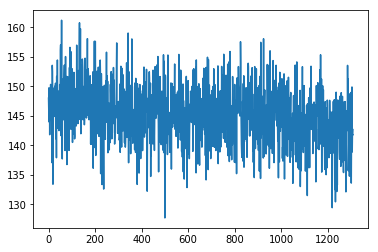

epoch 12 start


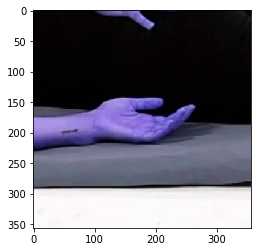

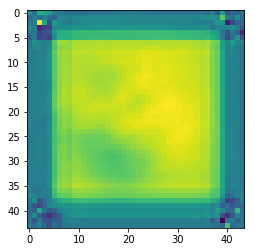

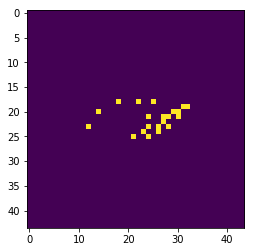

heatmap cost
Heat_loss :  20.256828
vectormap cost
Vector_loss :  134.84302




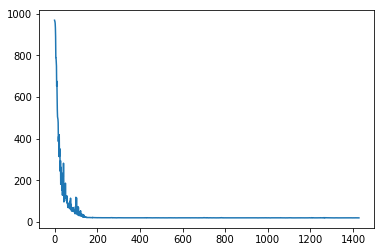

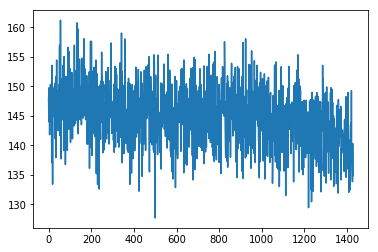

epoch 13 start


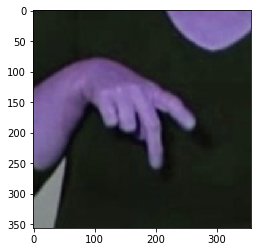

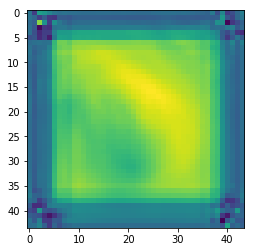

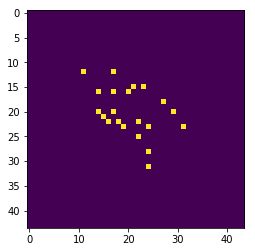

heatmap cost
Heat_loss :  20.308714
vectormap cost
Vector_loss :  138.67696




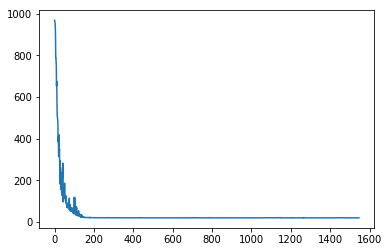

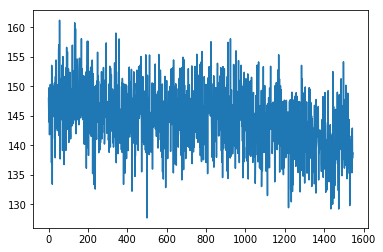

epoch 14 start


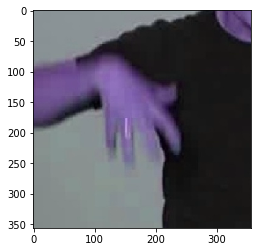

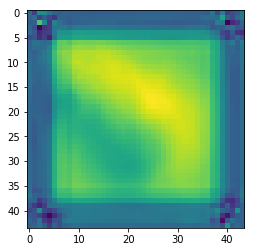

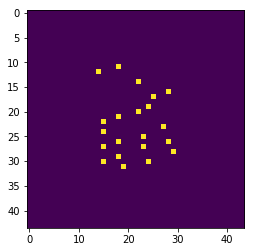

heatmap cost
Heat_loss :  20.300539
vectormap cost
Vector_loss :  133.87753




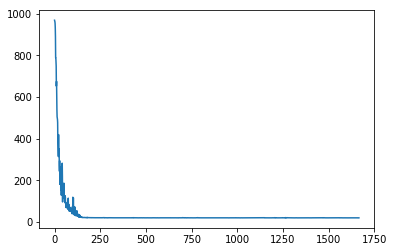

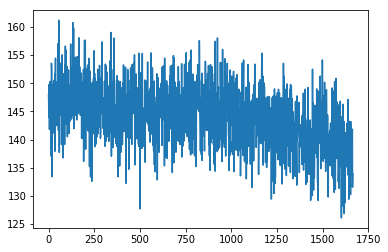

epoch 15 start


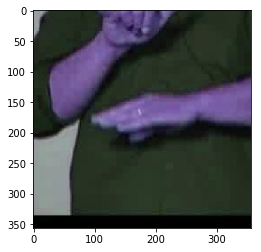

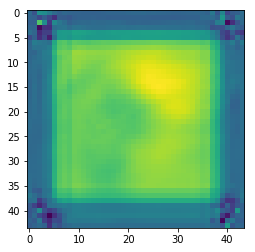

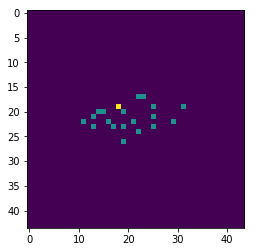

heatmap cost
Heat_loss :  20.284916
vectormap cost
Vector_loss :  141.59311




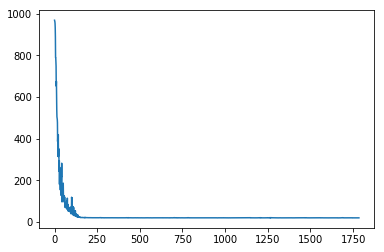

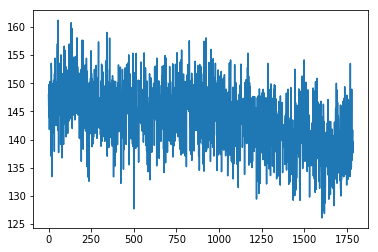

epoch 16 start


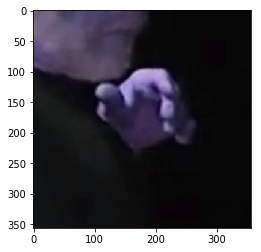

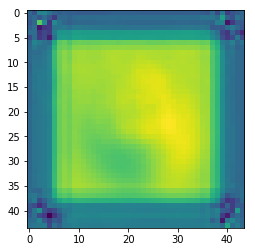

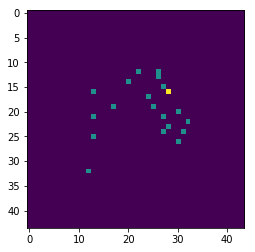

heatmap cost
Heat_loss :  20.226076
vectormap cost
Vector_loss :  138.50305




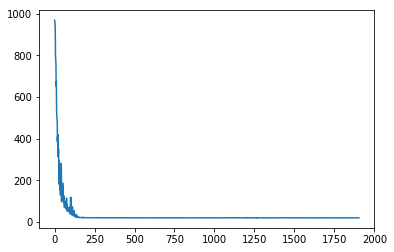

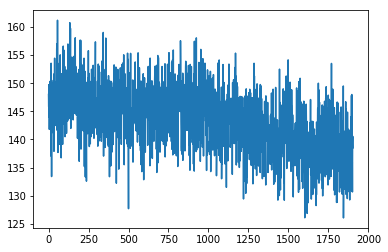

epoch 17 start


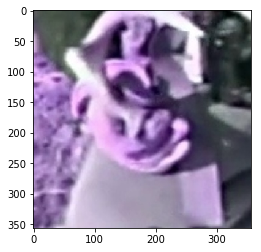

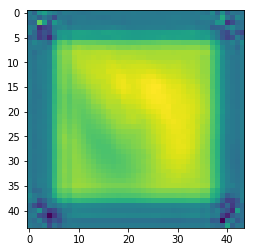

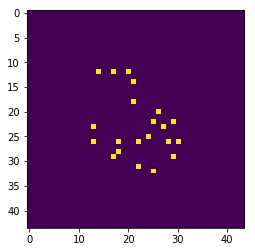

heatmap cost
Heat_loss :  20.415945
vectormap cost
Vector_loss :  139.82175




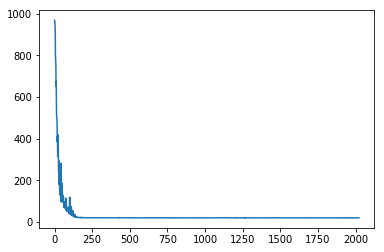

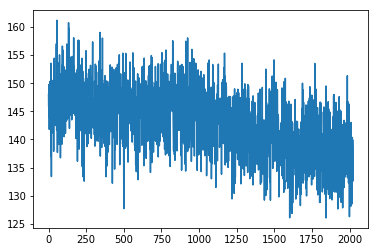

epoch 18 start


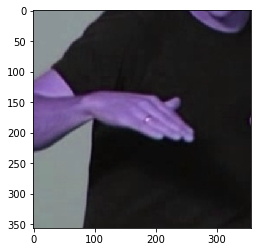

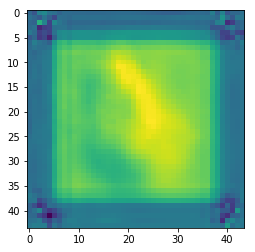

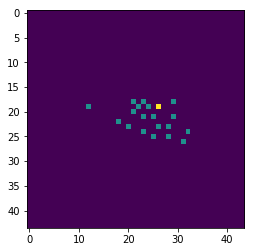

heatmap cost
Heat_loss :  20.238235
vectormap cost
Vector_loss :  126.67778




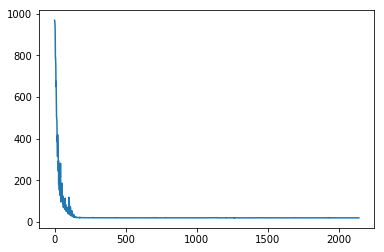

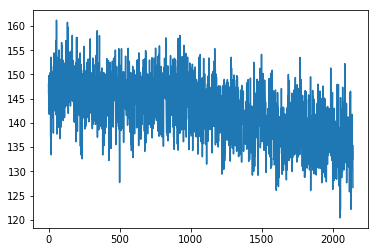

epoch 19 start


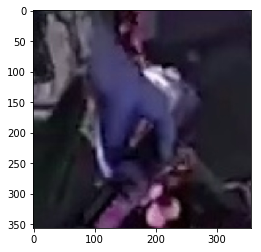

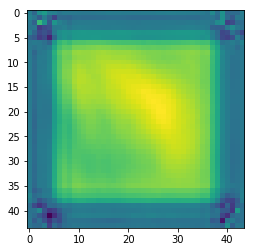

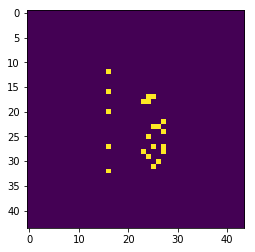

heatmap cost
Heat_loss :  20.293278
vectormap cost
Vector_loss :  124.025986




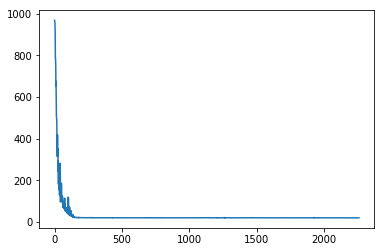

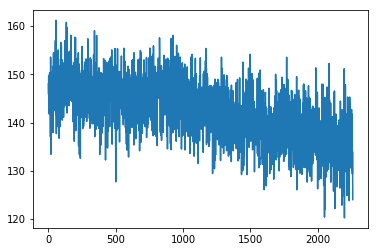

epoch 20 start


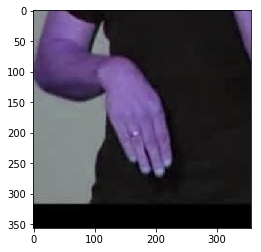

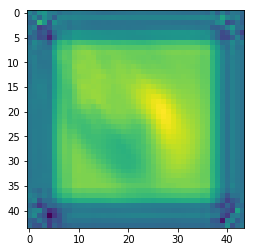

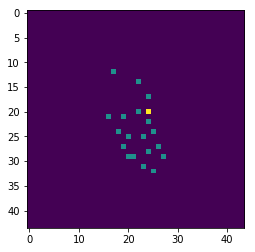

heatmap cost
Heat_loss :  20.434713
vectormap cost
Vector_loss :  130.24619




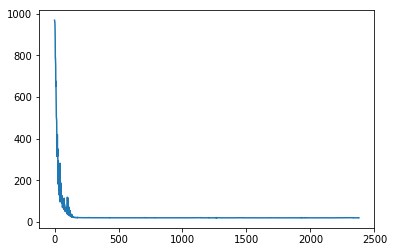

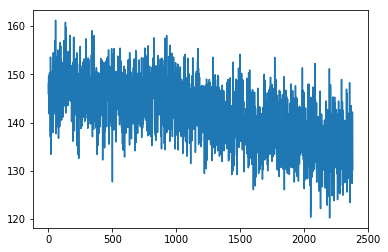

epoch 21 start


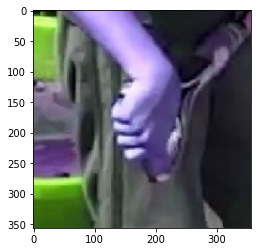

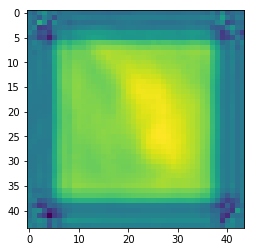

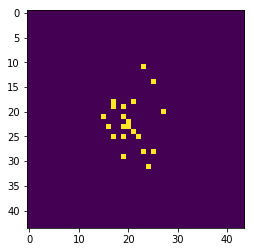

heatmap cost
Heat_loss :  20.411701
vectormap cost
Vector_loss :  133.41344




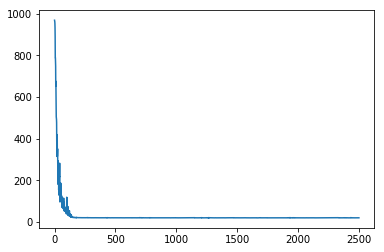

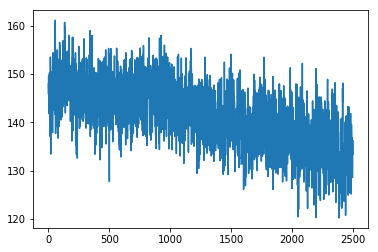

epoch 22 start


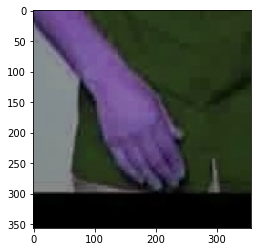

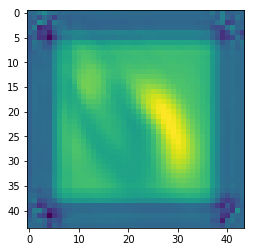

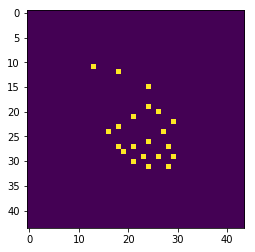

heatmap cost
Heat_loss :  20.06131
vectormap cost
Vector_loss :  127.003586




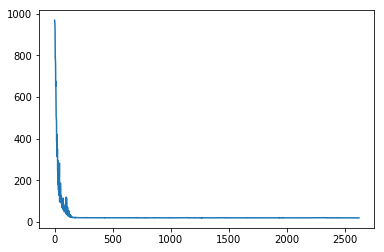

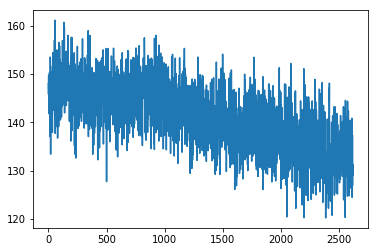

epoch 23 start


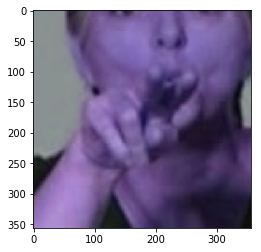

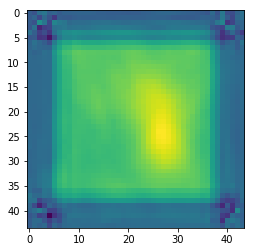

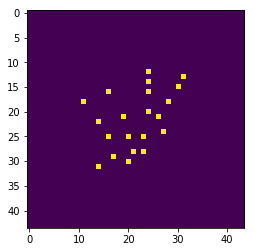

heatmap cost
Heat_loss :  20.195442
vectormap cost
Vector_loss :  132.63467




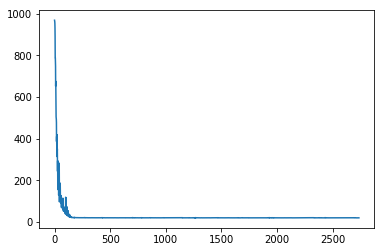

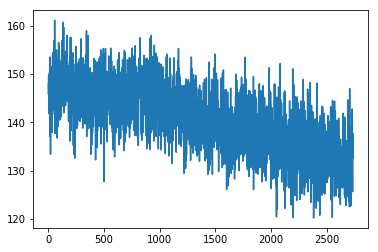

epoch 24 start


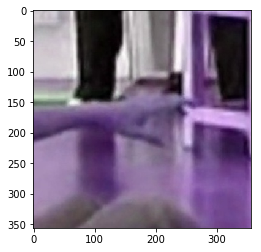

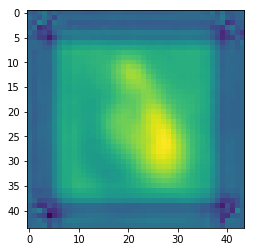

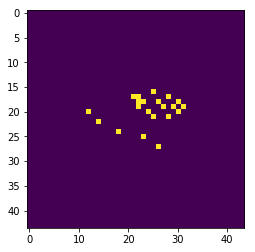

heatmap cost
Heat_loss :  20.239193
vectormap cost
Vector_loss :  133.32979




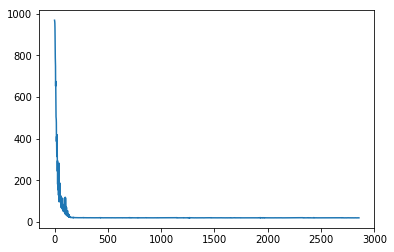

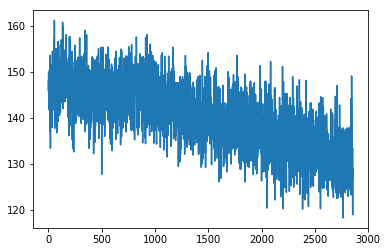

epoch 25 start


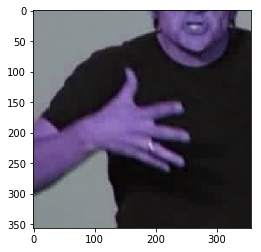

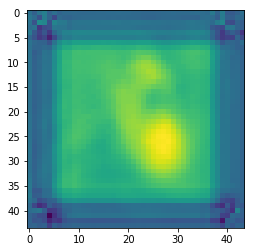

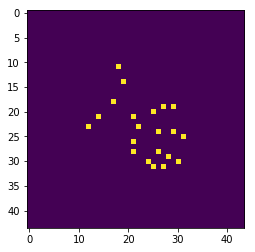

heatmap cost
Heat_loss :  21.005045
vectormap cost
Vector_loss :  129.08163




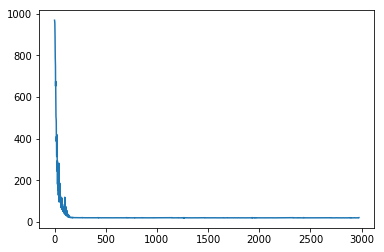

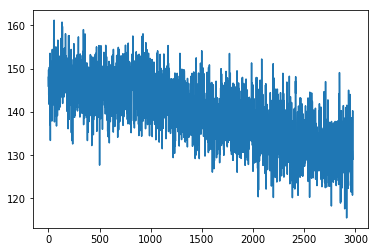

epoch 26 start


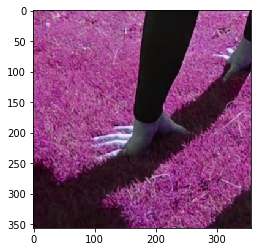

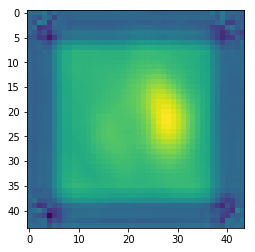

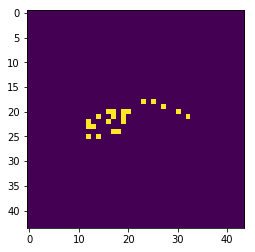

heatmap cost
Heat_loss :  20.256916
vectormap cost
Vector_loss :  128.23447




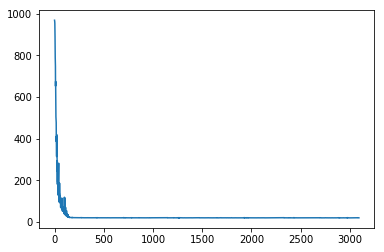

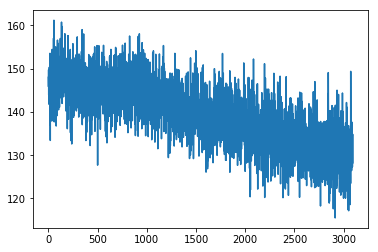

epoch 27 start


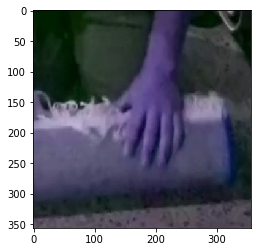

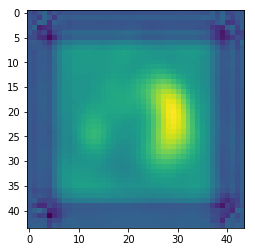

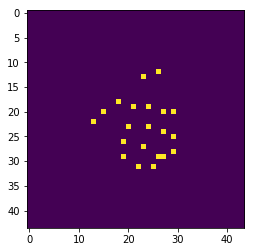

heatmap cost
Heat_loss :  20.500134
vectormap cost
Vector_loss :  127.20978




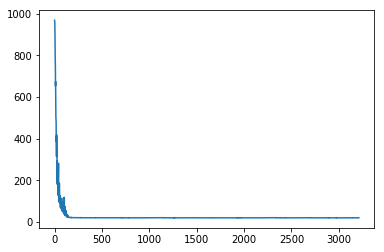

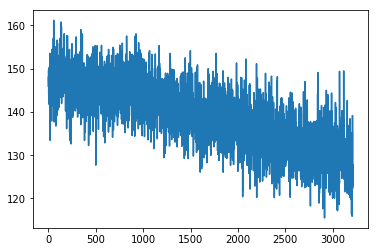

epoch 28 start


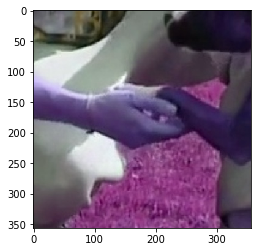

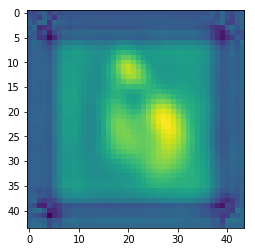

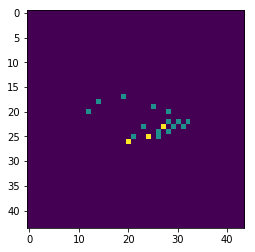

heatmap cost
Heat_loss :  19.986256
vectormap cost
Vector_loss :  131.57637




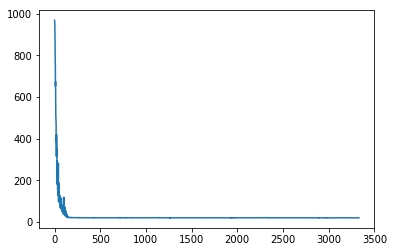

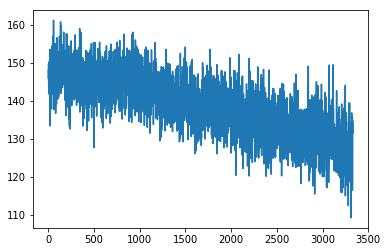

epoch 29 start


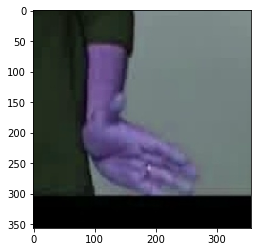

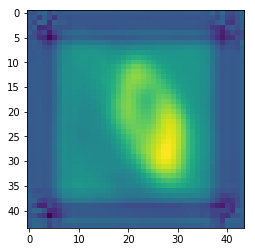

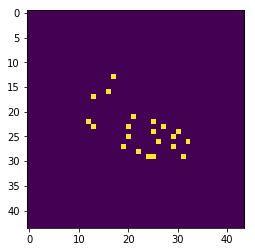

heatmap cost
Heat_loss :  20.3112
vectormap cost
Vector_loss :  134.75832




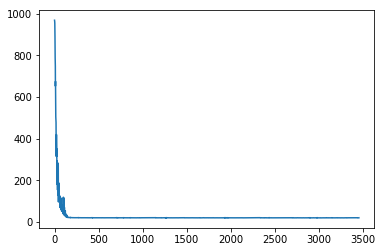

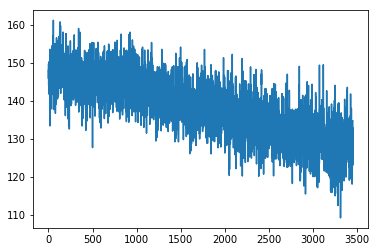

epoch 30 start


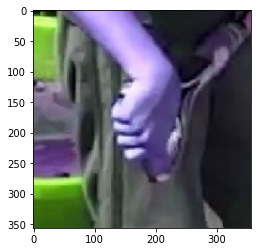

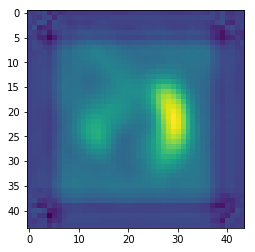

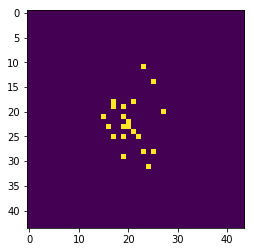

heatmap cost
Heat_loss :  20.23832
vectormap cost
Vector_loss :  131.82204




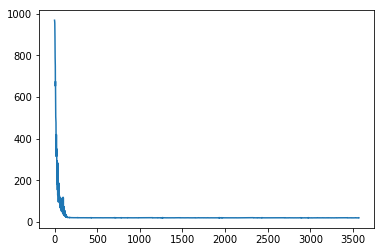

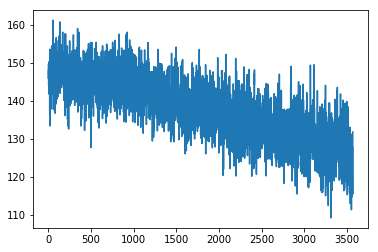

epoch 31 start


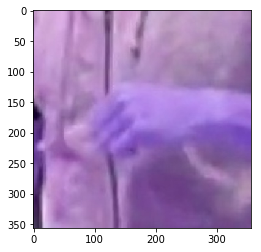

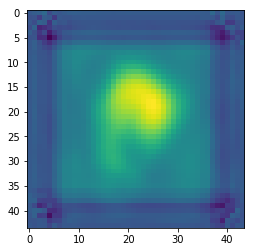

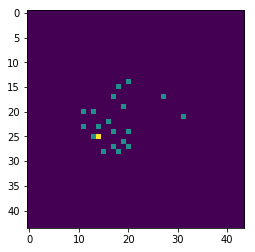

heatmap cost
Heat_loss :  20.442036
vectormap cost
Vector_loss :  124.96634




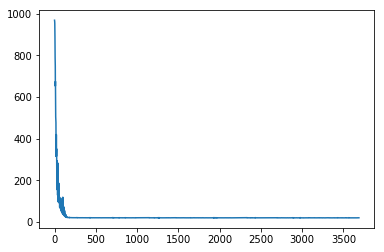

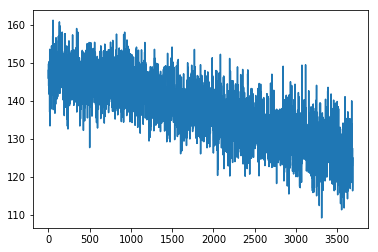

epoch 32 start


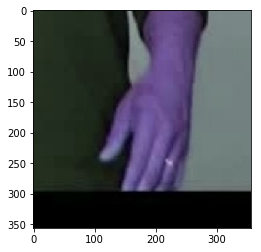

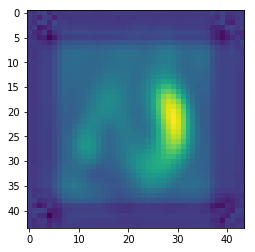

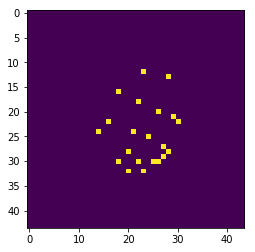

heatmap cost
Heat_loss :  20.236515
vectormap cost
Vector_loss :  123.470345




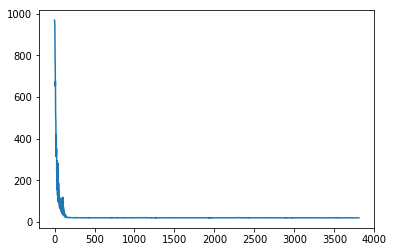

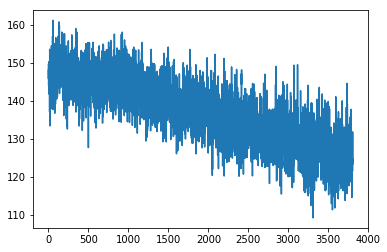

epoch 33 start


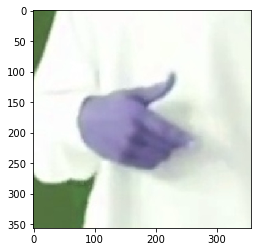

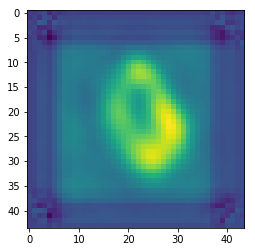

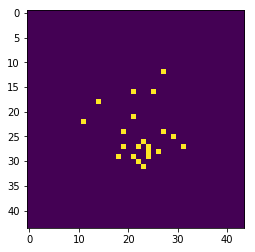

heatmap cost
Heat_loss :  20.13073
vectormap cost
Vector_loss :  120.34854




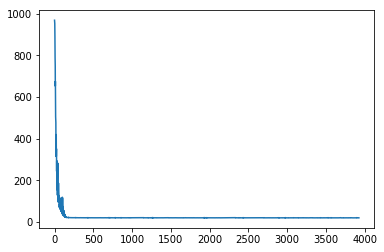

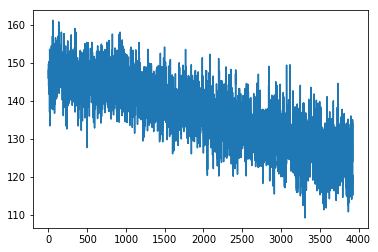

epoch 34 start


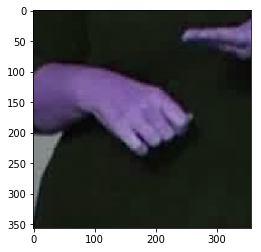

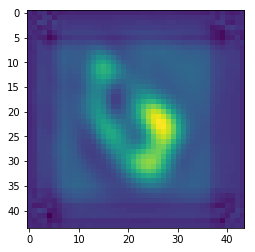

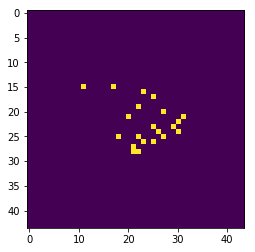

heatmap cost
Heat_loss :  20.08284
vectormap cost
Vector_loss :  130.7554




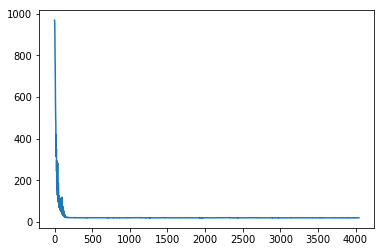

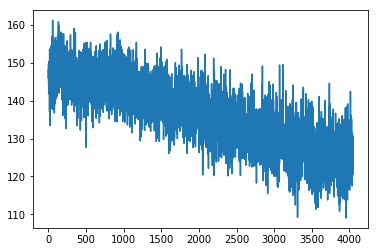

epoch 35 start


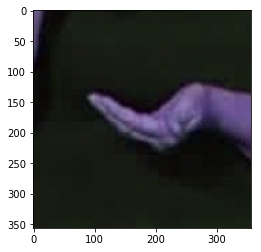

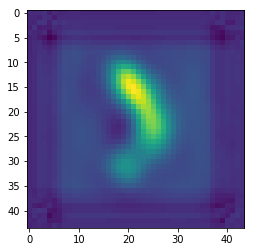

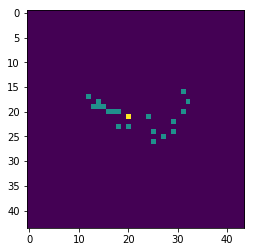

heatmap cost
Heat_loss :  20.183325
vectormap cost
Vector_loss :  116.712746




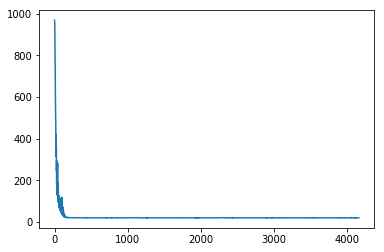

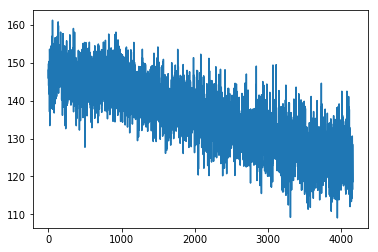

epoch 36 start


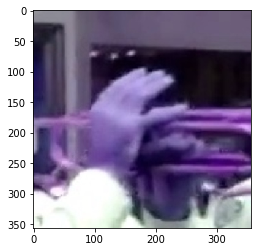

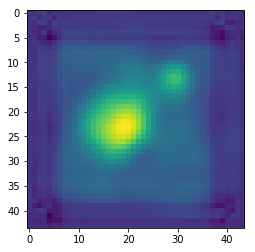

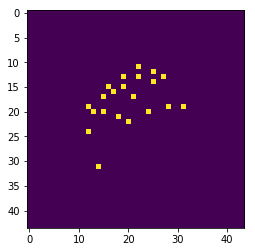

heatmap cost
Heat_loss :  20.06008
vectormap cost
Vector_loss :  112.90051




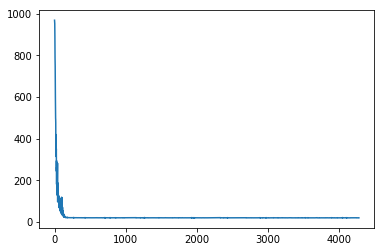

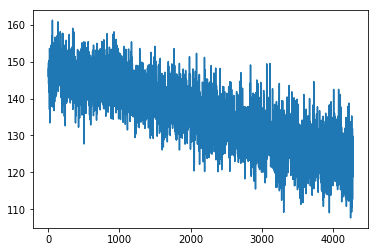

epoch 37 start


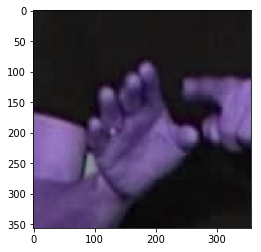

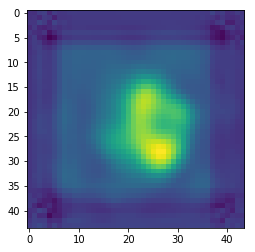

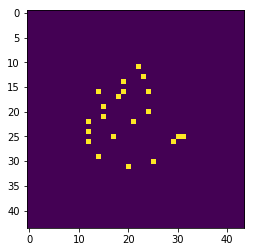

heatmap cost
Heat_loss :  20.20268
vectormap cost
Vector_loss :  126.39916




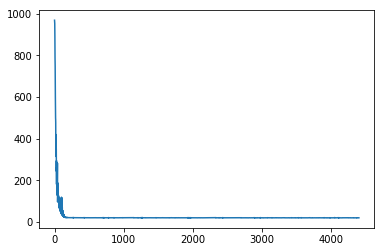

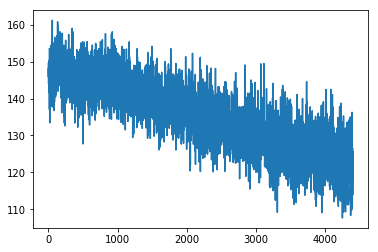

epoch 38 start


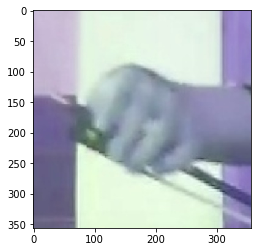

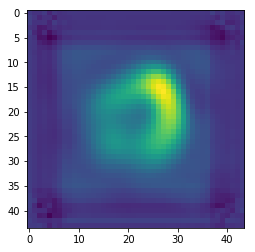

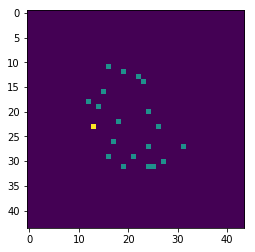

heatmap cost
Heat_loss :  20.062859
vectormap cost
Vector_loss :  119.49372




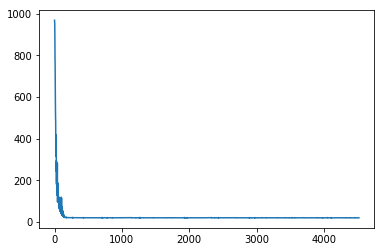

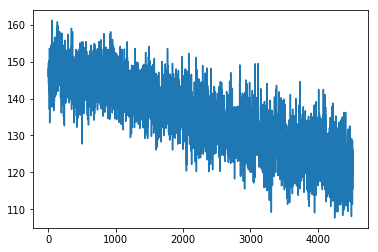

epoch 39 start


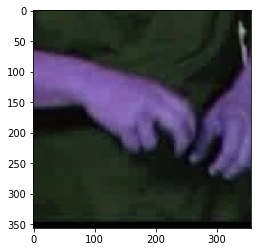

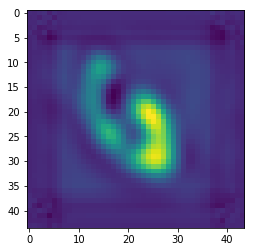

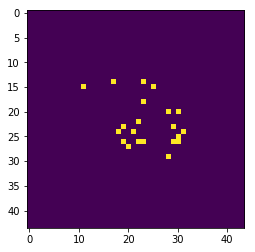

heatmap cost
Heat_loss :  20.215933
vectormap cost
Vector_loss :  113.03299




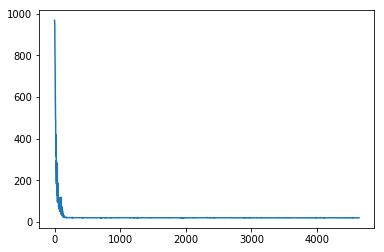

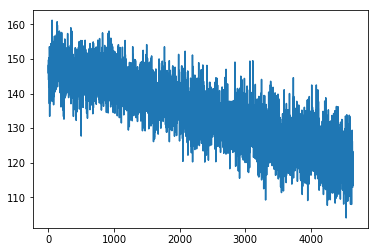

epoch 40 start


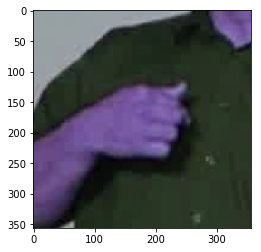

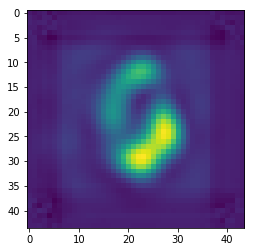

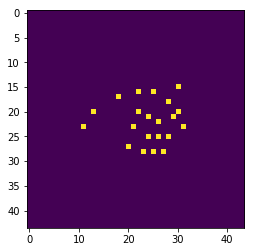

heatmap cost
Heat_loss :  20.2574
vectormap cost
Vector_loss :  115.58397




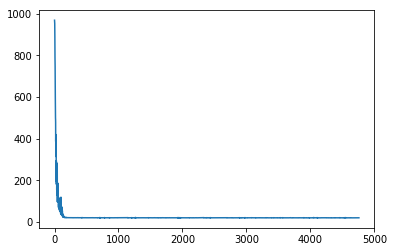

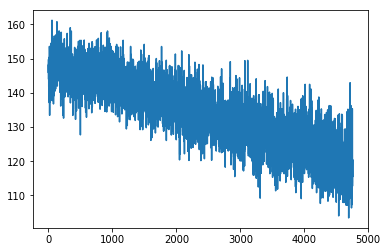

epoch 41 start


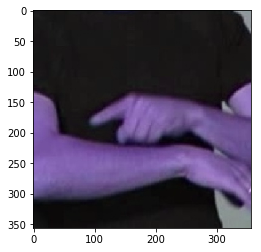

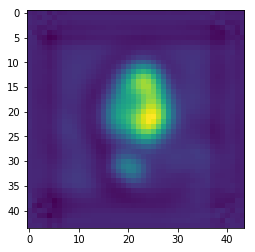

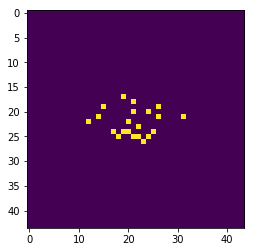

heatmap cost
Heat_loss :  20.057693
vectormap cost
Vector_loss :  112.652245




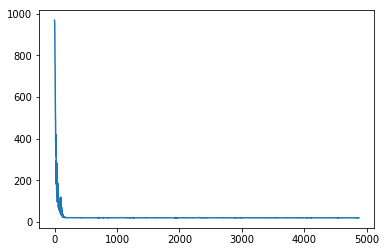

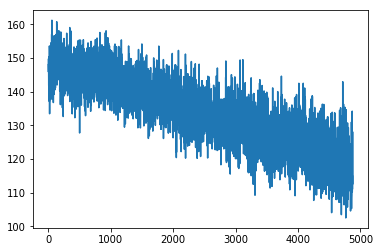

epoch 42 start


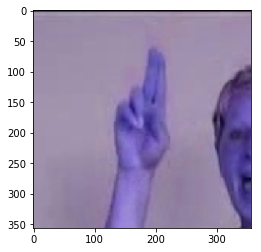

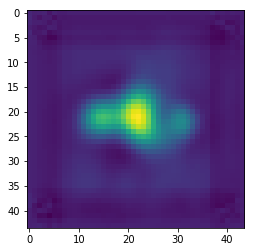

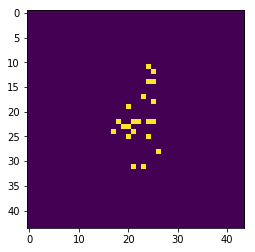

heatmap cost
Heat_loss :  20.071732
vectormap cost
Vector_loss :  114.98206




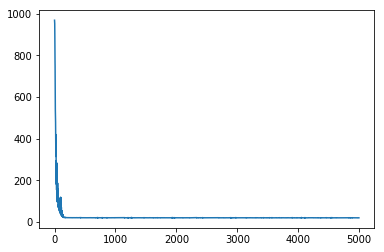

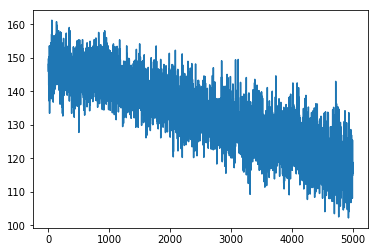

epoch 43 start


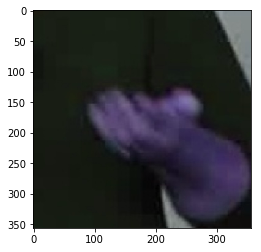

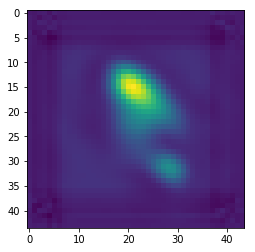

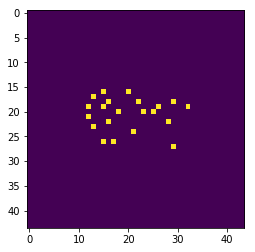

heatmap cost
Heat_loss :  20.516216
vectormap cost
Vector_loss :  115.03243




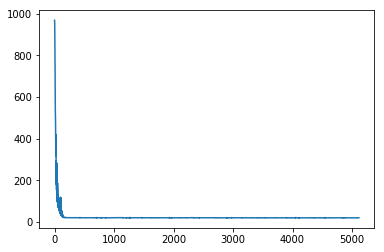

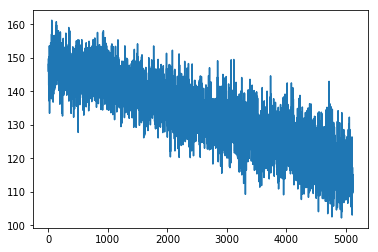

epoch 44 start


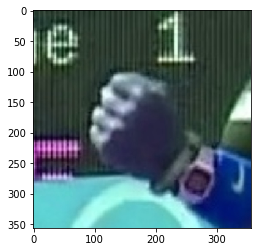

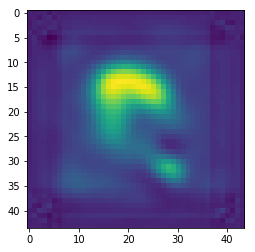

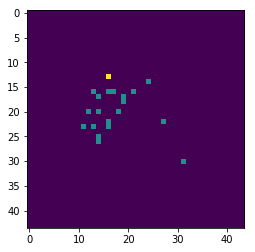

heatmap cost
Heat_loss :  20.382185
vectormap cost
Vector_loss :  116.0412




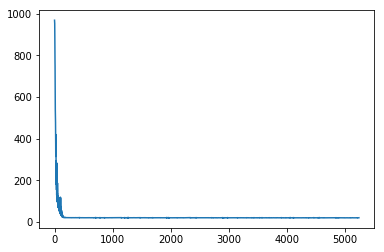

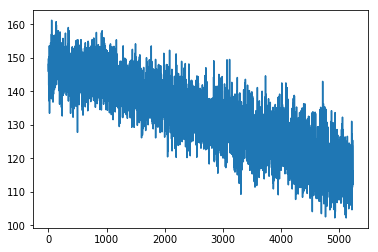

epoch 45 start


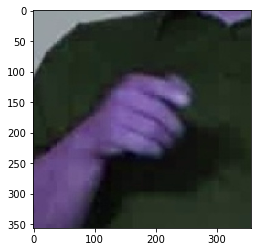

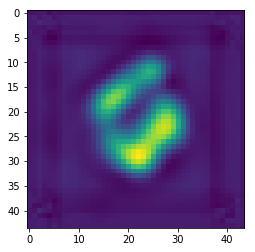

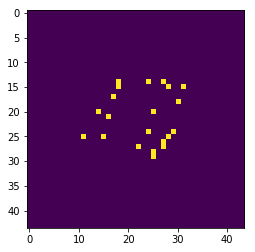

heatmap cost
Heat_loss :  20.693478
vectormap cost
Vector_loss :  112.31293




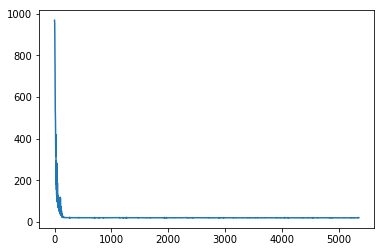

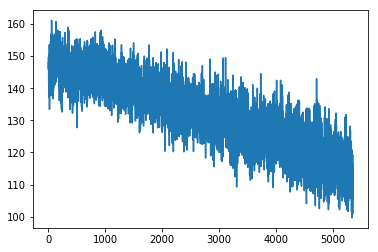

epoch 46 start


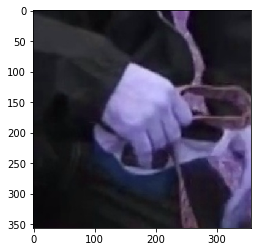

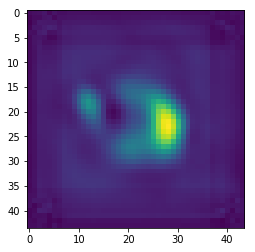

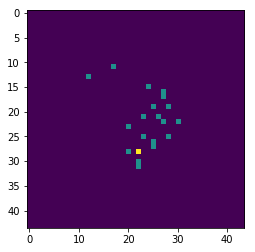

heatmap cost
Heat_loss :  20.232592
vectormap cost
Vector_loss :  106.12659




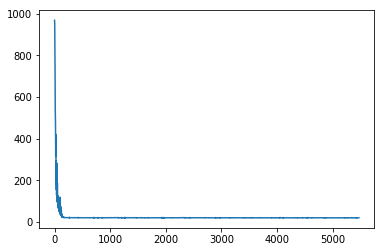

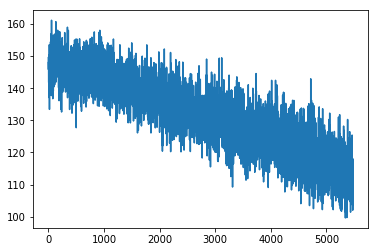

epoch 47 start


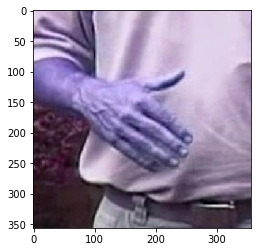

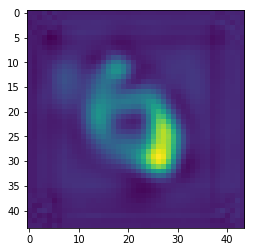

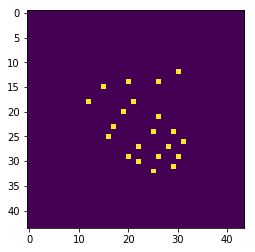

heatmap cost
Heat_loss :  20.027493
vectormap cost
Vector_loss :  111.01134




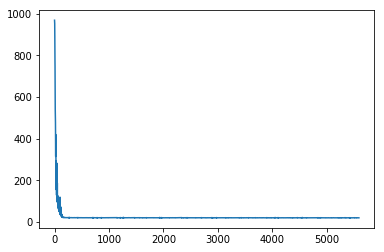

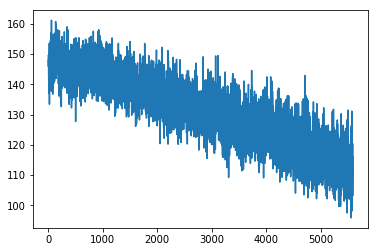

epoch 48 start


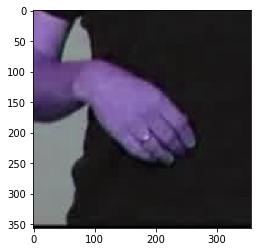

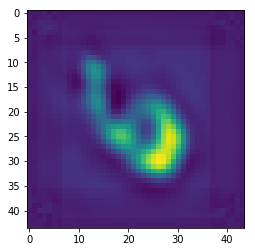

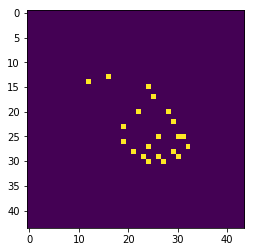

heatmap cost
Heat_loss :  20.079975
vectormap cost
Vector_loss :  115.902176




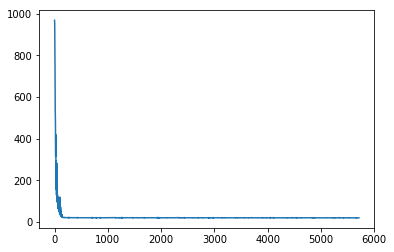

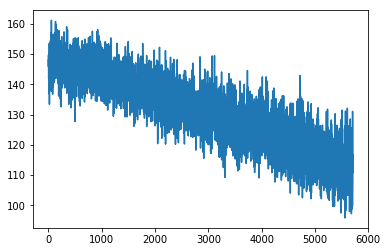

epoch 49 start


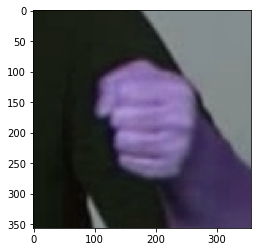

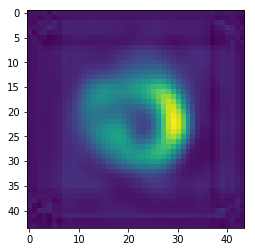

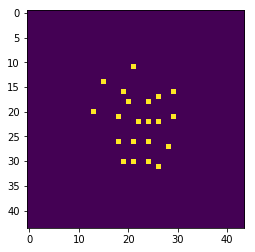

heatmap cost
Heat_loss :  19.901815
vectormap cost
Vector_loss :  105.88446




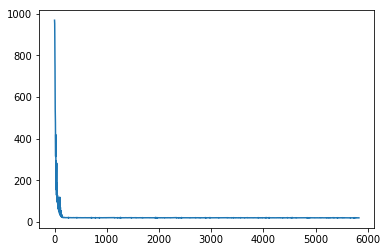

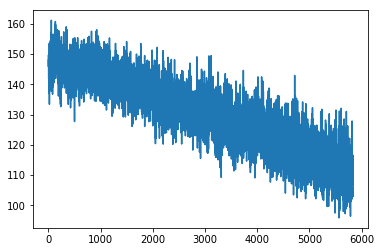

epoch 50 start


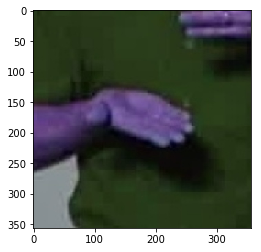

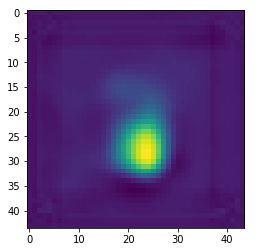

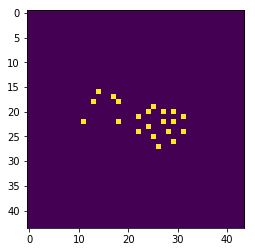

heatmap cost
Heat_loss :  20.18048
vectormap cost
Vector_loss :  111.423965




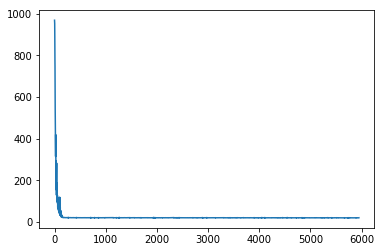

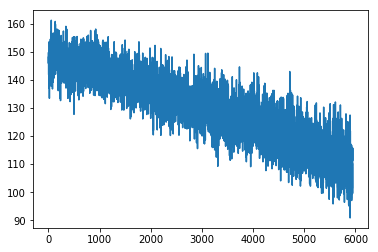

epoch 51 start


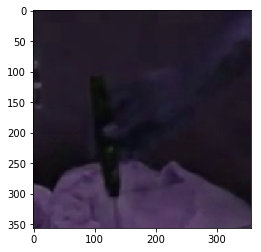

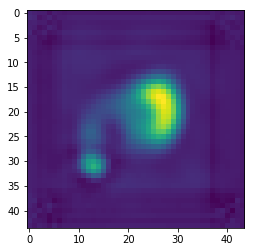

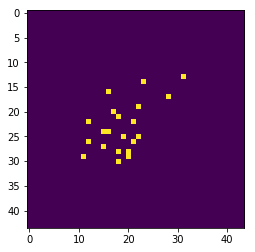

heatmap cost
Heat_loss :  19.87402
vectormap cost
Vector_loss :  105.818054




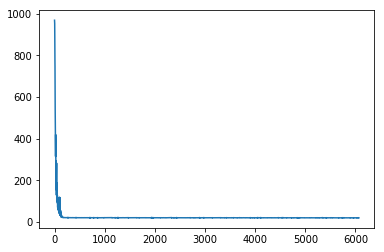

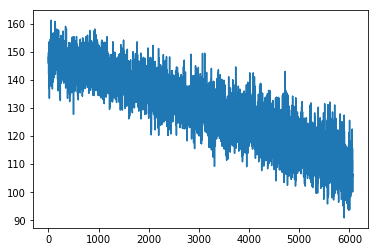

epoch 52 start


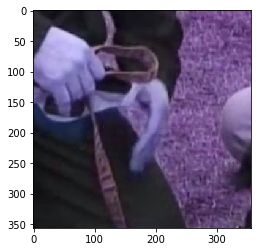

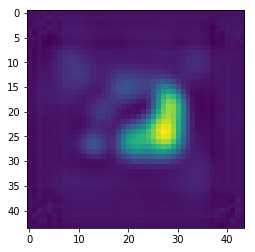

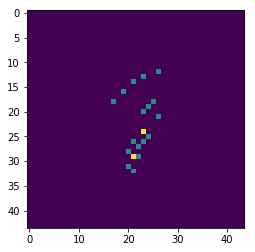

heatmap cost
Heat_loss :  19.784004
vectormap cost
Vector_loss :  101.04783




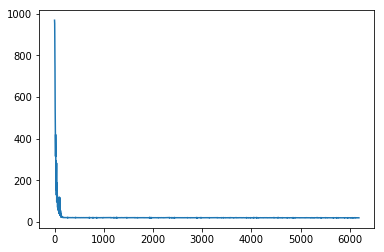

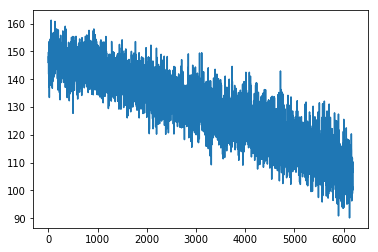

epoch 53 start


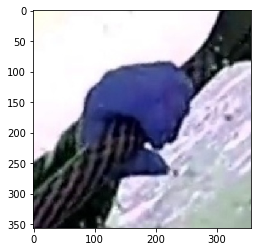

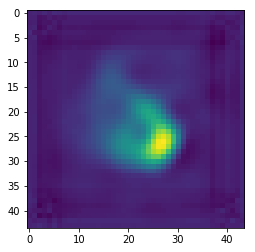

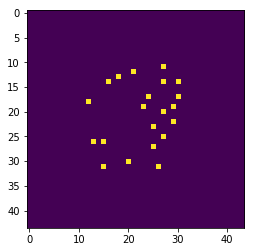

heatmap cost
Heat_loss :  19.775097
vectormap cost
Vector_loss :  113.57559




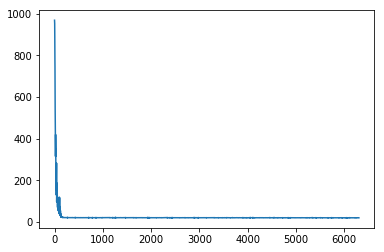

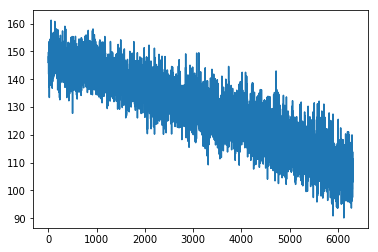

epoch 54 start


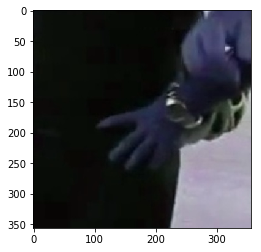

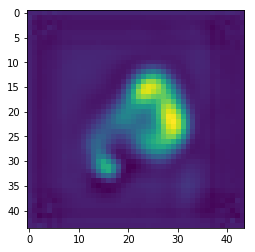

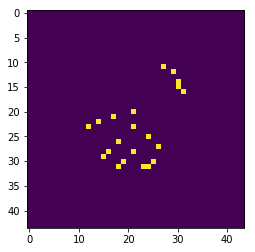

heatmap cost
Heat_loss :  19.67775
vectormap cost
Vector_loss :  105.462814




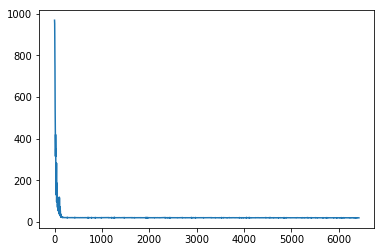

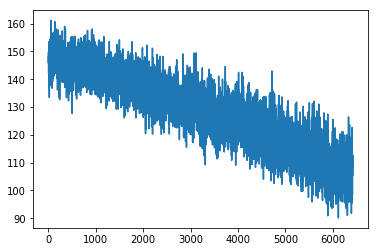

epoch 55 start


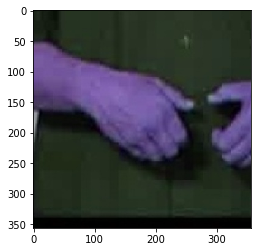

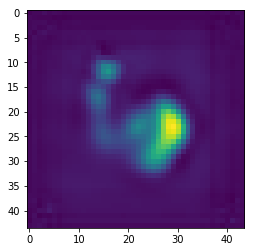

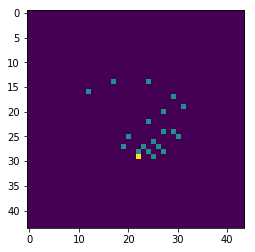

heatmap cost
Heat_loss :  19.930748
vectormap cost
Vector_loss :  98.376854




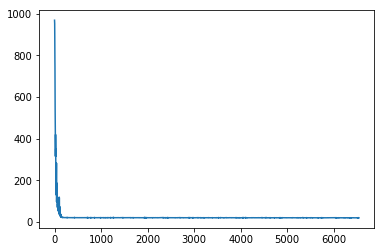

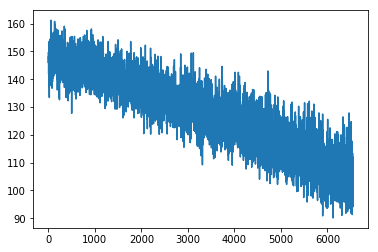

epoch 56 start


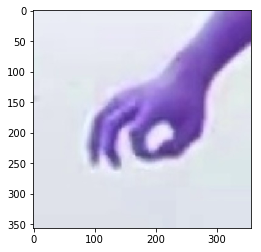

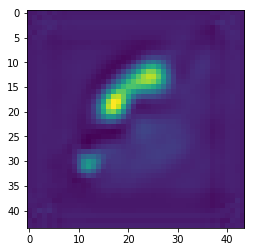

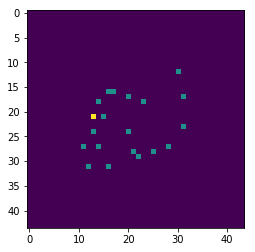

heatmap cost
Heat_loss :  19.765482
vectormap cost
Vector_loss :  86.38844




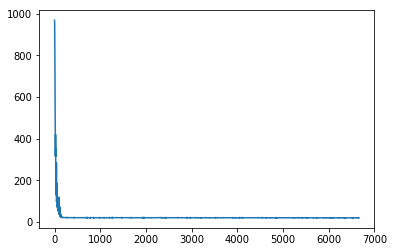

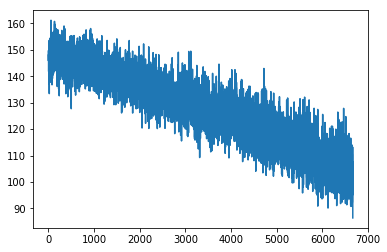

epoch 57 start


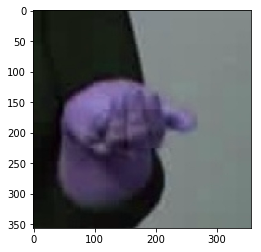

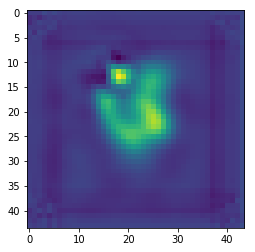

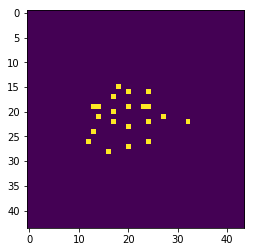

heatmap cost
Heat_loss :  19.658127
vectormap cost
Vector_loss :  97.838776




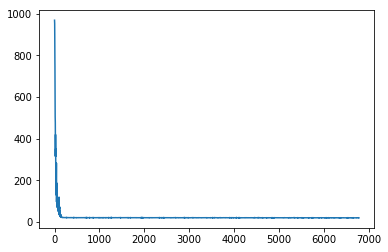

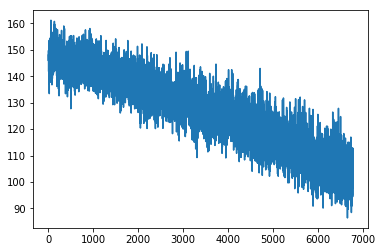

epoch 58 start


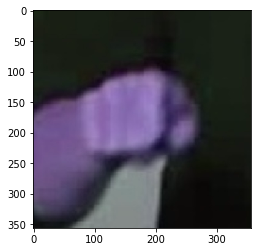

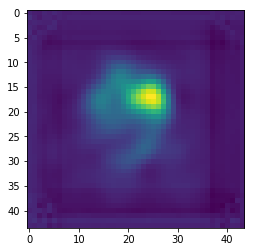

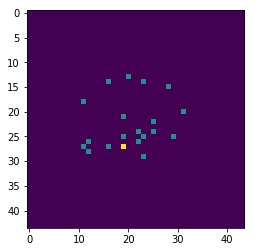

heatmap cost
Heat_loss :  19.76505
vectormap cost
Vector_loss :  112.92407




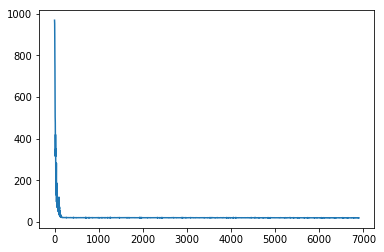

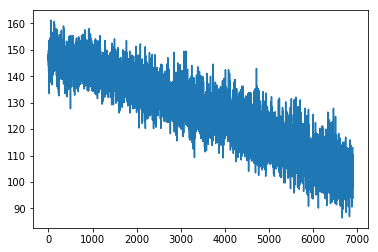

epoch 59 start


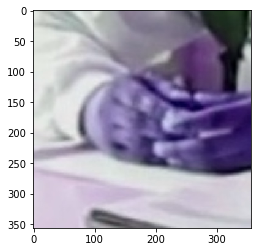

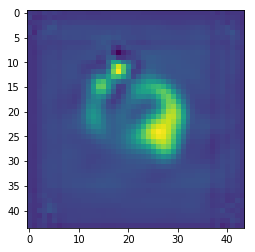

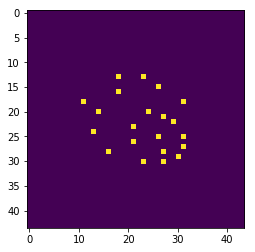

heatmap cost
Heat_loss :  19.649101
vectormap cost
Vector_loss :  92.73111




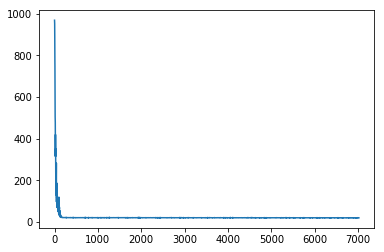

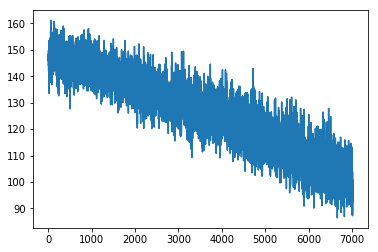

epoch 60 start


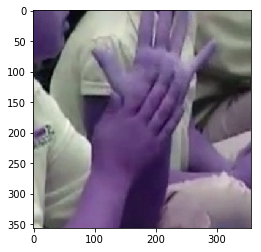

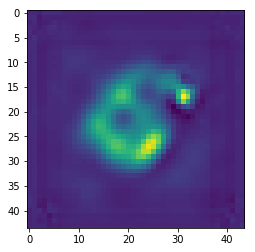

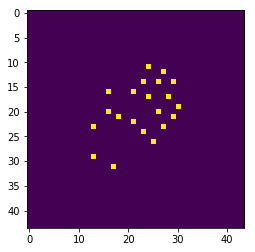

heatmap cost
Heat_loss :  19.558813
vectormap cost
Vector_loss :  91.22858




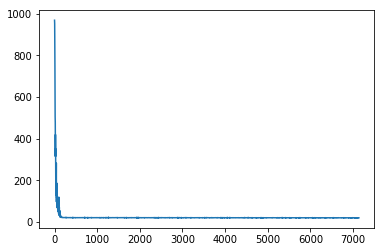

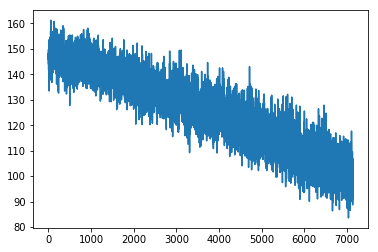

epoch 61 start


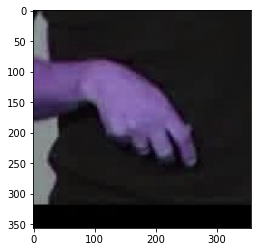

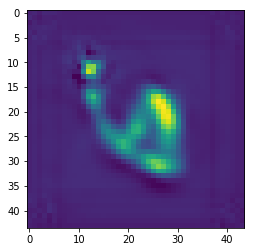

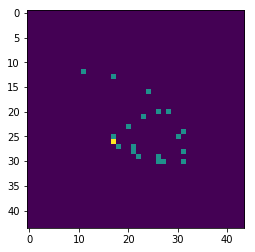

heatmap cost
Heat_loss :  19.73463
vectormap cost
Vector_loss :  100.45173




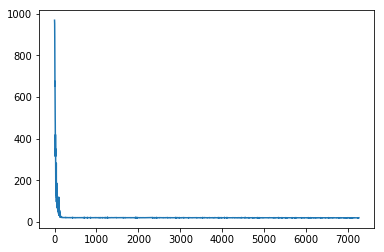

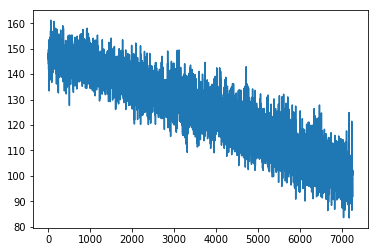

epoch 62 start


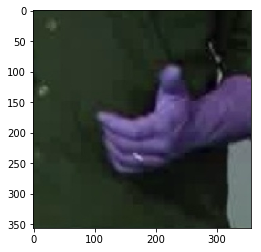

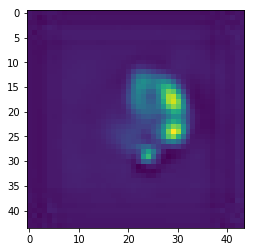

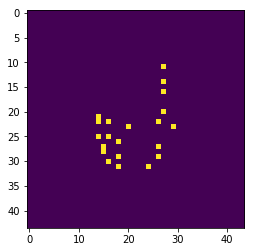

heatmap cost
Heat_loss :  19.704653
vectormap cost
Vector_loss :  92.50402




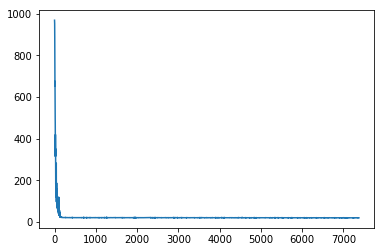

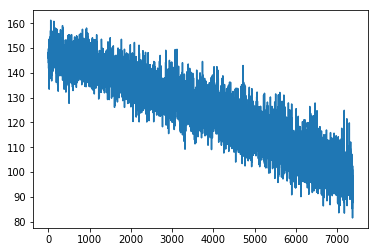

epoch 63 start


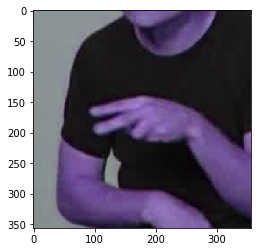

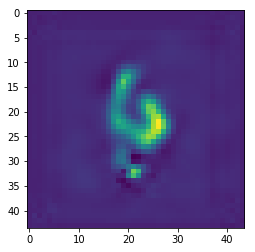

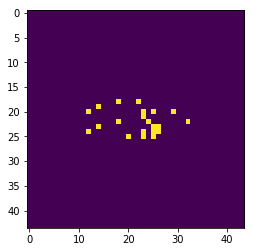

heatmap cost
Heat_loss :  19.353346
vectormap cost
Vector_loss :  95.5889




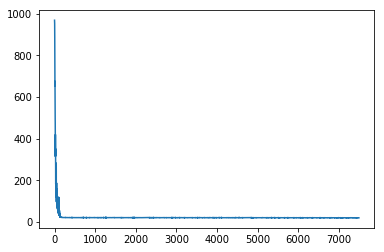

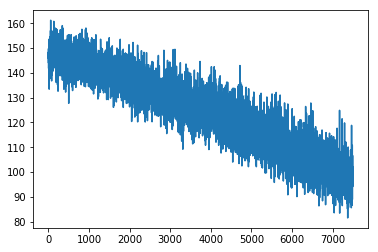

epoch 64 start


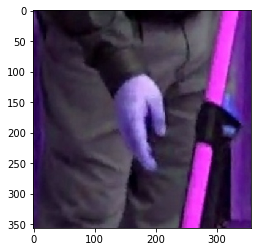

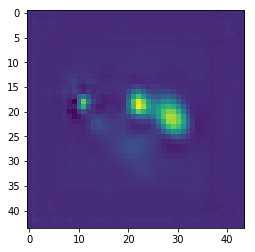

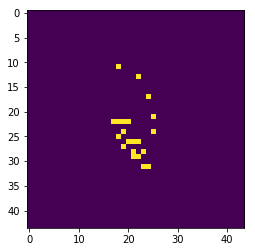

heatmap cost
Heat_loss :  19.385199
vectormap cost
Vector_loss :  94.2169




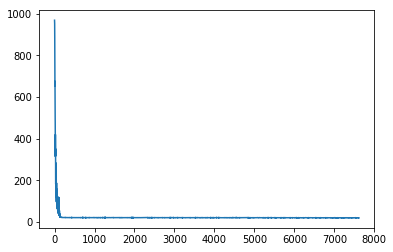

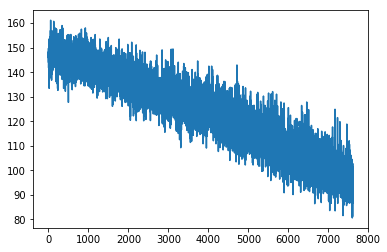

epoch 65 start


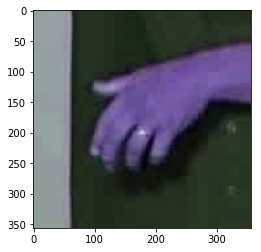

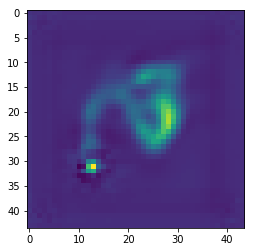

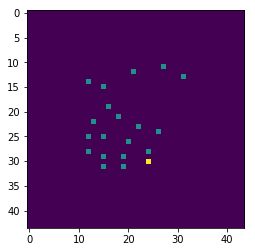

heatmap cost
Heat_loss :  19.795654
vectormap cost
Vector_loss :  92.48807




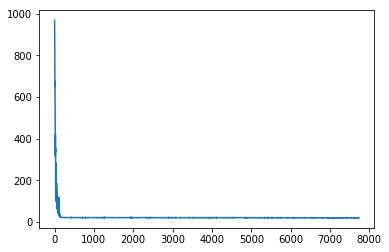

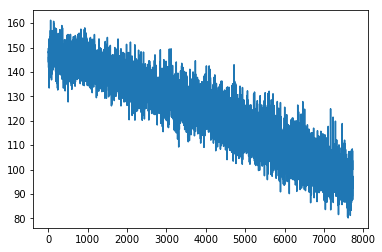

epoch 66 start


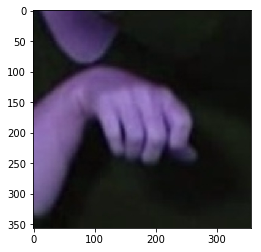

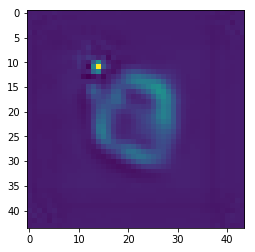

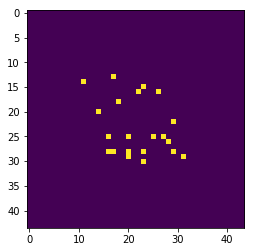

heatmap cost
Heat_loss :  19.39149
vectormap cost
Vector_loss :  88.305435




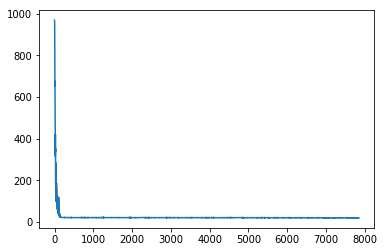

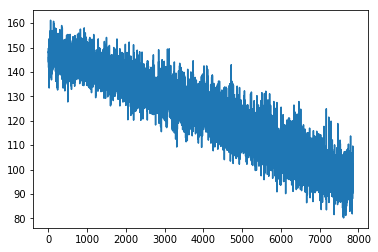

epoch 67 start


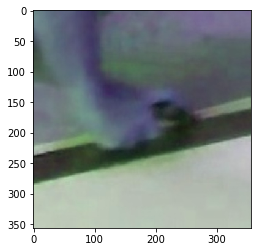

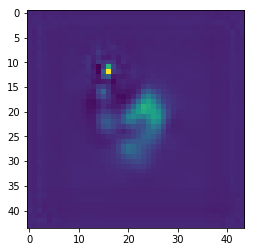

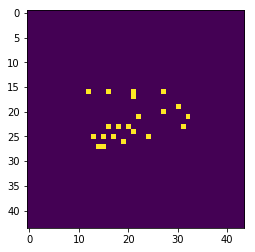

heatmap cost
Heat_loss :  19.823112
vectormap cost
Vector_loss :  81.50239




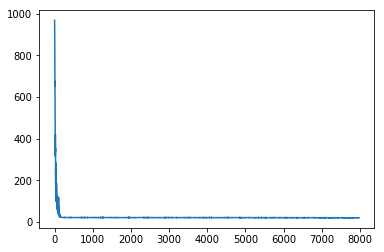

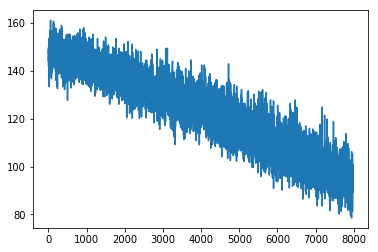

epoch 68 start


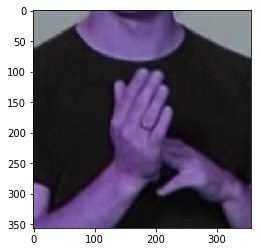

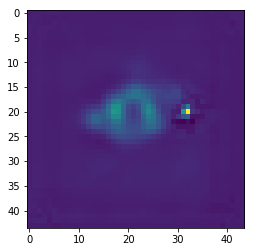

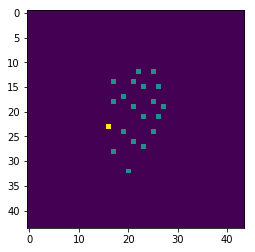

heatmap cost
Heat_loss :  19.352547
vectormap cost
Vector_loss :  91.07162




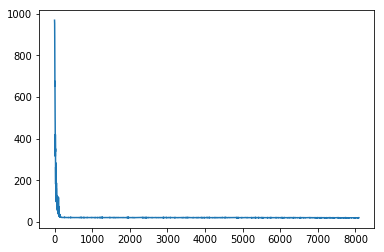

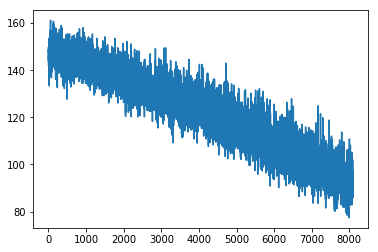

epoch 69 start


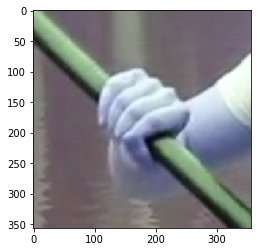

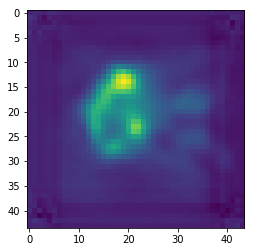

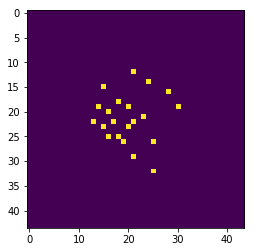

heatmap cost
Heat_loss :  19.798649
vectormap cost
Vector_loss :  106.76359




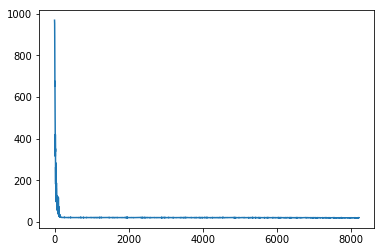

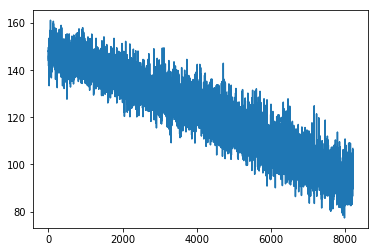

epoch 70 start


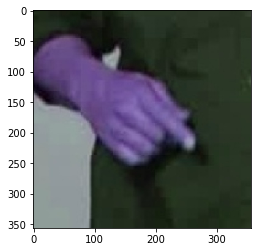

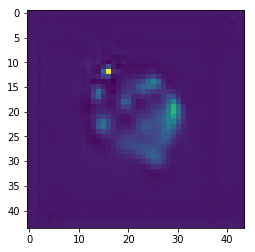

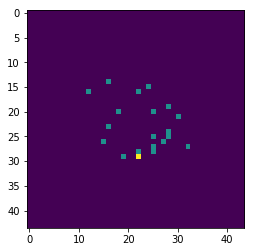

heatmap cost
Heat_loss :  18.970966
vectormap cost
Vector_loss :  85.62628




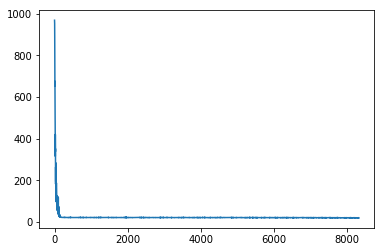

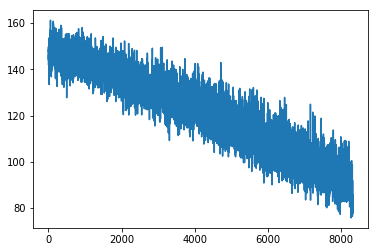

epoch 71 start


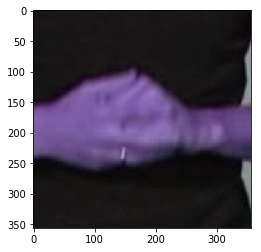

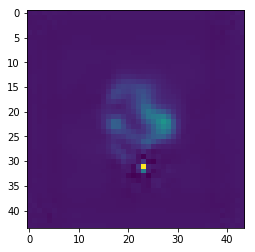

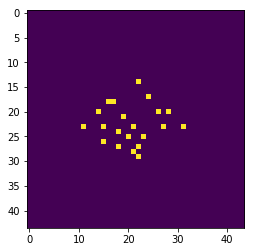

heatmap cost
Heat_loss :  19.635752
vectormap cost
Vector_loss :  96.219086




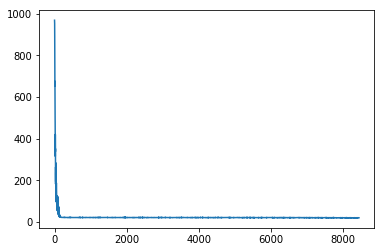

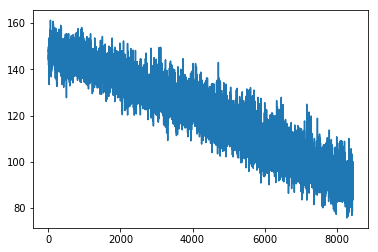

epoch 72 start


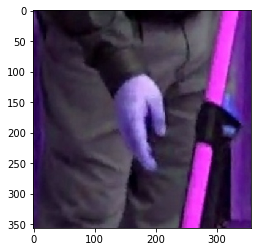

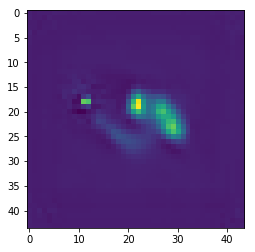

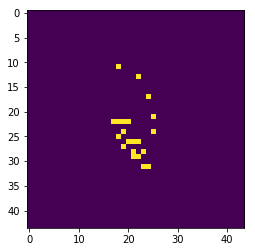

heatmap cost
Heat_loss :  19.204582
vectormap cost
Vector_loss :  95.81317




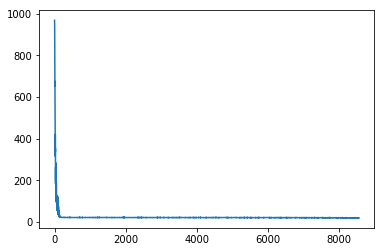

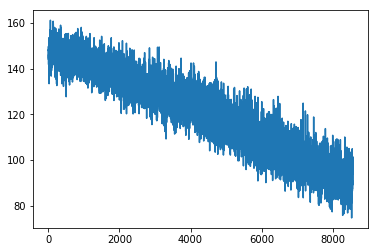

epoch 73 start


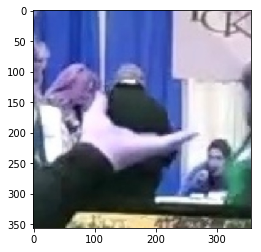

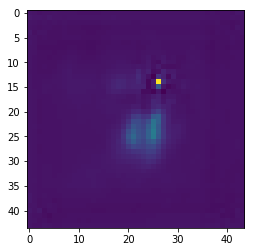

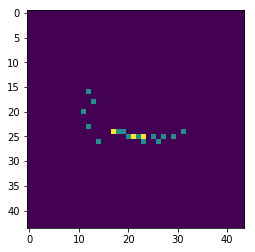

heatmap cost
Heat_loss :  19.432432
vectormap cost
Vector_loss :  93.95572




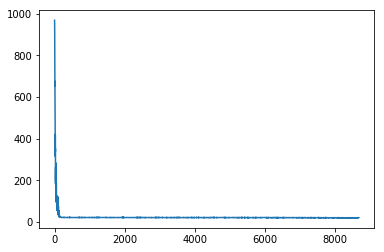

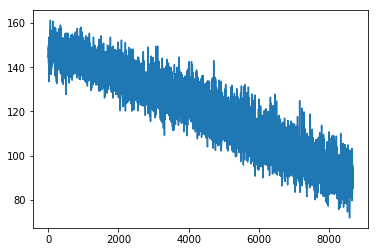

epoch 74 start


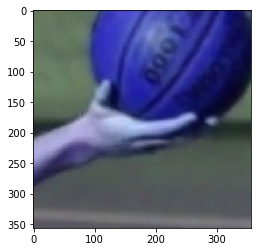

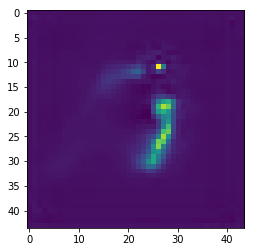

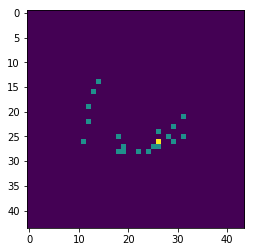

heatmap cost
Heat_loss :  19.199072
vectormap cost
Vector_loss :  83.66099




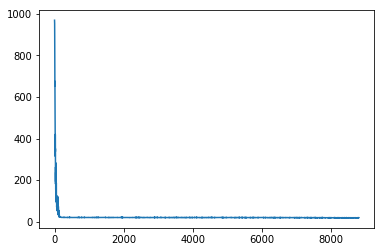

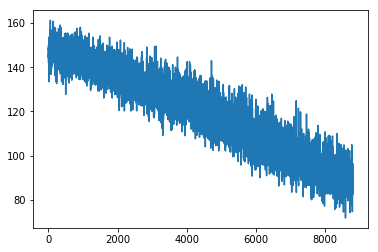

epoch 75 start


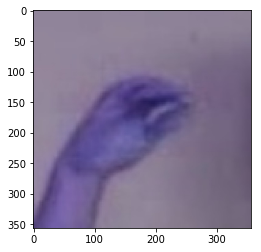

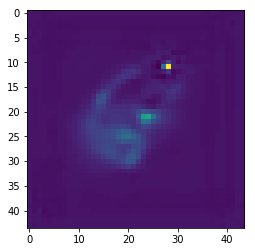

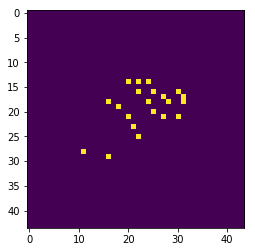

heatmap cost
Heat_loss :  18.827263
vectormap cost
Vector_loss :  89.7951




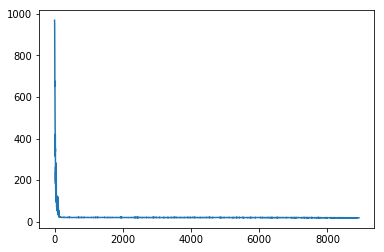

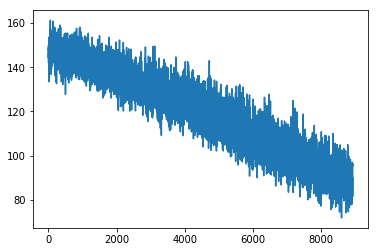

epoch 76 start


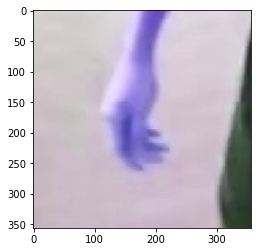

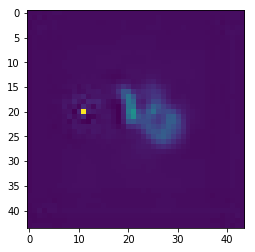

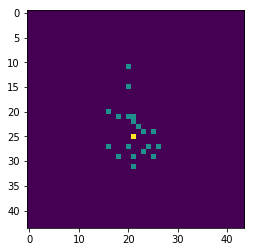

heatmap cost
Heat_loss :  18.686817
vectormap cost
Vector_loss :  76.999016




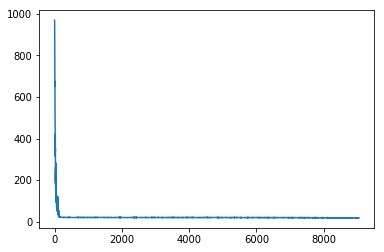

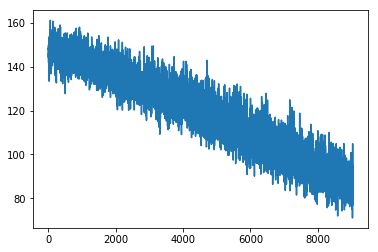

epoch 77 start


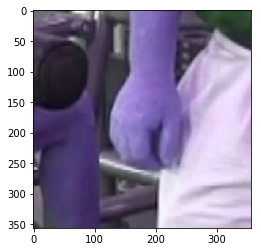

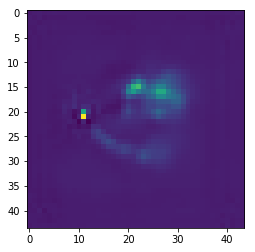

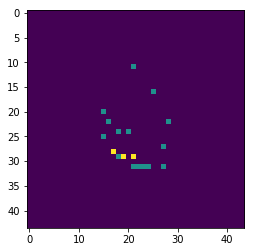

heatmap cost
Heat_loss :  18.673763
vectormap cost
Vector_loss :  83.94773




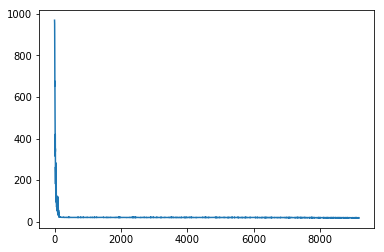

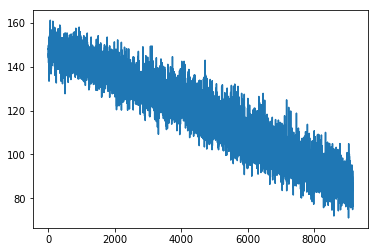

epoch 78 start


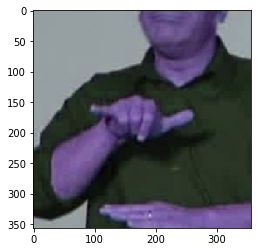

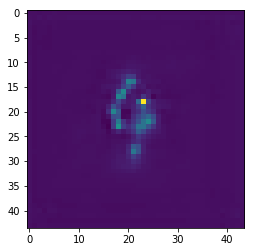

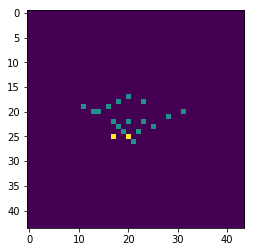

heatmap cost
Heat_loss :  19.103746
vectormap cost
Vector_loss :  92.81583




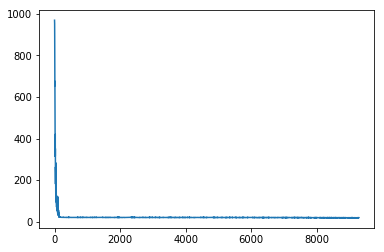

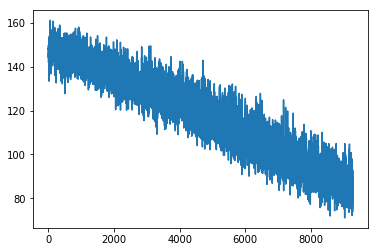

epoch 79 start


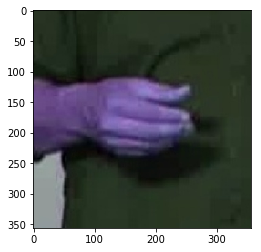

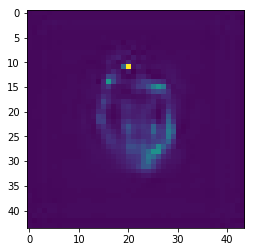

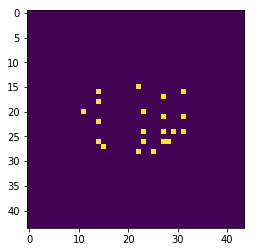

heatmap cost
Heat_loss :  18.826342
vectormap cost
Vector_loss :  83.03128




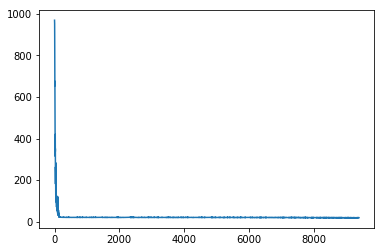

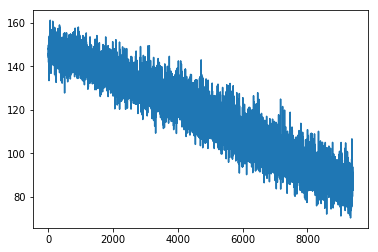

epoch 80 start


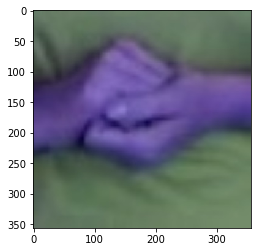

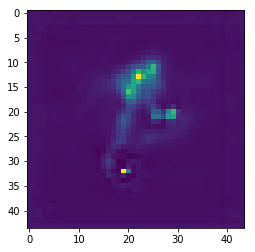

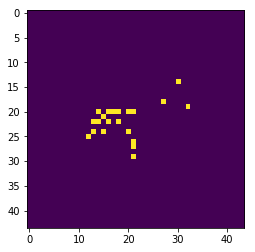

heatmap cost
Heat_loss :  18.88696
vectormap cost
Vector_loss :  84.39903




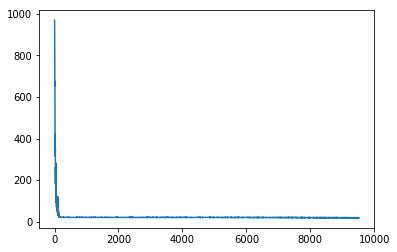

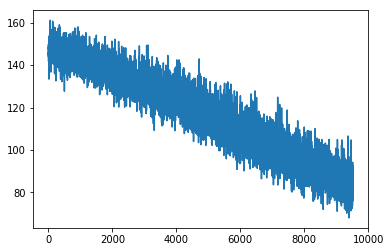

epoch 81 start


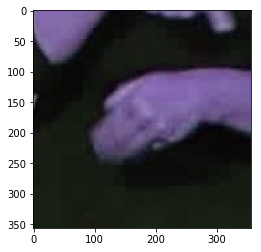

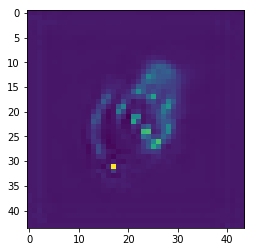

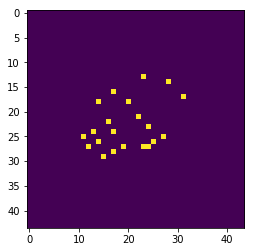

heatmap cost
Heat_loss :  18.552198
vectormap cost
Vector_loss :  91.2963




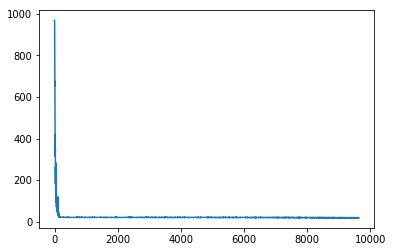

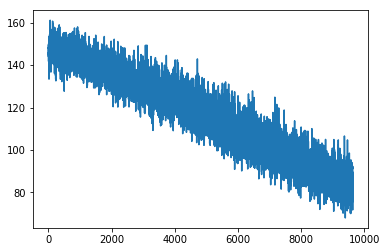

epoch 82 start


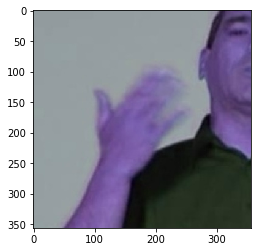

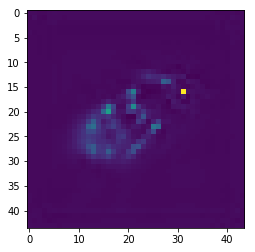

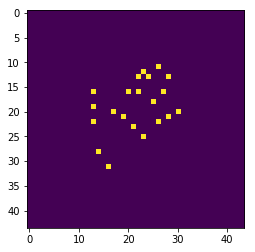

heatmap cost
Heat_loss :  18.428017
vectormap cost
Vector_loss :  75.0139




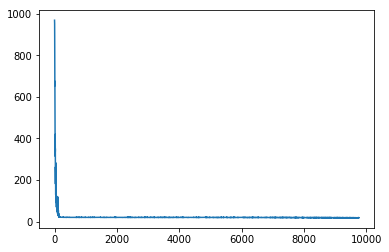

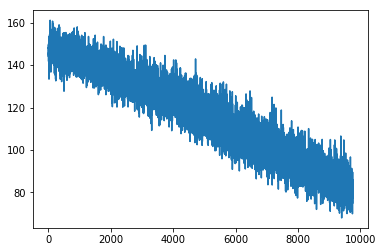

epoch 83 start


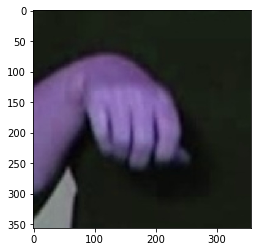

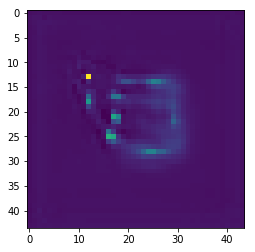

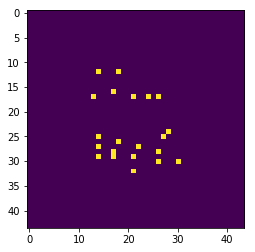

heatmap cost
Heat_loss :  18.947147
vectormap cost
Vector_loss :  83.30272




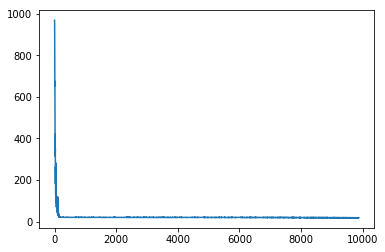

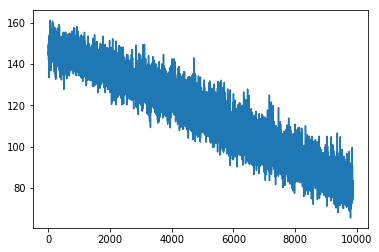

epoch 84 start


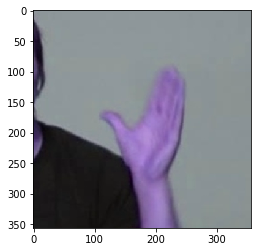

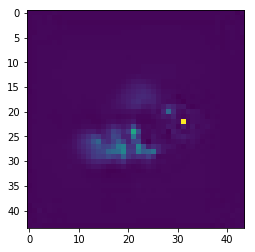

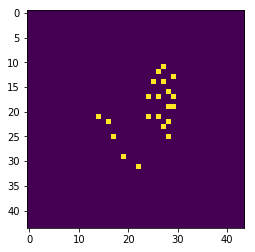

heatmap cost
Heat_loss :  18.540493
vectormap cost
Vector_loss :  78.284775




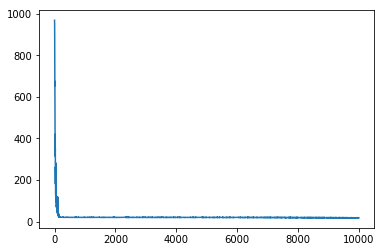

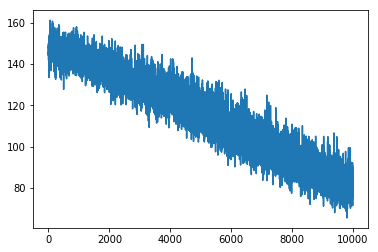

epoch 85 start


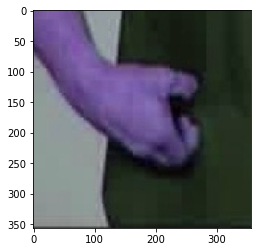

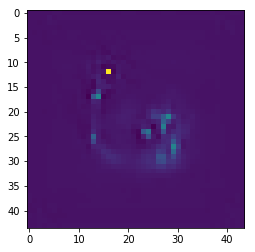

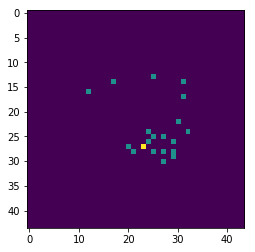

heatmap cost
Heat_loss :  17.765364
vectormap cost
Vector_loss :  78.14338




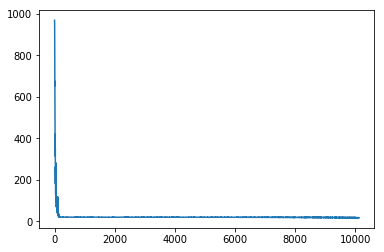

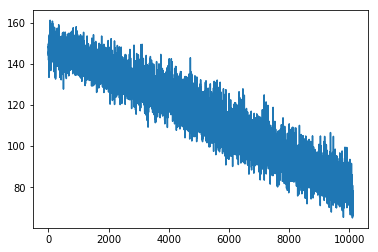

epoch 86 start


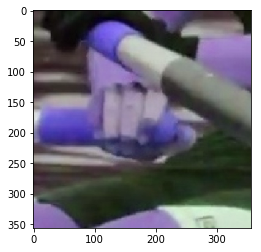

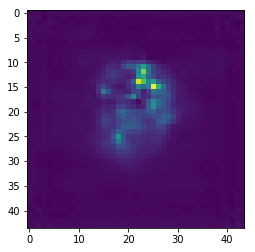

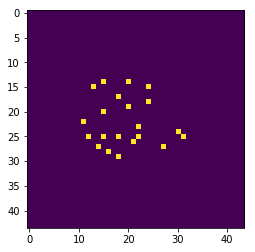

heatmap cost
Heat_loss :  17.105465
vectormap cost
Vector_loss :  68.44275




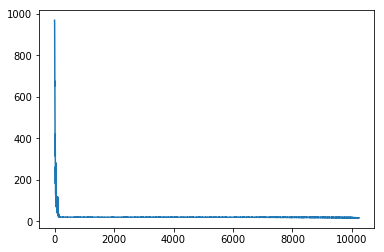

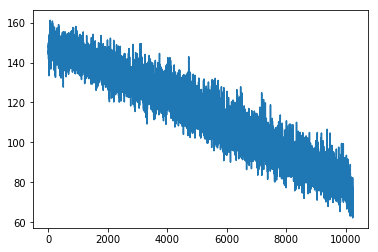

epoch 87 start


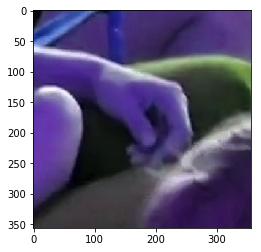

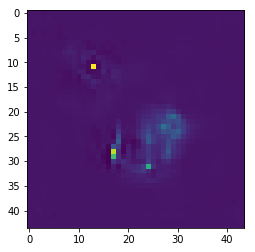

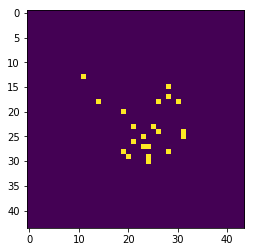

heatmap cost
Heat_loss :  17.219725
vectormap cost
Vector_loss :  76.54909




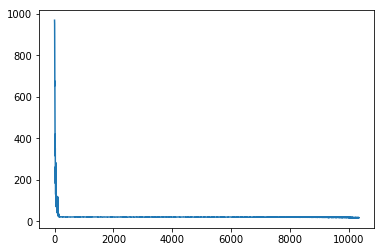

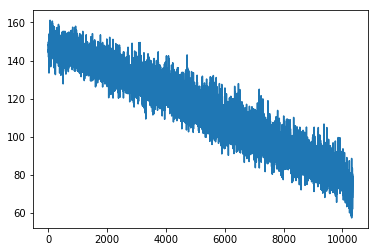

epoch 88 start


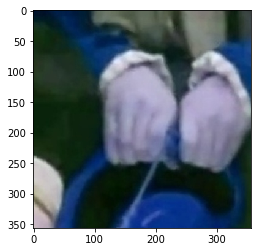

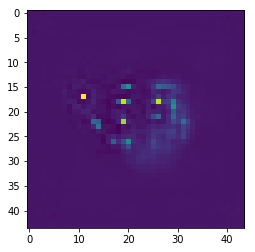

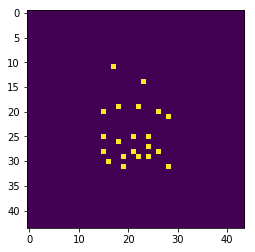

heatmap cost
Heat_loss :  16.826473
vectormap cost
Vector_loss :  74.17099




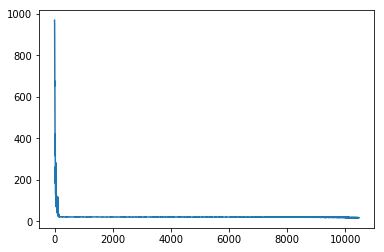

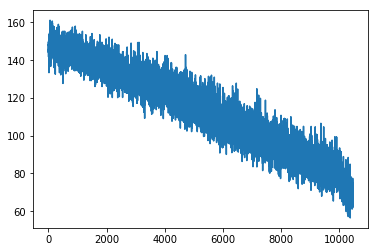

epoch 89 start


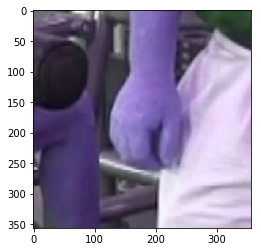

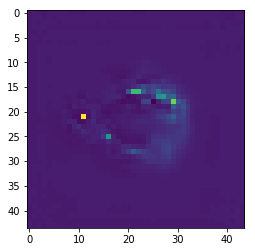

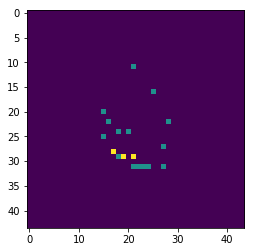

heatmap cost
Heat_loss :  16.533113
vectormap cost
Vector_loss :  72.07018




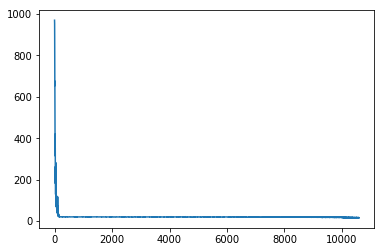

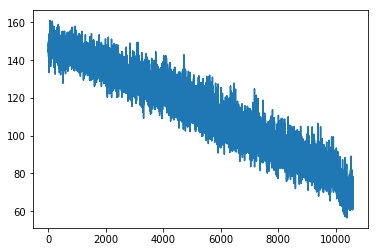

epoch 90 start


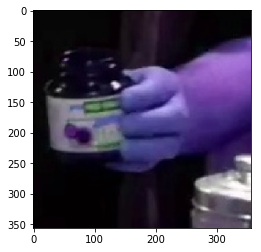

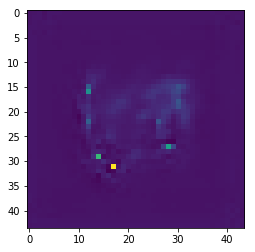

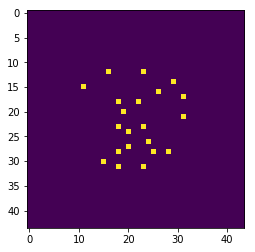

heatmap cost
Heat_loss :  16.751842
vectormap cost
Vector_loss :  68.18245




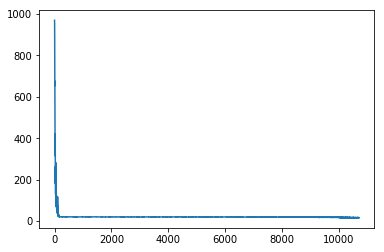

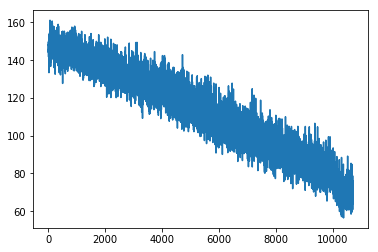

epoch 91 start


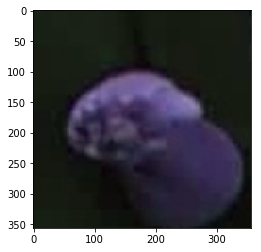

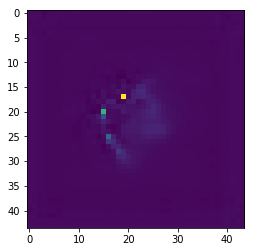

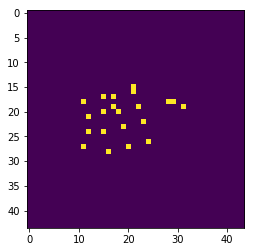

heatmap cost
Heat_loss :  16.808352
vectormap cost
Vector_loss :  71.29151




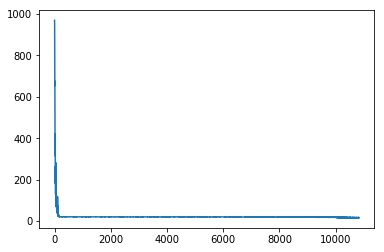

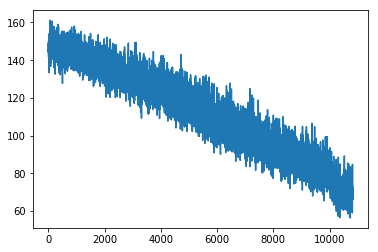

epoch 92 start


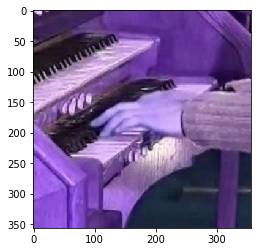

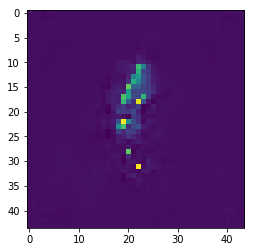

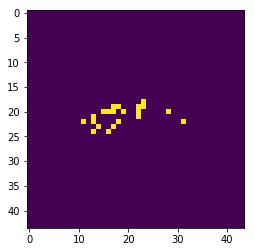

heatmap cost
Heat_loss :  15.5007925
vectormap cost
Vector_loss :  64.30545




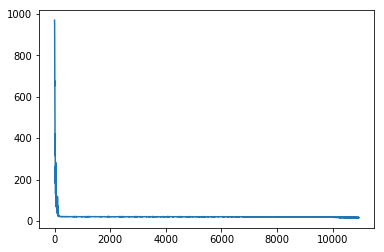

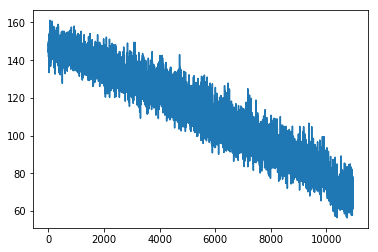

epoch 93 start


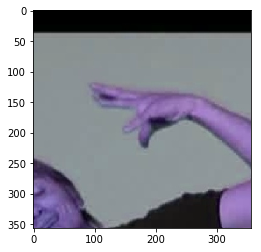

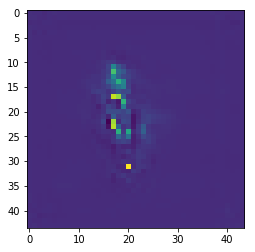

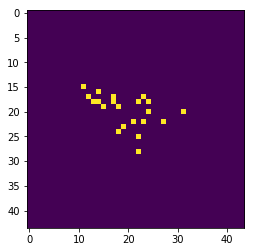

heatmap cost
Heat_loss :  16.419449
vectormap cost
Vector_loss :  84.97639




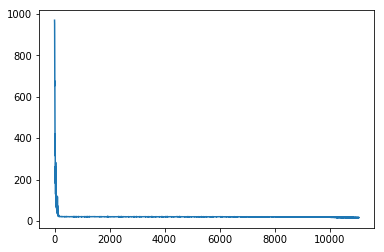

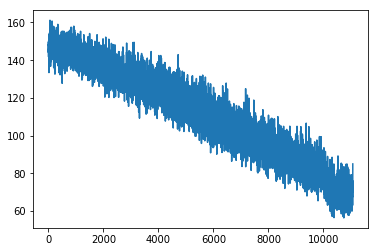

epoch 94 start


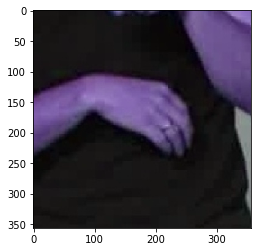

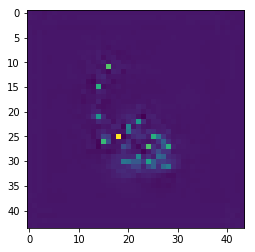

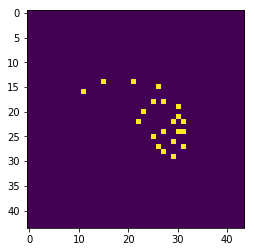

heatmap cost
Heat_loss :  14.852149
vectormap cost
Vector_loss :  60.396957




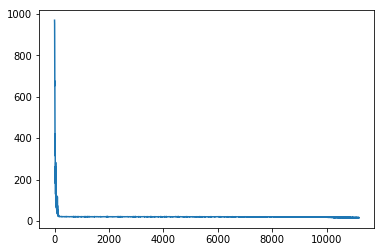

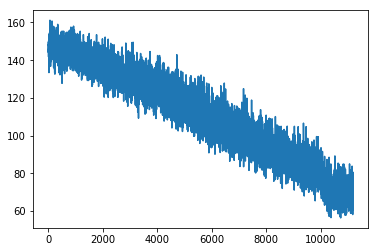

epoch 95 start


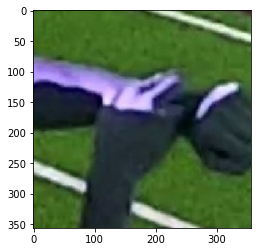

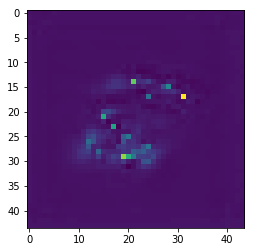

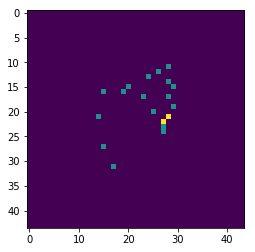

heatmap cost
Heat_loss :  15.709005
vectormap cost
Vector_loss :  69.043434




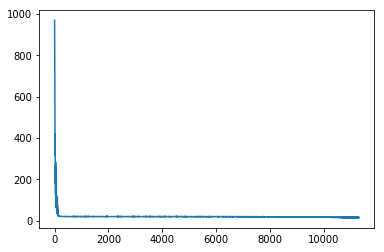

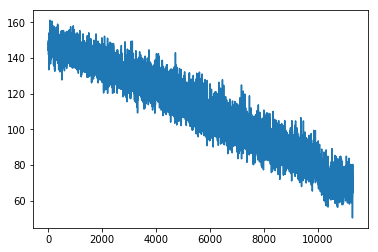

epoch 96 start


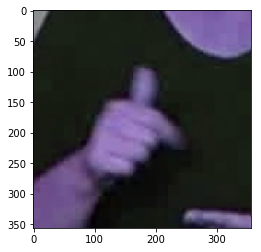

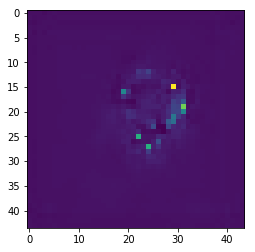

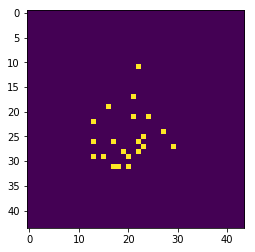

heatmap cost
Heat_loss :  15.365716
vectormap cost
Vector_loss :  66.885315




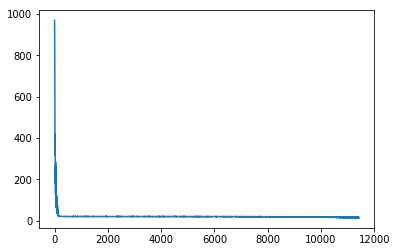

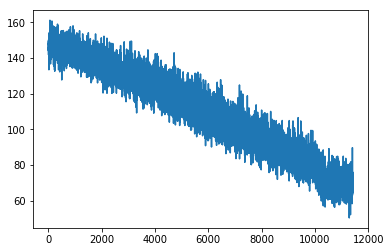

epoch 97 start


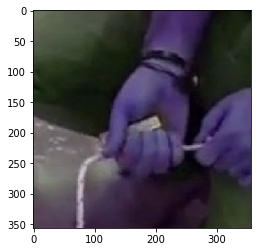

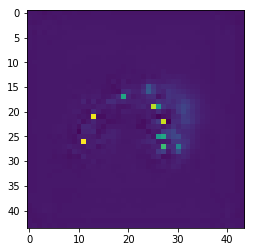

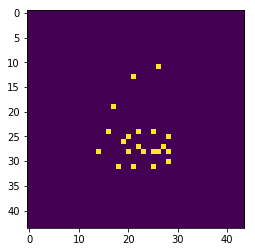

heatmap cost
Heat_loss :  15.415229
vectormap cost
Vector_loss :  70.012344




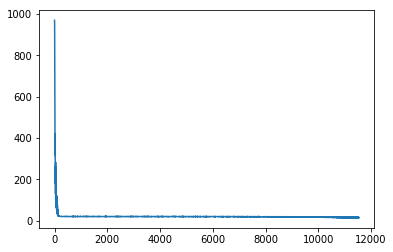

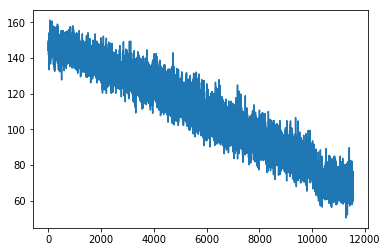

epoch 98 start


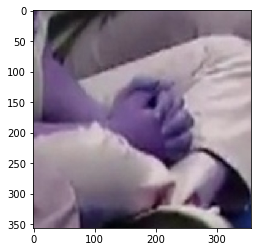

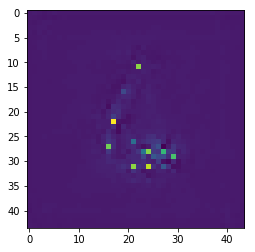

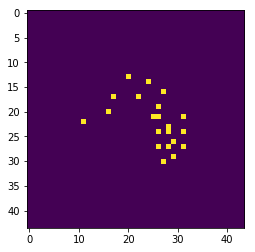

heatmap cost
Heat_loss :  14.729394
vectormap cost
Vector_loss :  61.65608




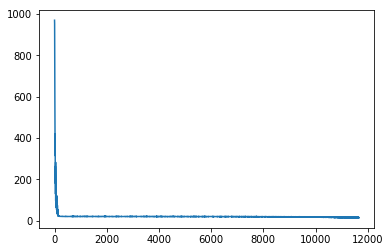

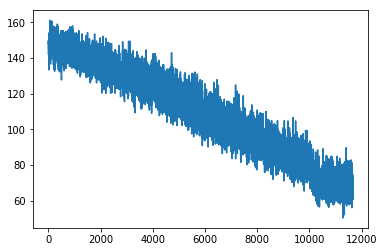

epoch 99 start


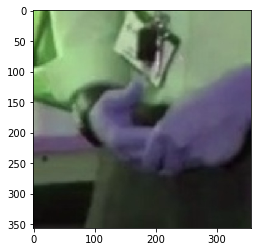

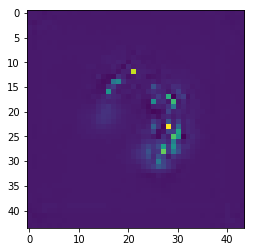

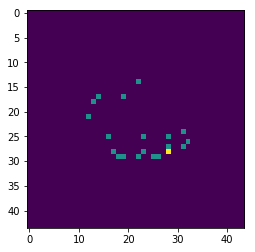

heatmap cost
Heat_loss :  14.20768
vectormap cost
Vector_loss :  68.108086




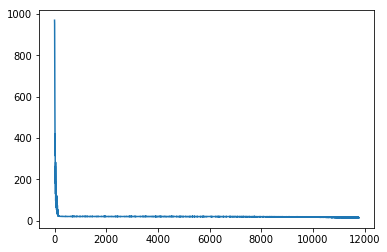

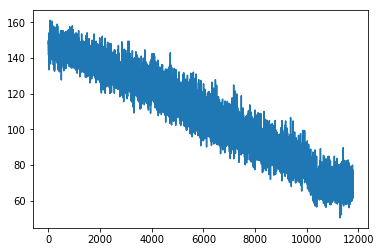

epoch 100 start


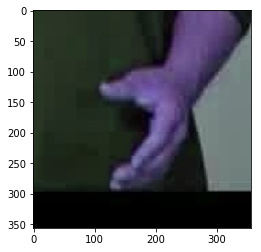

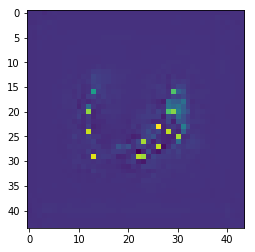

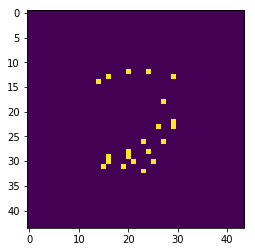

heatmap cost
Heat_loss :  14.2888975
vectormap cost
Vector_loss :  62.10753




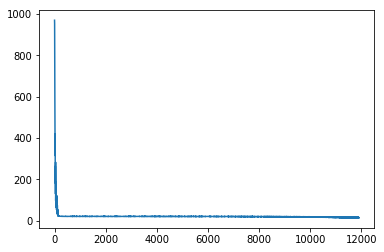

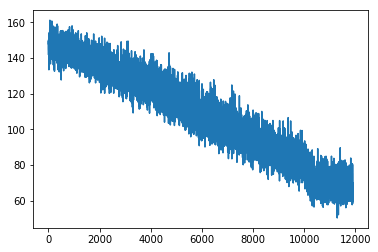

epoch 101 start


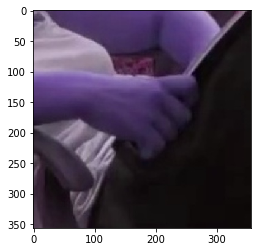

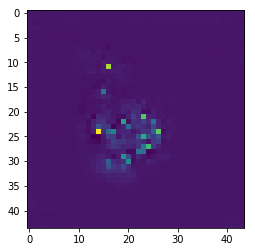

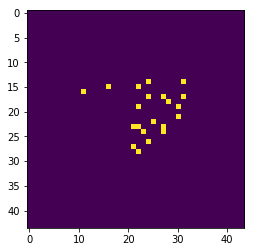

heatmap cost
Heat_loss :  13.74178
vectormap cost
Vector_loss :  63.385612




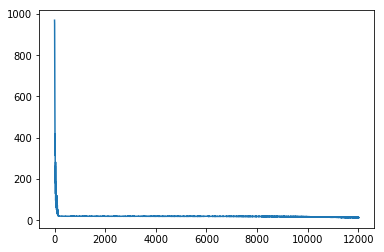

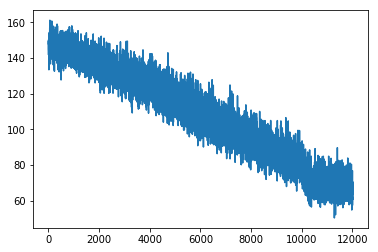

epoch 102 start


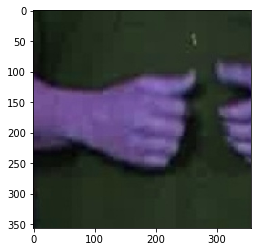

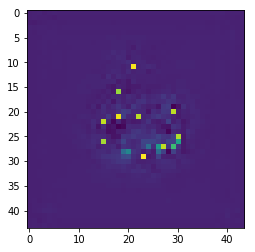

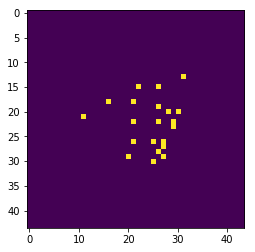

heatmap cost
Heat_loss :  13.944617
vectormap cost
Vector_loss :  66.67687




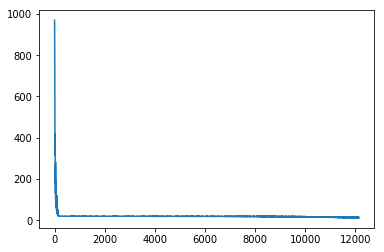

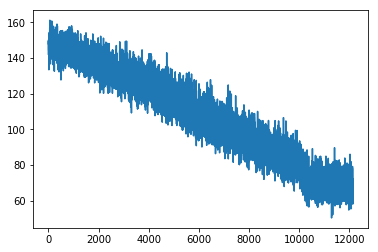

epoch 103 start


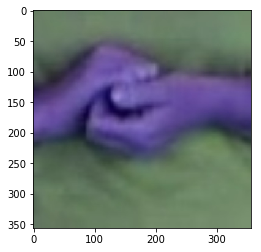

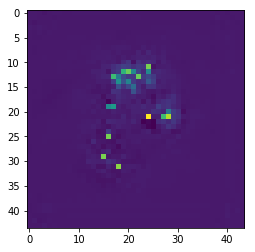

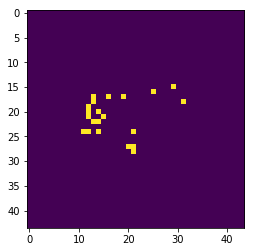

heatmap cost
Heat_loss :  13.443394
vectormap cost
Vector_loss :  63.83426




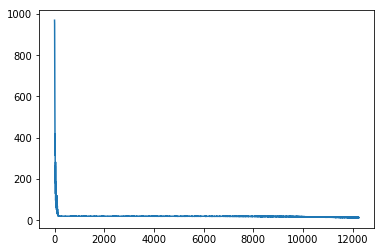

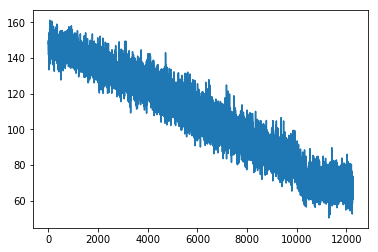

epoch 104 start


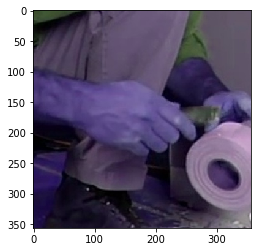

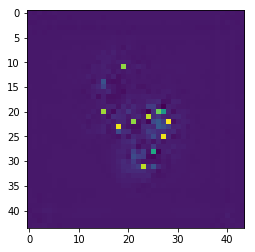

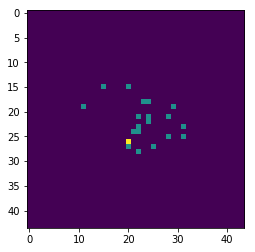

heatmap cost
Heat_loss :  13.518892
vectormap cost
Vector_loss :  64.88789




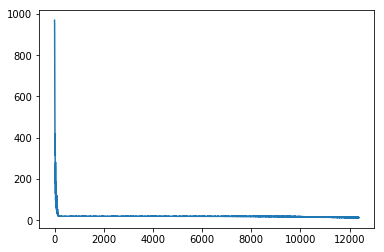

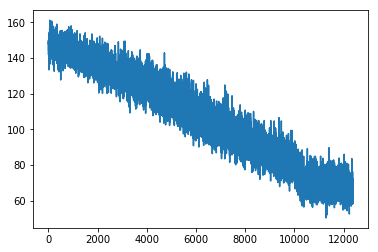

epoch 105 start


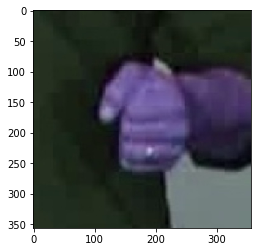

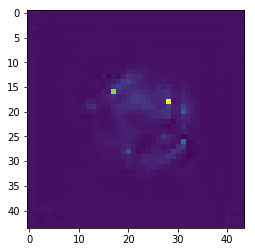

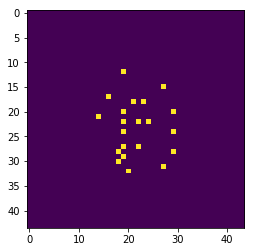

heatmap cost
Heat_loss :  13.521137
vectormap cost
Vector_loss :  66.17751




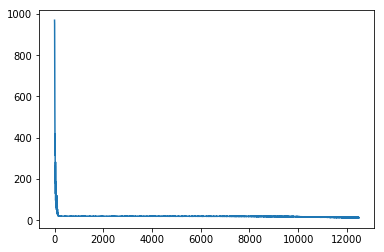

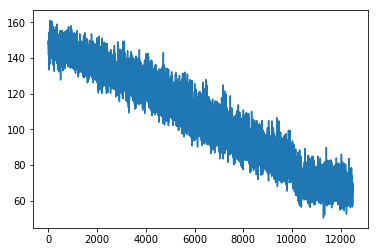

epoch 106 start


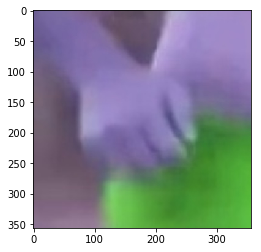

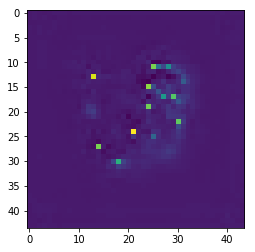

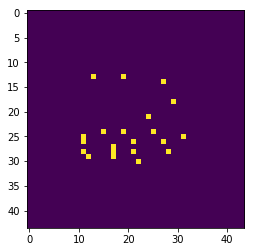

heatmap cost
Heat_loss :  14.062789
vectormap cost
Vector_loss :  66.52837




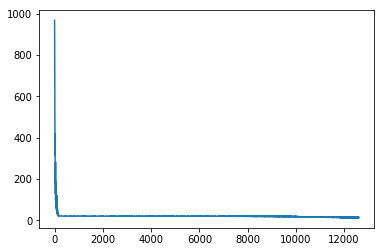

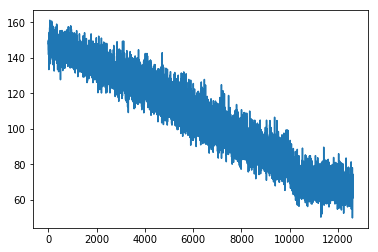

epoch 107 start


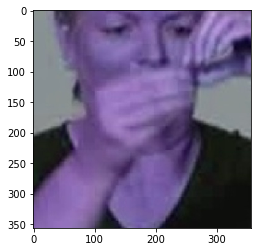

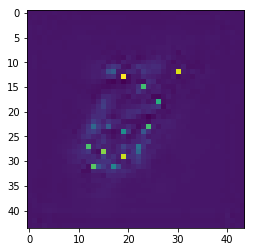

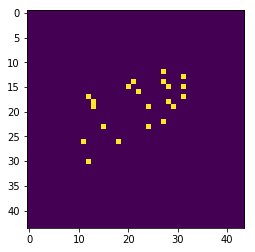

heatmap cost
Heat_loss :  13.786154
vectormap cost
Vector_loss :  68.71289




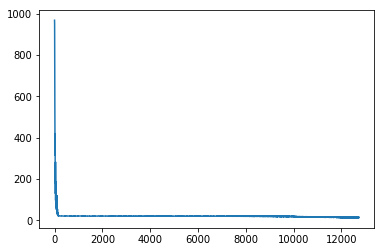

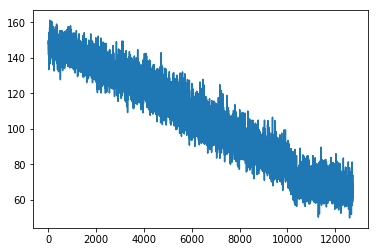

epoch 108 start


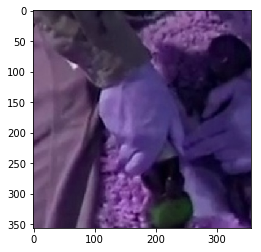

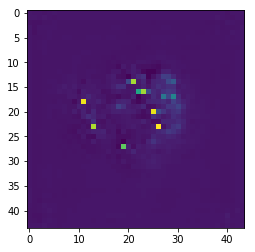

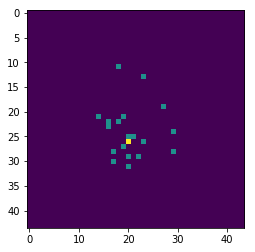

heatmap cost
Heat_loss :  13.141867
vectormap cost
Vector_loss :  67.50881




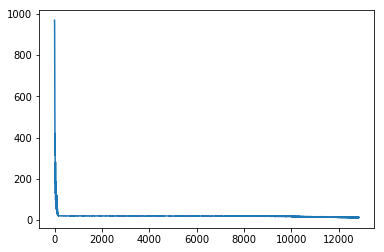

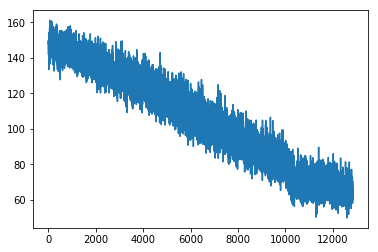

epoch 109 start


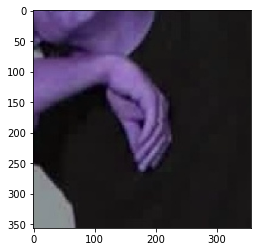

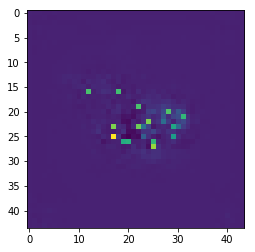

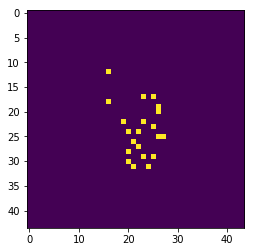

heatmap cost
Heat_loss :  12.756456
vectormap cost
Vector_loss :  66.94829




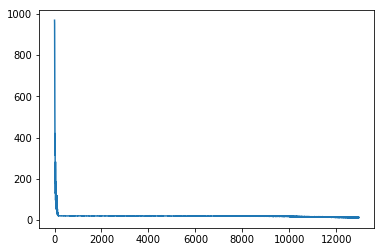

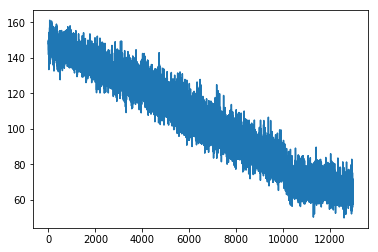

epoch 110 start


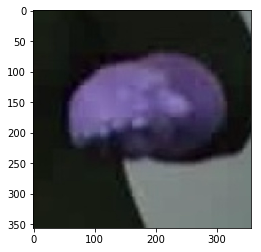

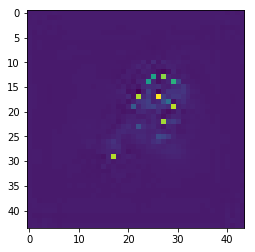

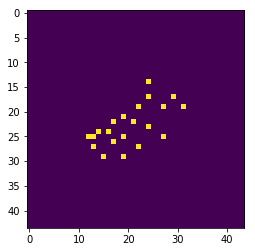

heatmap cost
Heat_loss :  12.445105
vectormap cost
Vector_loss :  65.461




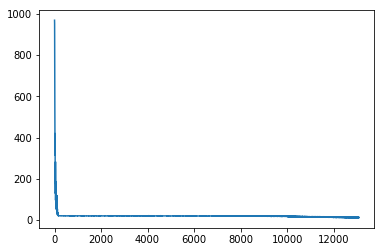

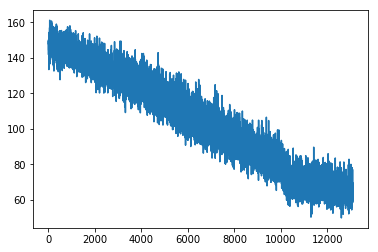

epoch 111 start


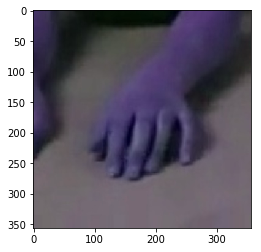

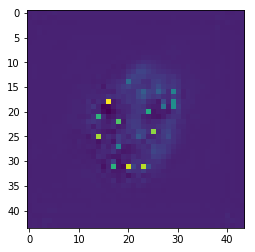

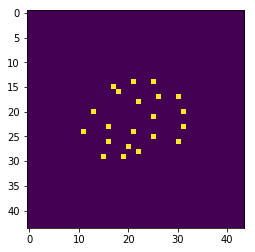

heatmap cost
Heat_loss :  13.945041
vectormap cost
Vector_loss :  70.85837




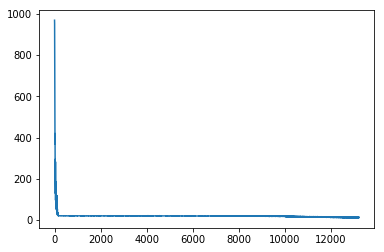

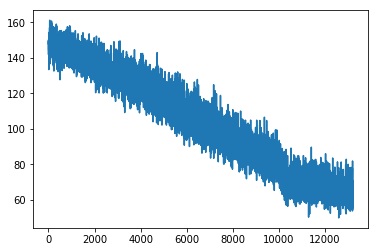

epoch 112 start


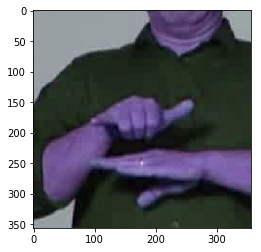

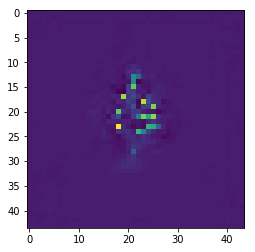

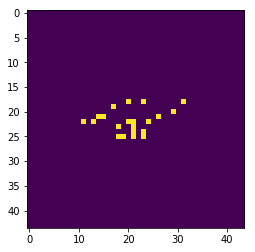

heatmap cost
Heat_loss :  12.3000145
vectormap cost
Vector_loss :  65.272095




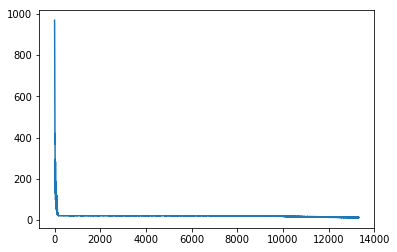

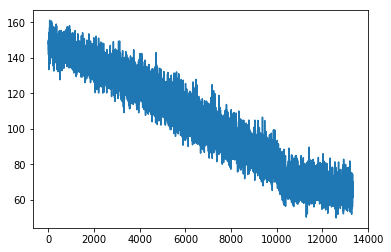

epoch 113 start


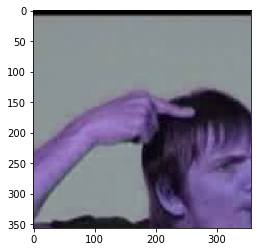

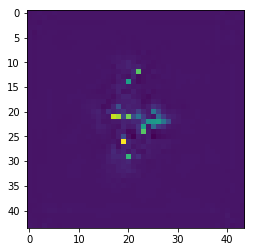

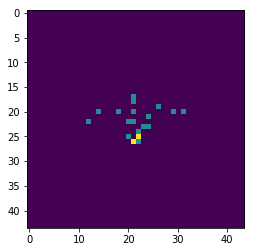

heatmap cost
Heat_loss :  10.854074
vectormap cost
Vector_loss :  59.10594




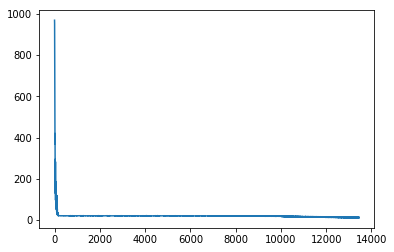

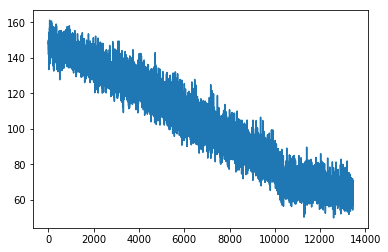

epoch 114 start


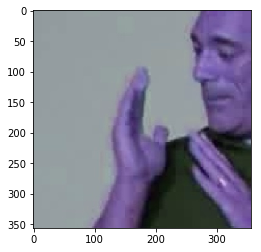

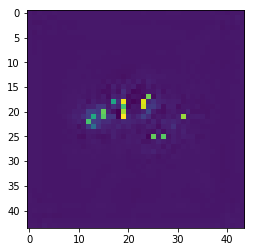

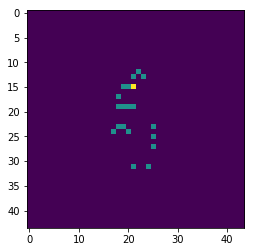

heatmap cost
Heat_loss :  11.786479
vectormap cost
Vector_loss :  65.21047




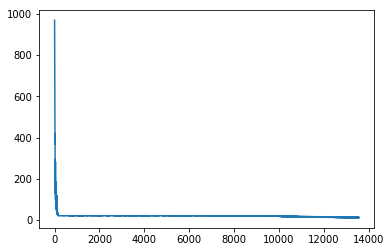

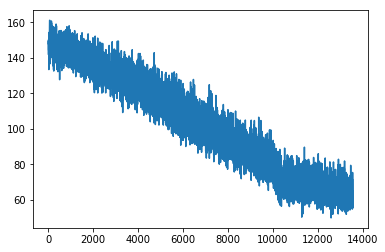

epoch 115 start


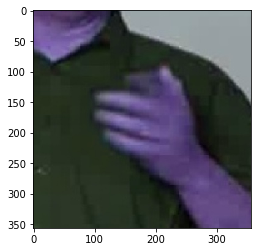

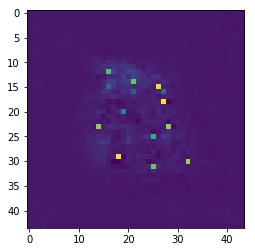

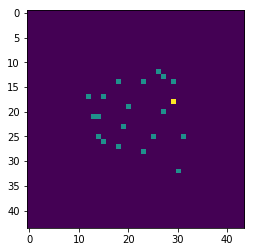

heatmap cost
Heat_loss :  11.804073
vectormap cost
Vector_loss :  69.753426




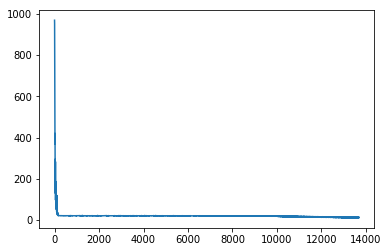

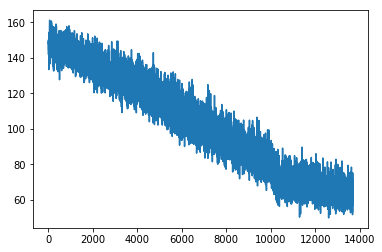

epoch 116 start


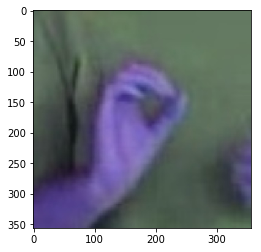

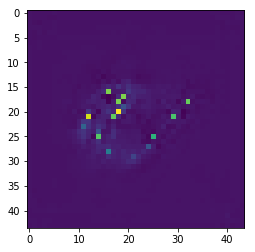

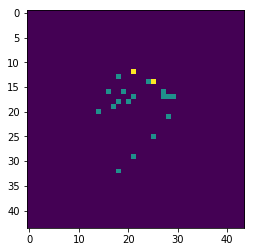

heatmap cost
Heat_loss :  11.625397
vectormap cost
Vector_loss :  62.235287




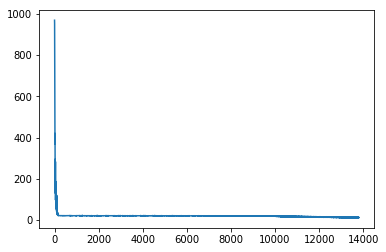

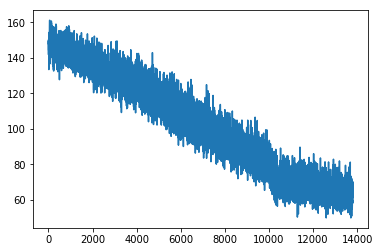

epoch 117 start


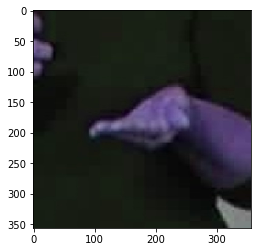

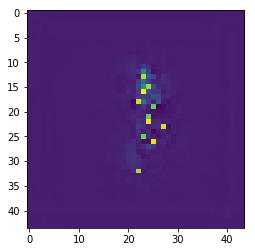

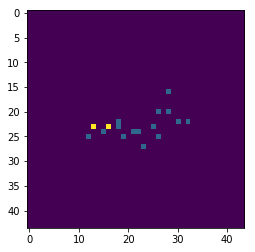

heatmap cost
Heat_loss :  9.717636
vectormap cost
Vector_loss :  58.0259




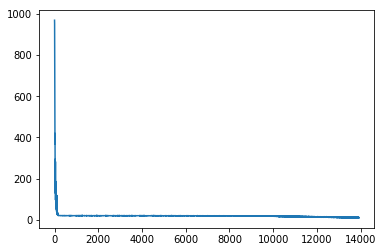

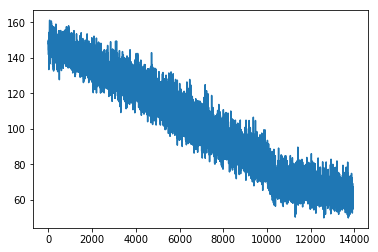

epoch 118 start


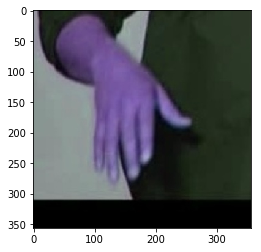

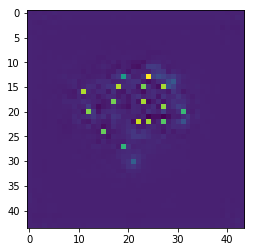

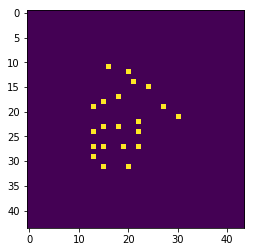

heatmap cost
Heat_loss :  11.247721
vectormap cost
Vector_loss :  59.45131




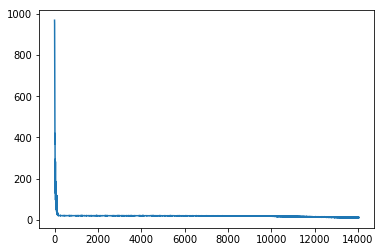

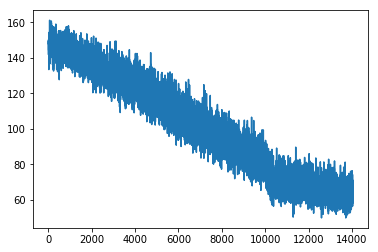

epoch 119 start


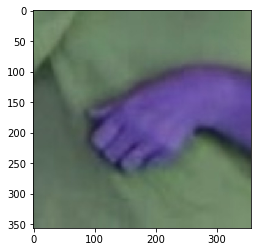

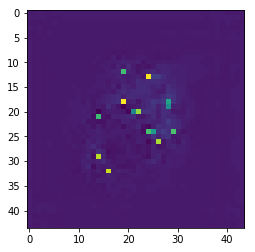

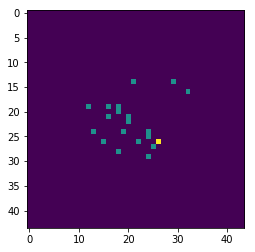

heatmap cost
Heat_loss :  13.01034
vectormap cost
Vector_loss :  61.894176




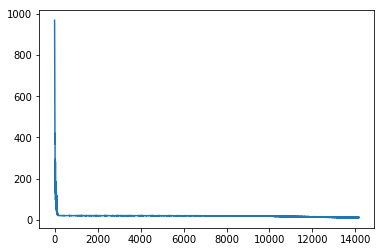

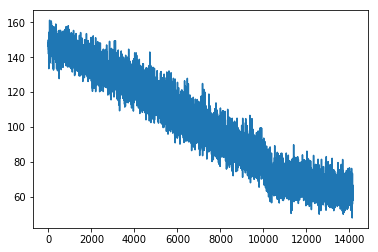

epoch 120 start


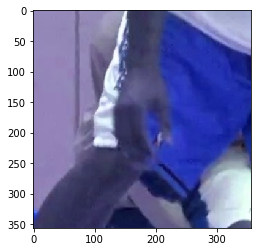

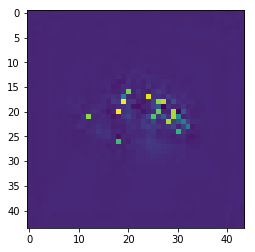

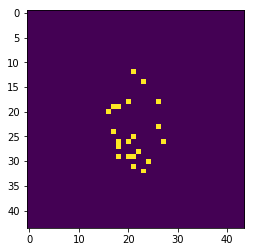

heatmap cost
Heat_loss :  11.043193
vectormap cost
Vector_loss :  58.622295




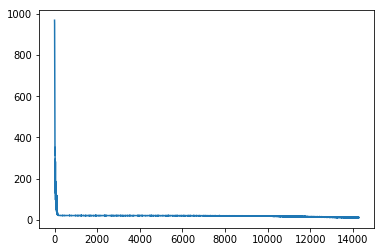

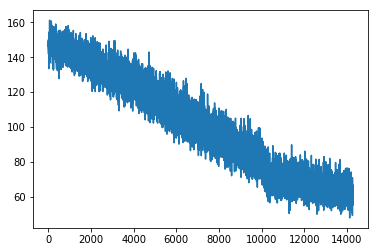

epoch 121 start


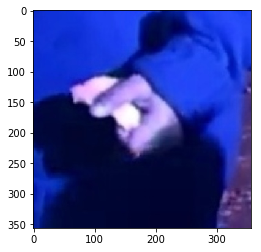

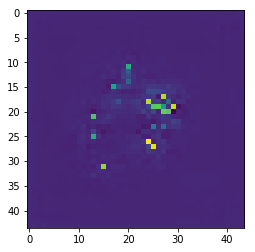

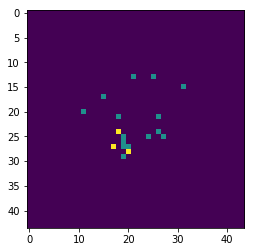

heatmap cost
Heat_loss :  10.75004
vectormap cost
Vector_loss :  60.167557




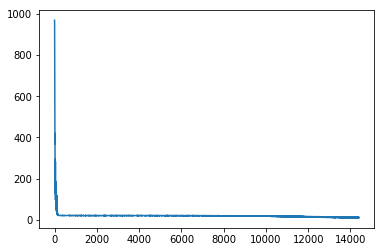

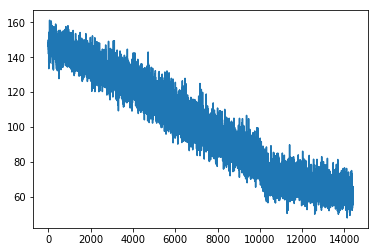

epoch 122 start


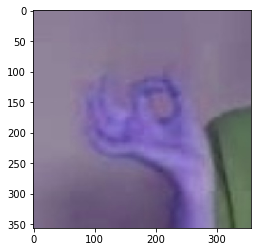

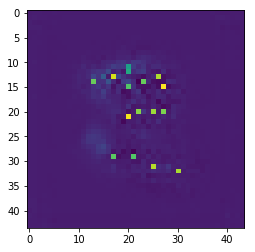

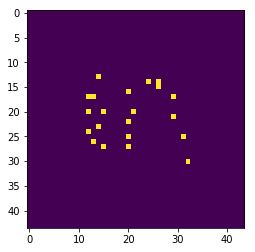

heatmap cost
Heat_loss :  10.329426
vectormap cost
Vector_loss :  60.648758




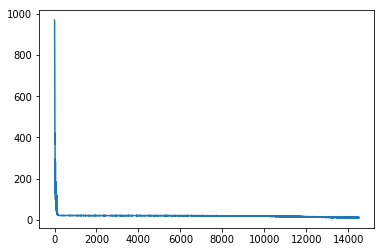

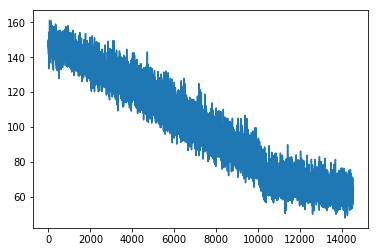

epoch 123 start


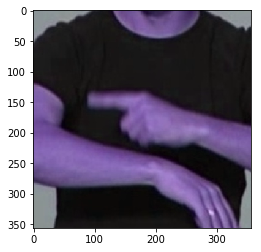

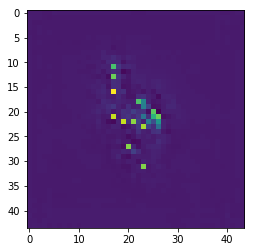

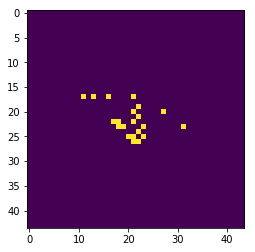

heatmap cost
Heat_loss :  11.793165
vectormap cost
Vector_loss :  64.55893




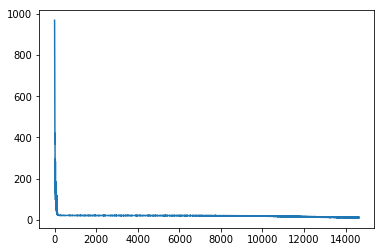

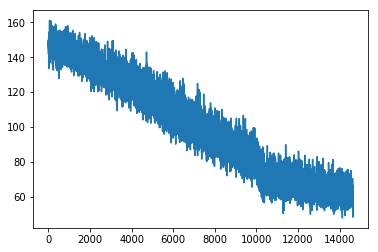

epoch 124 start


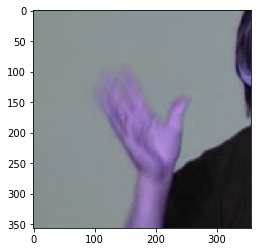

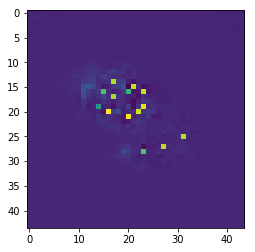

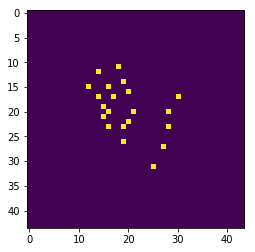

heatmap cost
Heat_loss :  10.933636
vectormap cost
Vector_loss :  62.118256




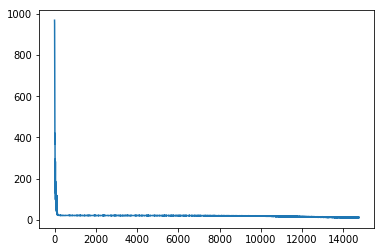

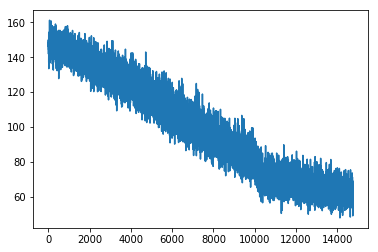

epoch 125 start


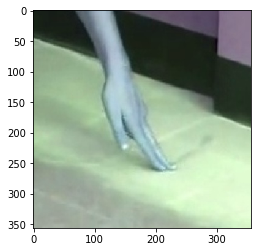

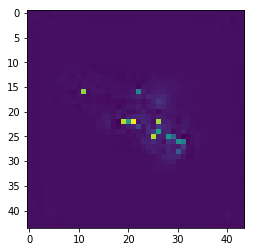

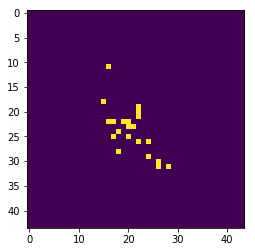

heatmap cost
Heat_loss :  11.089431
vectormap cost
Vector_loss :  63.521103




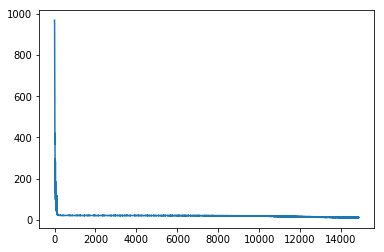

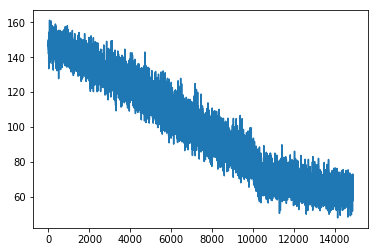

epoch 126 start


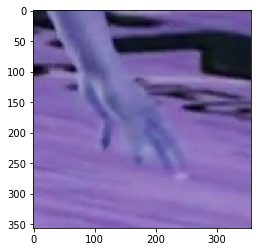

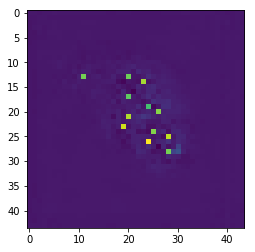

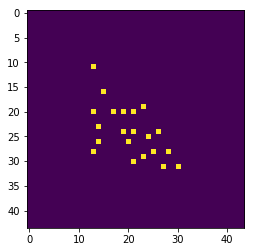

heatmap cost
Heat_loss :  10.236637
vectormap cost
Vector_loss :  61.89622




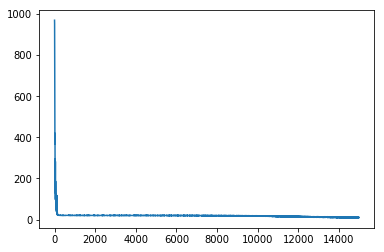

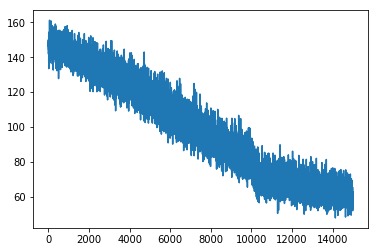

epoch 127 start


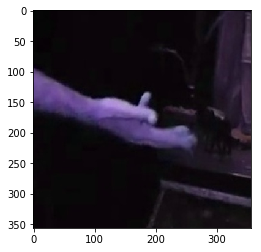

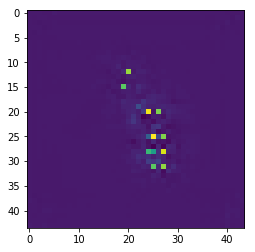

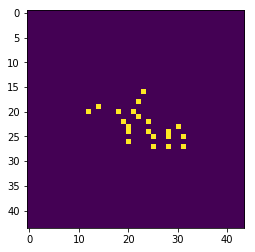

heatmap cost
Heat_loss :  8.929804
vectormap cost
Vector_loss :  53.358925




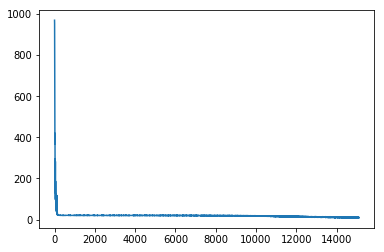

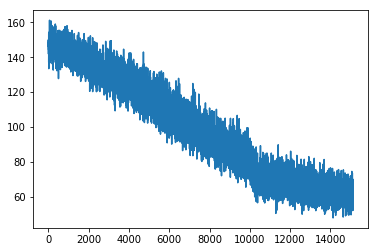

epoch 128 start


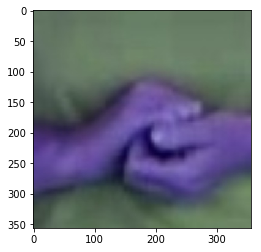

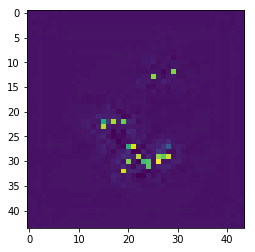

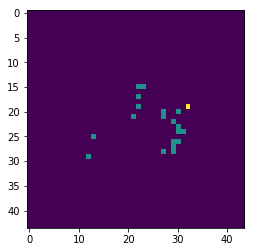

heatmap cost
Heat_loss :  9.121054
vectormap cost
Vector_loss :  57.26621




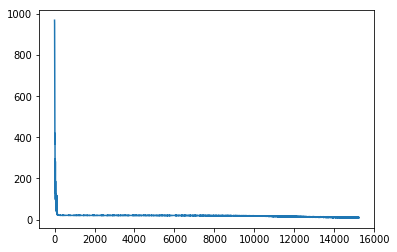

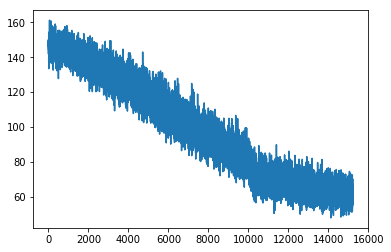

epoch 129 start


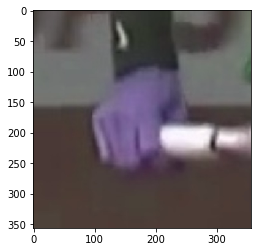

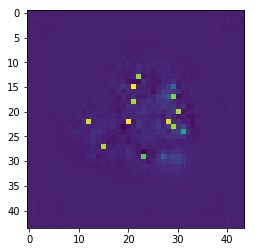

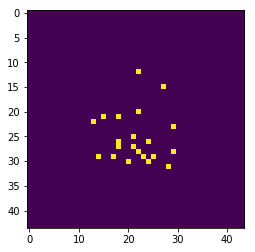

heatmap cost
Heat_loss :  12.209063
vectormap cost
Vector_loss :  73.67103




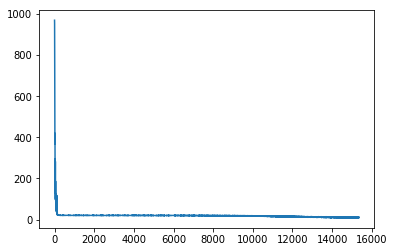

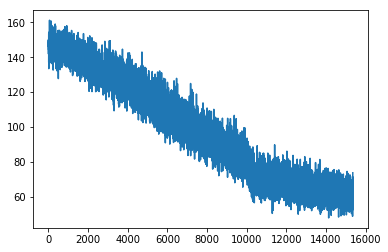

epoch 130 start


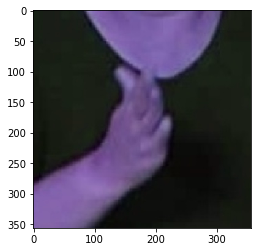

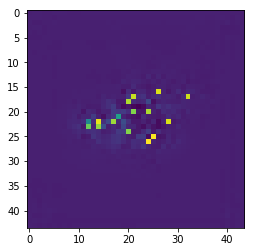

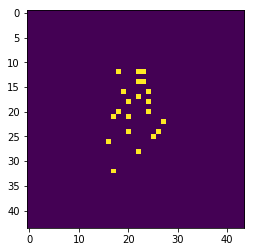

heatmap cost
Heat_loss :  9.316286
vectormap cost
Vector_loss :  58.60639




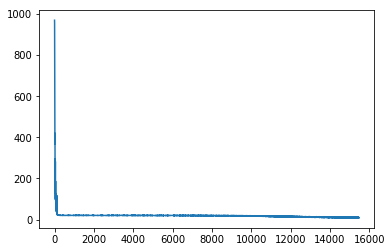

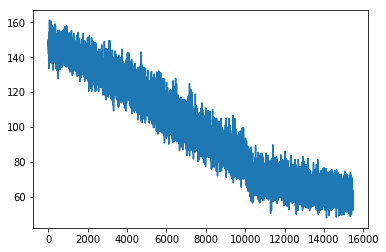

epoch 131 start


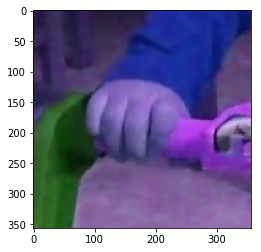

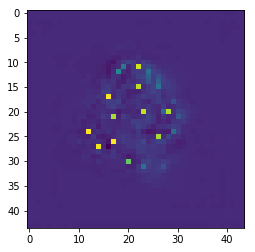

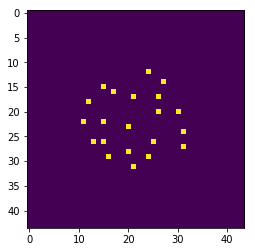

heatmap cost
Heat_loss :  9.756411
vectormap cost
Vector_loss :  60.639294




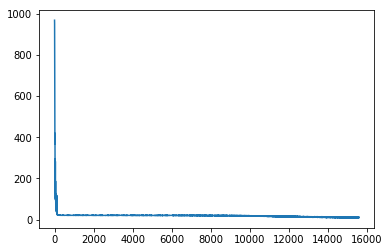

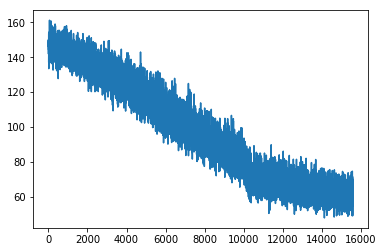

epoch 132 start


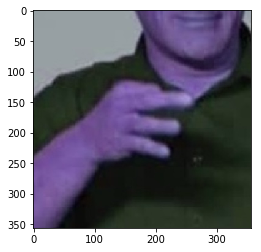

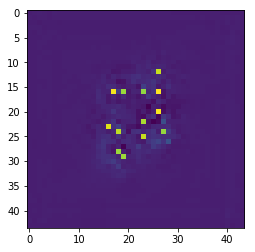

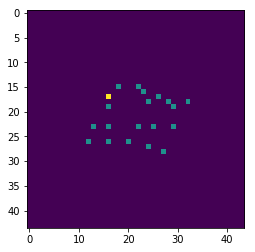

heatmap cost
Heat_loss :  9.929504
vectormap cost
Vector_loss :  62.771576




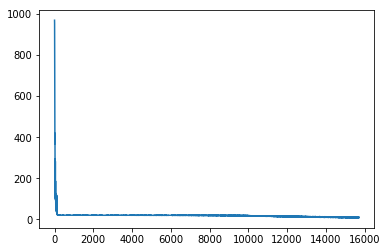

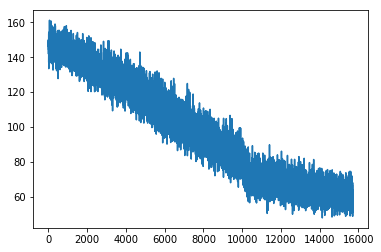

epoch 133 start


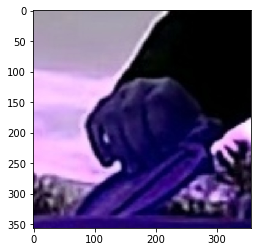

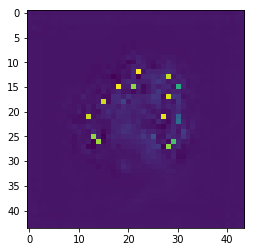

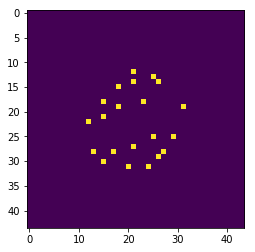

heatmap cost
Heat_loss :  8.957354
vectormap cost
Vector_loss :  55.11567




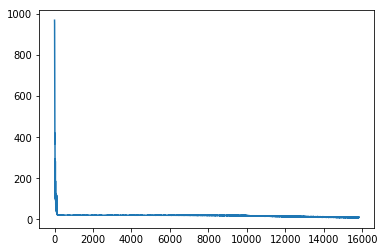

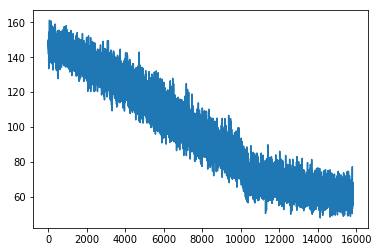

epoch 134 start


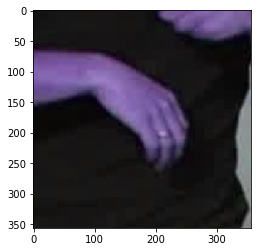

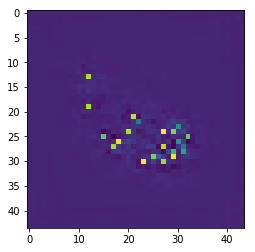

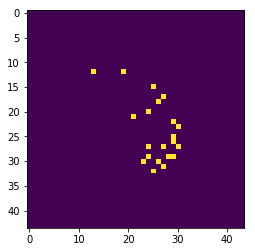

heatmap cost
Heat_loss :  8.751712
vectormap cost
Vector_loss :  55.11427




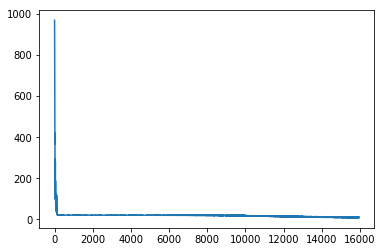

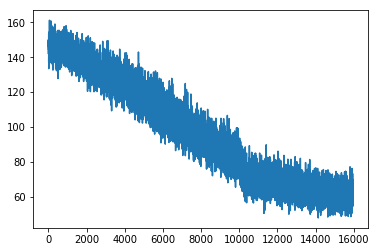

epoch 135 start


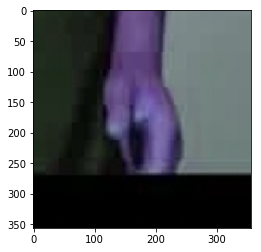

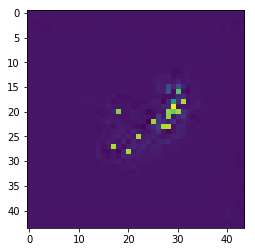

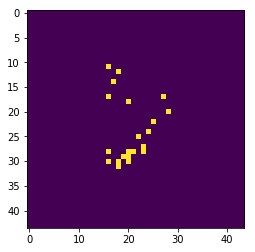

heatmap cost
Heat_loss :  9.69969
vectormap cost
Vector_loss :  60.56856




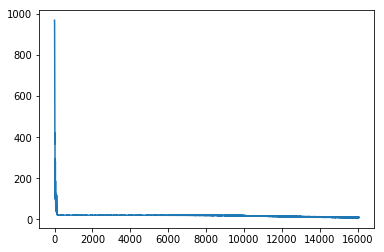

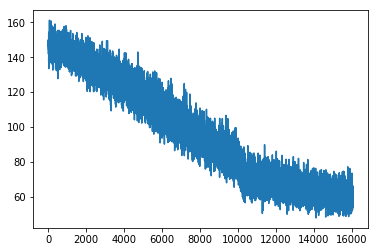

epoch 136 start


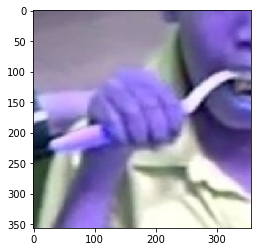

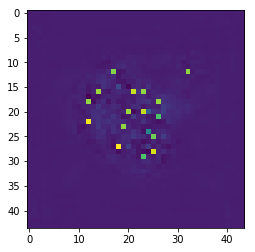

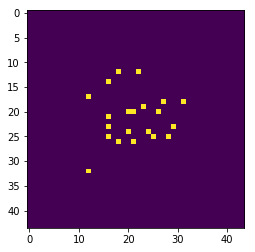

heatmap cost
Heat_loss :  9.961072
vectormap cost
Vector_loss :  63.620956




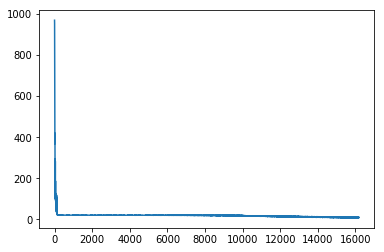

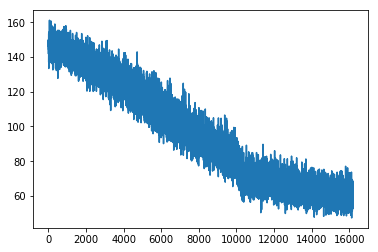

epoch 137 start


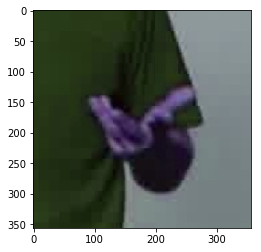

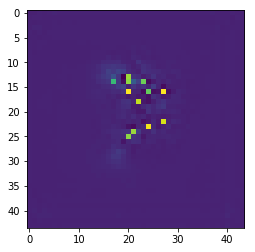

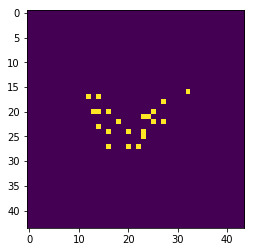

heatmap cost
Heat_loss :  10.943815
vectormap cost
Vector_loss :  71.995834




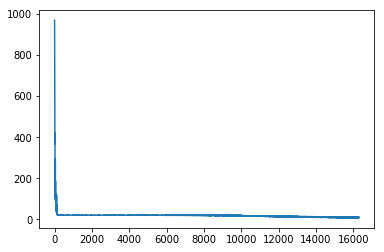

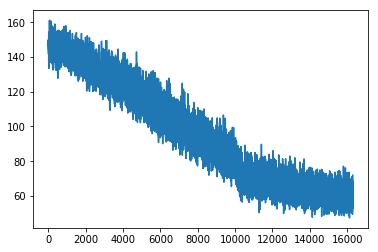

epoch 138 start


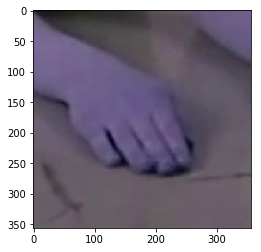

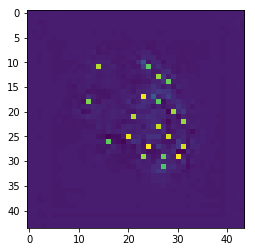

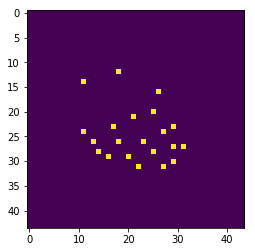

heatmap cost
Heat_loss :  9.049908
vectormap cost
Vector_loss :  55.32129




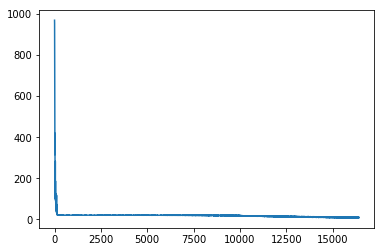

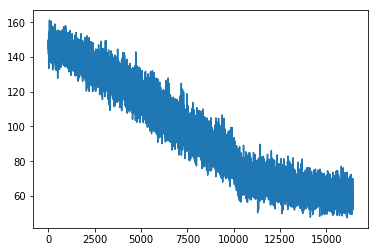

epoch 139 start


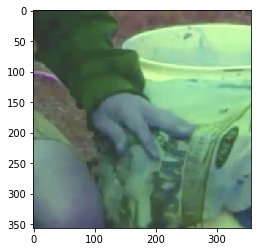

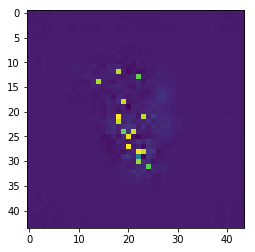

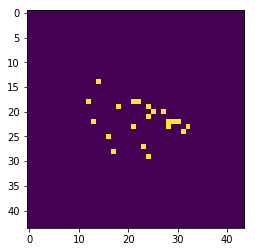

heatmap cost
Heat_loss :  9.206849
vectormap cost
Vector_loss :  60.912437




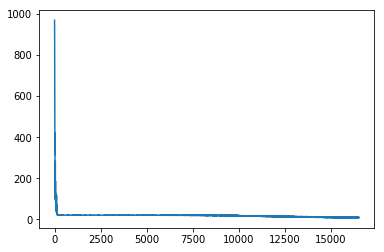

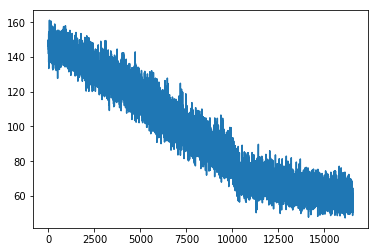

epoch 140 start


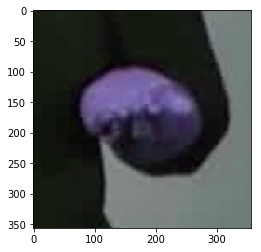

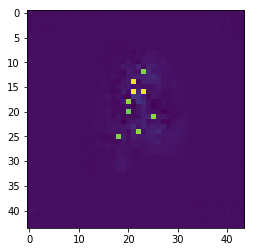

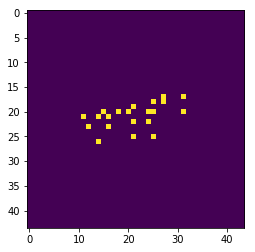

heatmap cost
Heat_loss :  11.725542
vectormap cost
Vector_loss :  75.354256




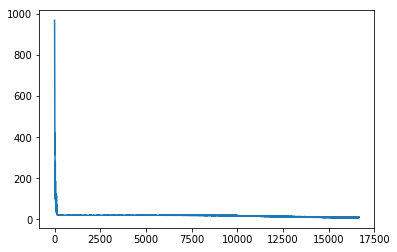

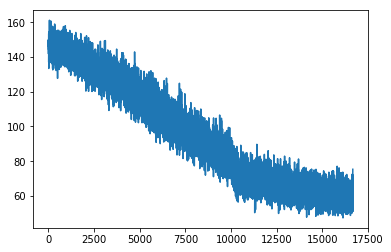

epoch 141 start


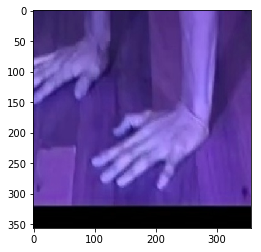

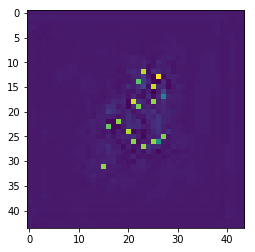

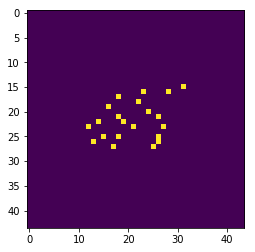

heatmap cost
Heat_loss :  8.27411
vectormap cost
Vector_loss :  51.76825




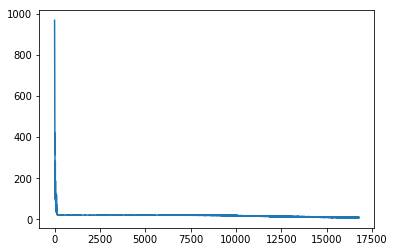

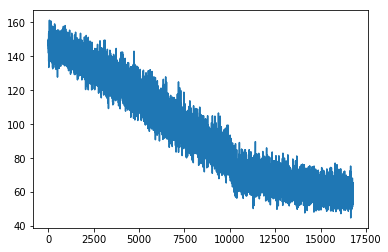

epoch 142 start


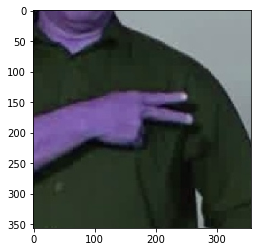

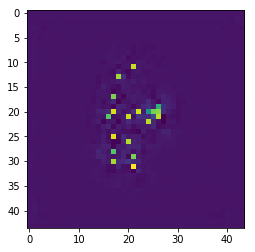

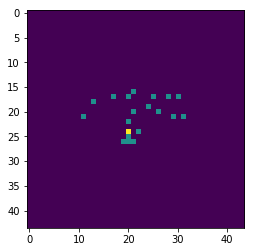

heatmap cost
Heat_loss :  8.0821
vectormap cost
Vector_loss :  55.965893




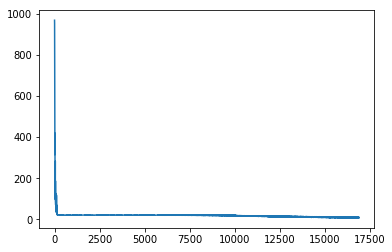

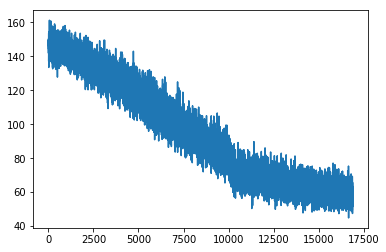

epoch 143 start


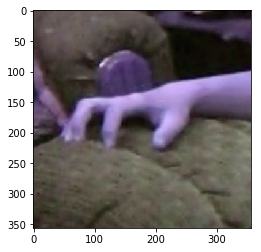

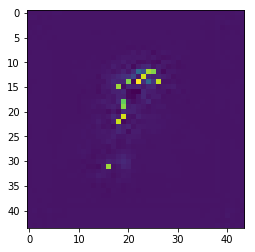

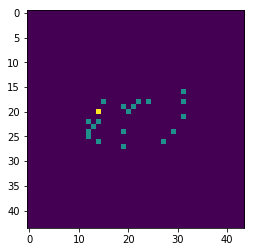

heatmap cost
Heat_loss :  7.9230676
vectormap cost
Vector_loss :  58.03972




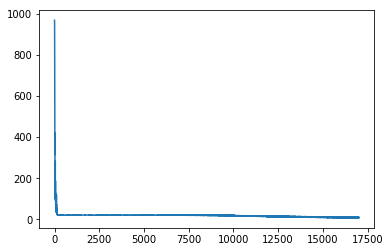

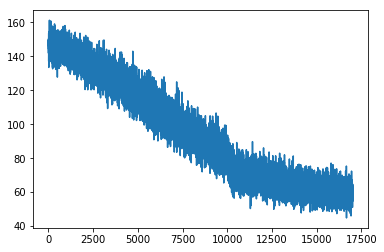

epoch 144 start


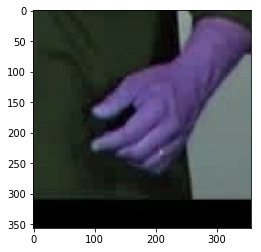

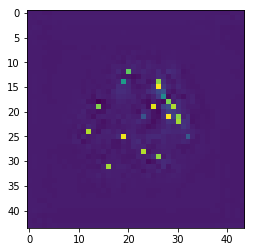

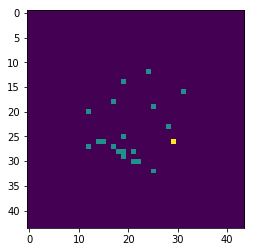

heatmap cost
Heat_loss :  8.456485
vectormap cost
Vector_loss :  55.634262




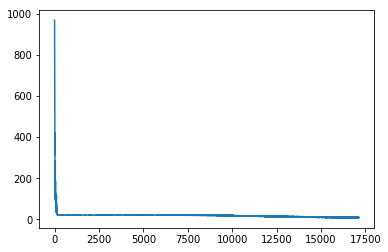

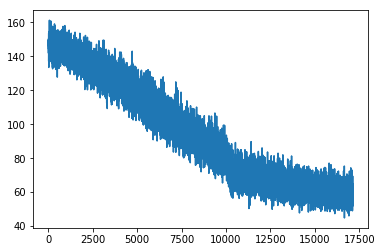

epoch 145 start


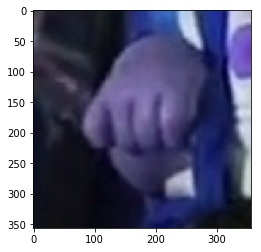

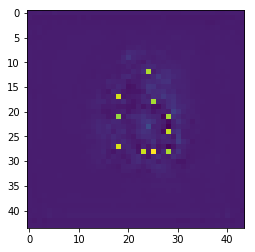

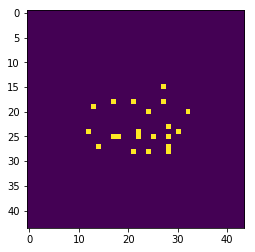

heatmap cost
Heat_loss :  9.04232
vectormap cost
Vector_loss :  62.243893




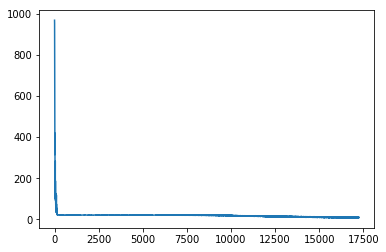

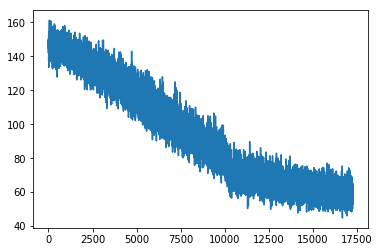

epoch 146 start


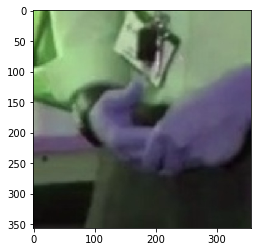

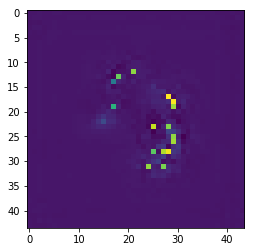

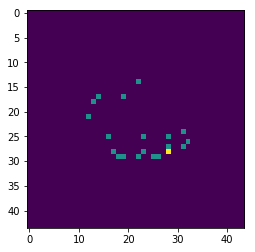

heatmap cost
Heat_loss :  9.234031
vectormap cost
Vector_loss :  60.75112




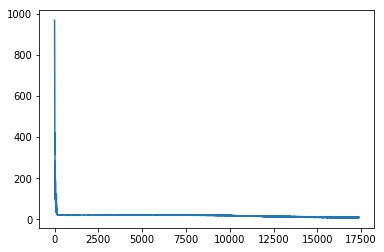

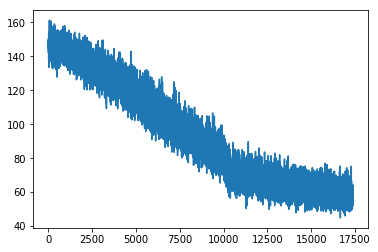

epoch 147 start


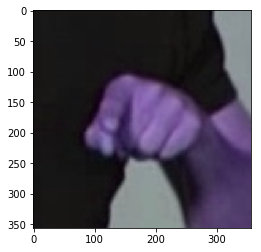

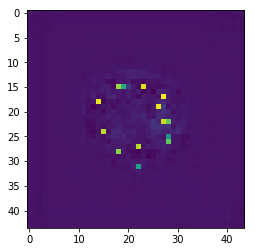

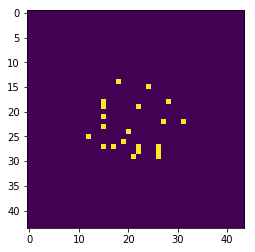

heatmap cost
Heat_loss :  8.302907
vectormap cost
Vector_loss :  58.109756




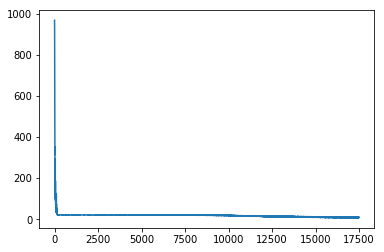

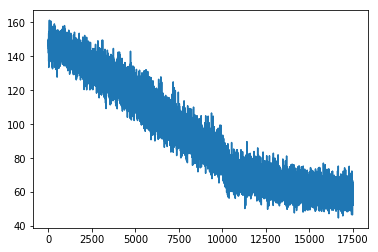

epoch 148 start


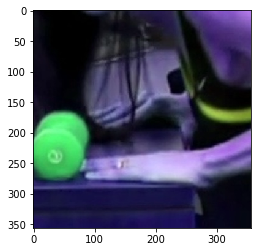

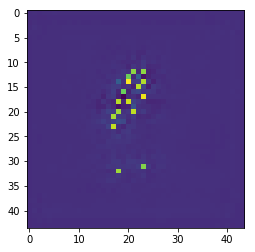

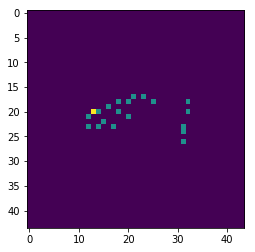

heatmap cost
Heat_loss :  9.344617
vectormap cost
Vector_loss :  64.581505




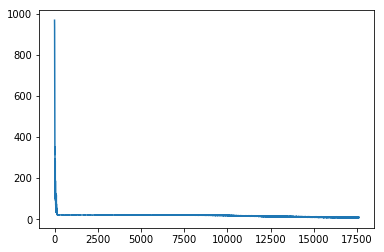

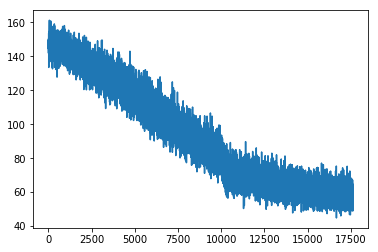

epoch 149 start


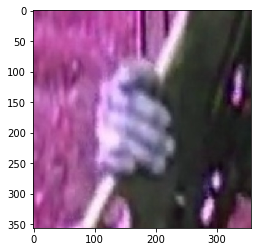

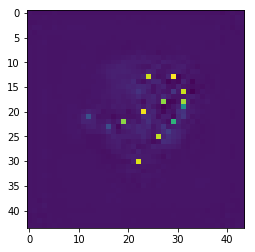

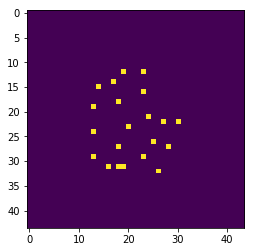

heatmap cost
Heat_loss :  8.094227
vectormap cost
Vector_loss :  57.490532




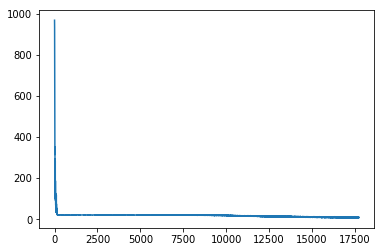

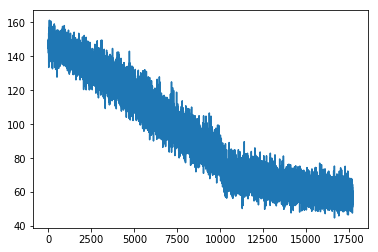

epoch 150 start


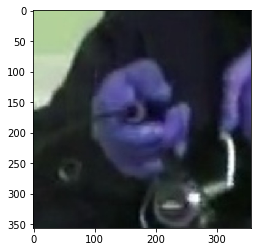

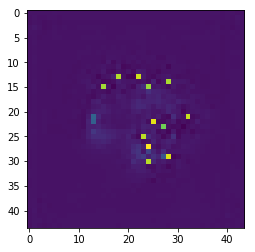

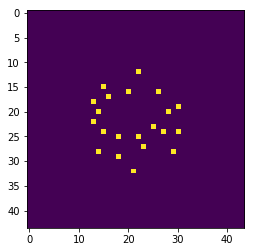

heatmap cost
Heat_loss :  7.8743715
vectormap cost
Vector_loss :  54.04609




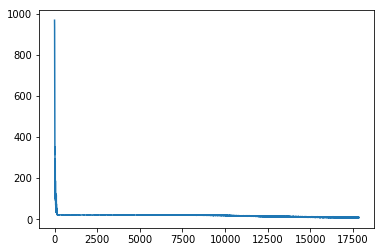

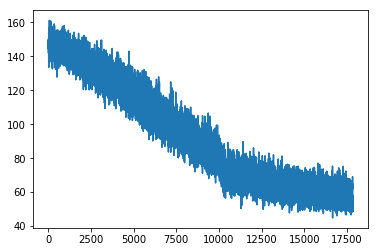

epoch 151 start


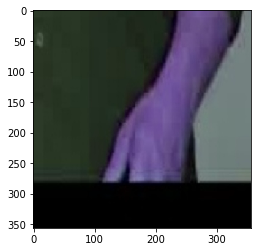

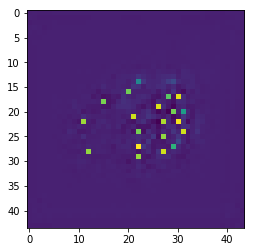

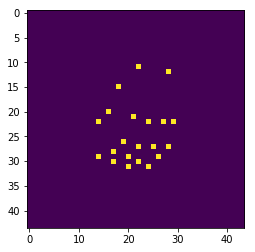

heatmap cost
Heat_loss :  7.7498255
vectormap cost
Vector_loss :  57.642338




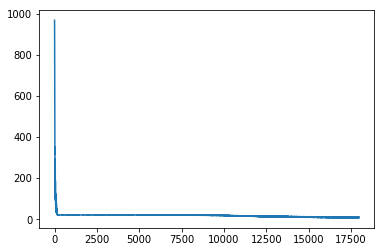

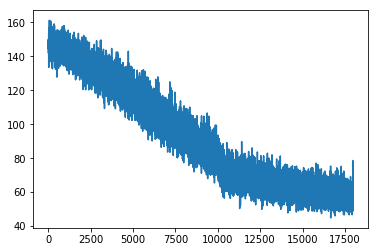

epoch 152 start


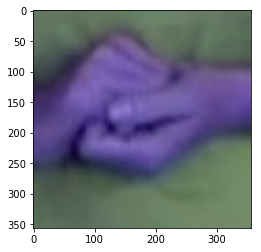

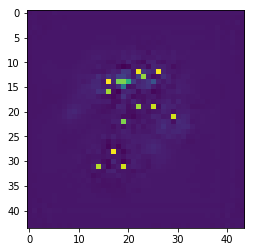

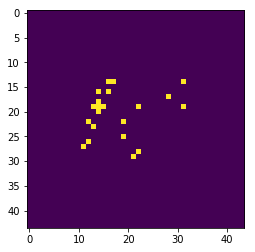

heatmap cost
Heat_loss :  9.036016
vectormap cost
Vector_loss :  64.19913




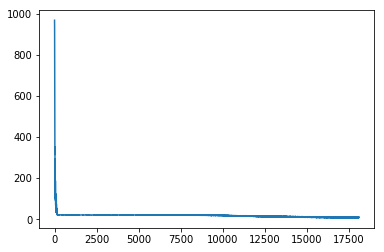

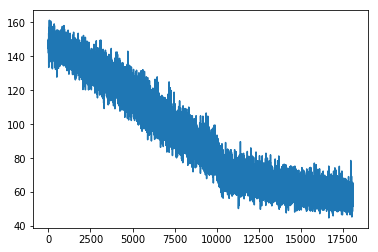

epoch 153 start


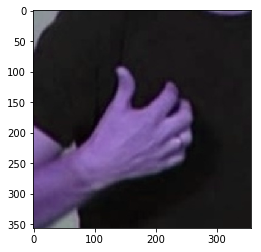

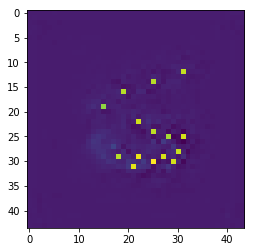

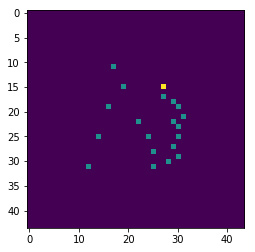

heatmap cost
Heat_loss :  7.453904
vectormap cost
Vector_loss :  52.161903




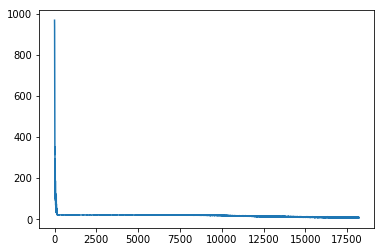

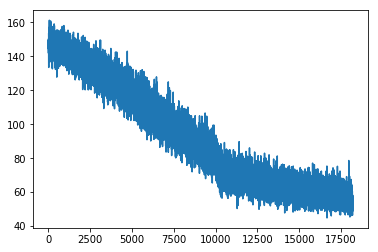

epoch 154 start


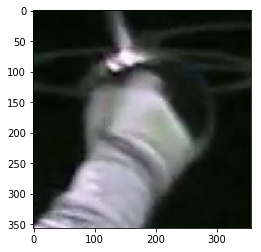

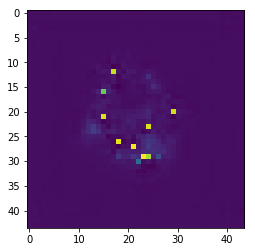

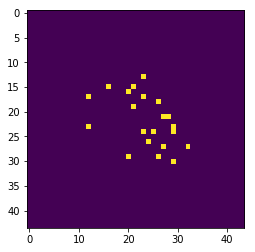

heatmap cost
Heat_loss :  7.9105673
vectormap cost
Vector_loss :  57.162663




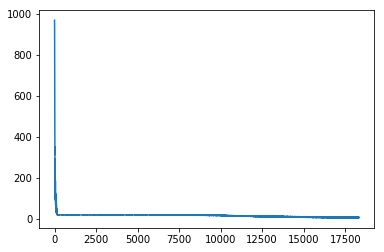

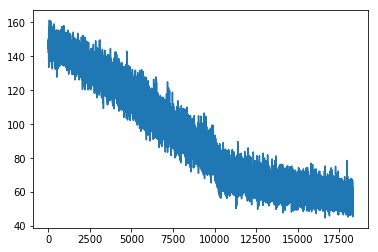

epoch 155 start


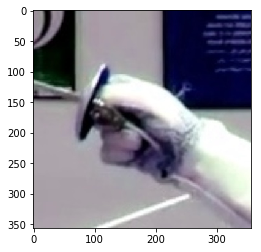

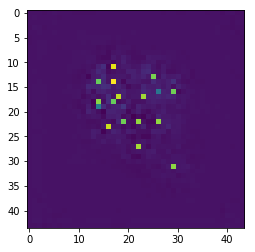

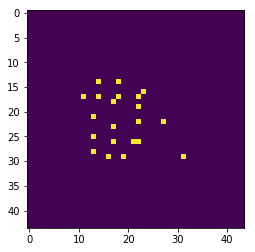

heatmap cost
Heat_loss :  8.4481535
vectormap cost
Vector_loss :  64.565125




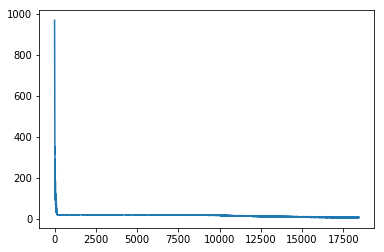

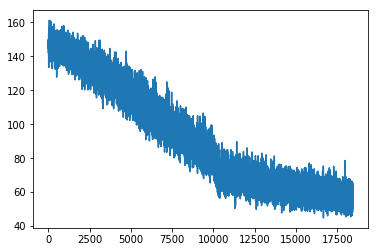

epoch 156 start


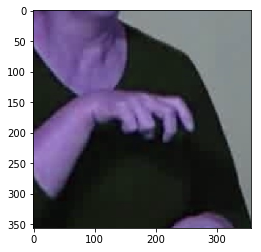

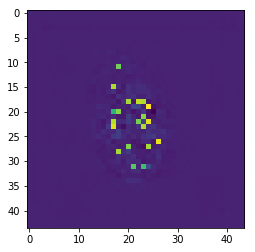

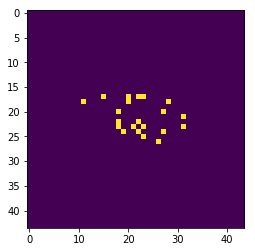

heatmap cost
Heat_loss :  7.9794493
vectormap cost
Vector_loss :  55.621563




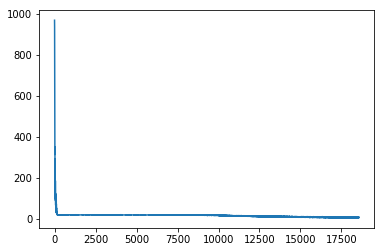

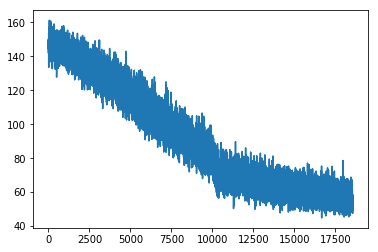

epoch 157 start


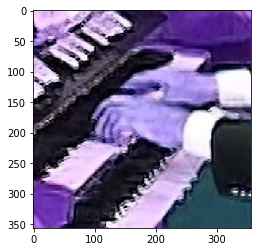

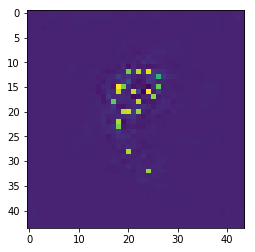

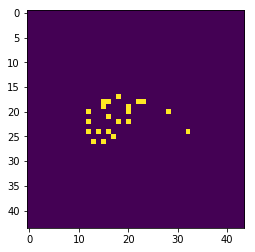

heatmap cost
Heat_loss :  7.542622
vectormap cost
Vector_loss :  54.900352




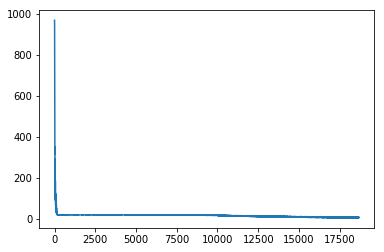

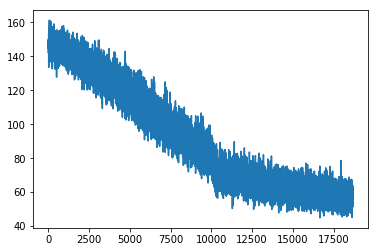

epoch 158 start


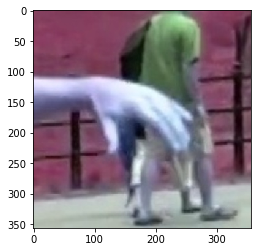

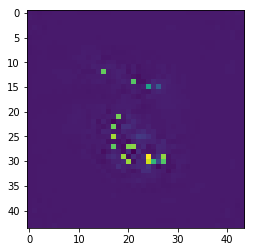

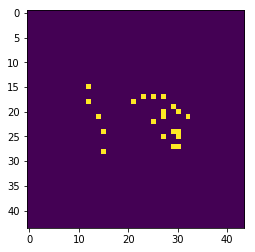

heatmap cost
Heat_loss :  8.76687
vectormap cost
Vector_loss :  55.620132




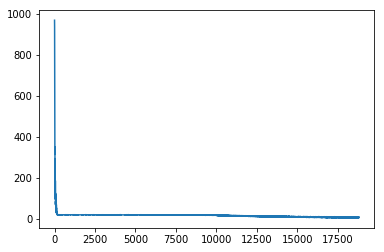

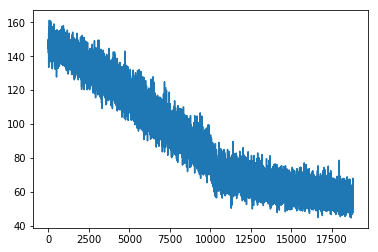

epoch 159 start


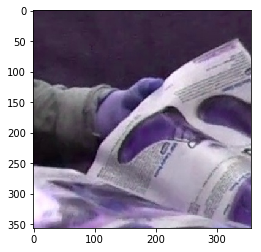

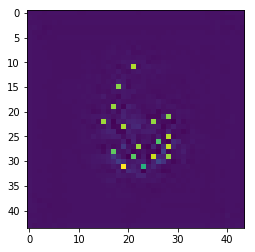

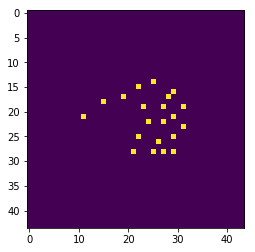

heatmap cost
Heat_loss :  7.9870415
vectormap cost
Vector_loss :  58.615005




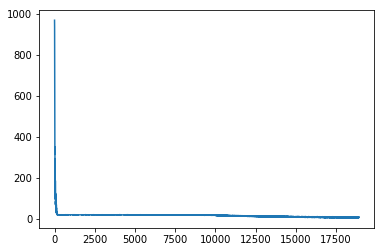

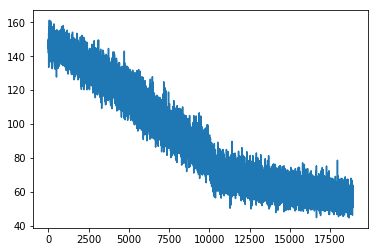

epoch 160 start


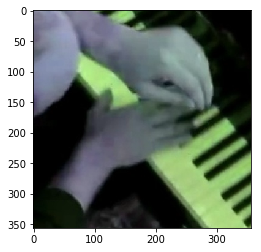

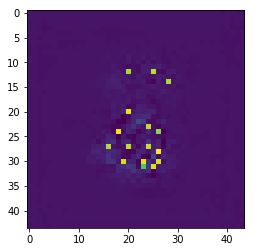

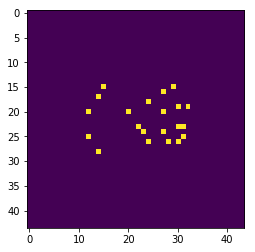

heatmap cost
Heat_loss :  7.3241653
vectormap cost
Vector_loss :  54.153324




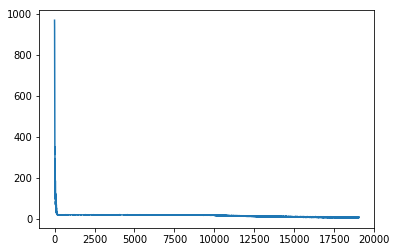

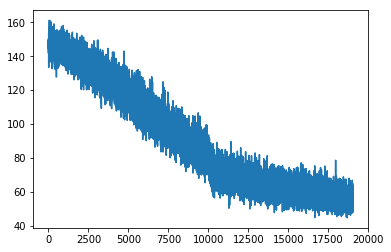

epoch 161 start


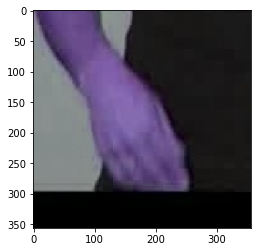

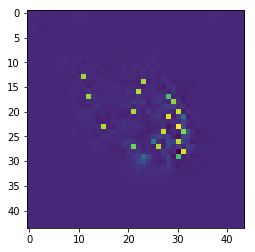

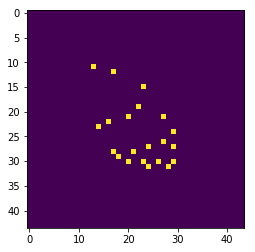

heatmap cost
Heat_loss :  7.113838
vectormap cost
Vector_loss :  51.50722




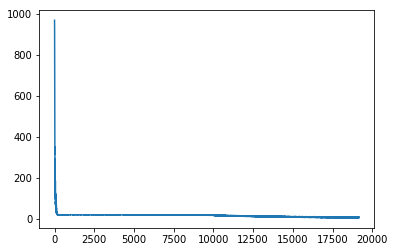

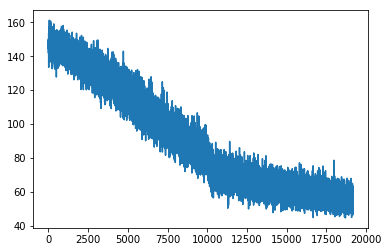

epoch 162 start


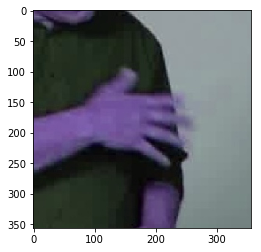

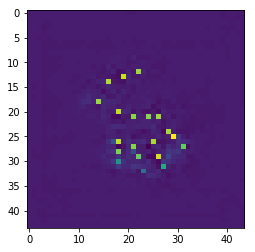

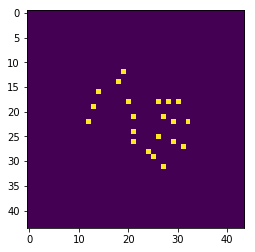

heatmap cost
Heat_loss :  7.6827106
vectormap cost
Vector_loss :  56.092804




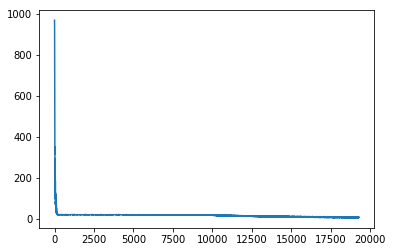

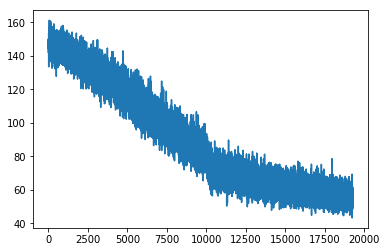

epoch 163 start


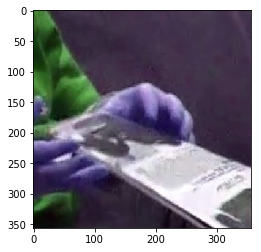

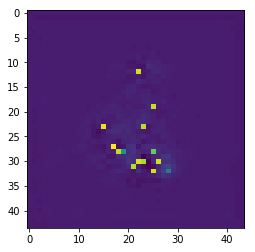

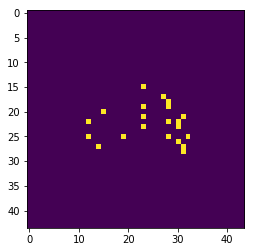

heatmap cost
Heat_loss :  8.886694
vectormap cost
Vector_loss :  62.80408




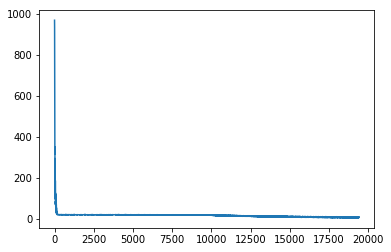

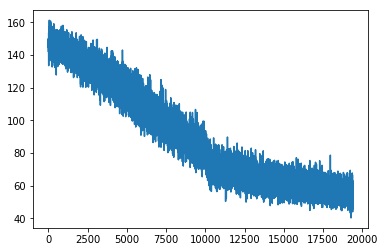

epoch 164 start


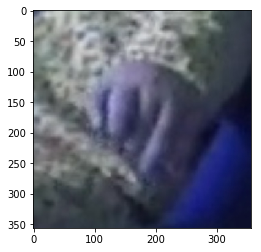

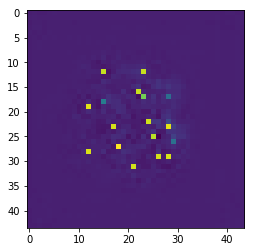

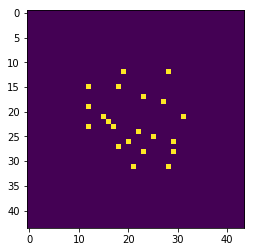

heatmap cost
Heat_loss :  6.750159
vectormap cost
Vector_loss :  54.18536




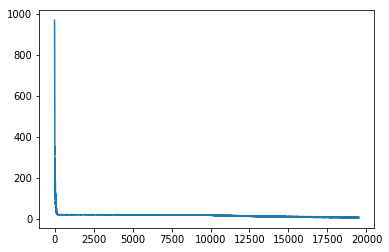

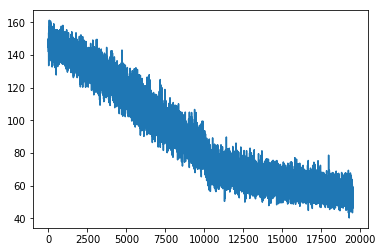

epoch 165 start


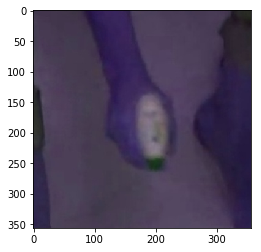

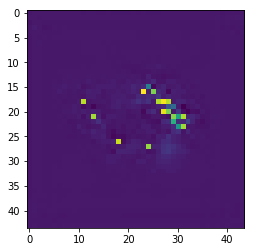

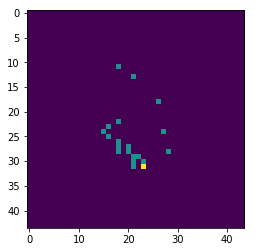

heatmap cost
Heat_loss :  8.114485
vectormap cost
Vector_loss :  59.295998




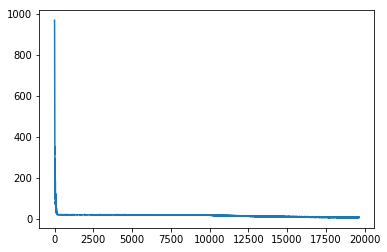

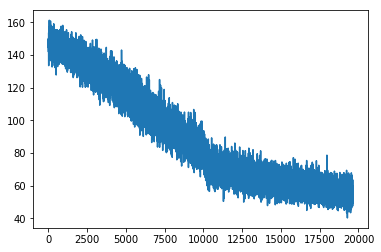

epoch 166 start


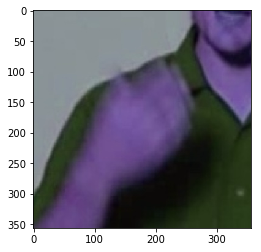

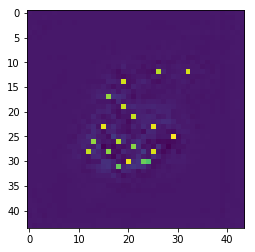

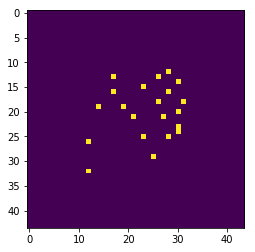

heatmap cost
Heat_loss :  6.3585534
vectormap cost
Vector_loss :  53.229767




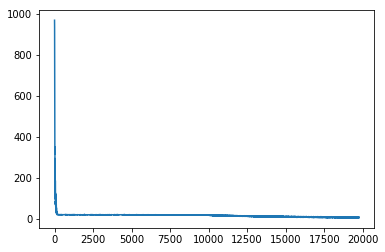

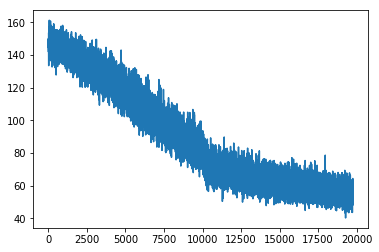

epoch 167 start


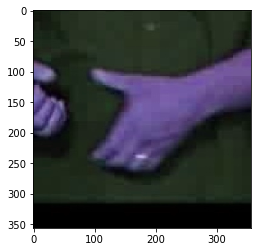

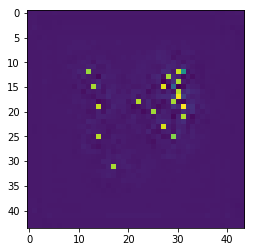

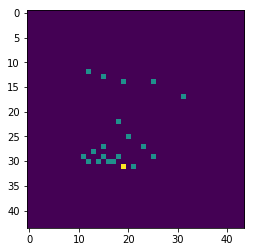

heatmap cost
Heat_loss :  7.4144516
vectormap cost
Vector_loss :  53.80402




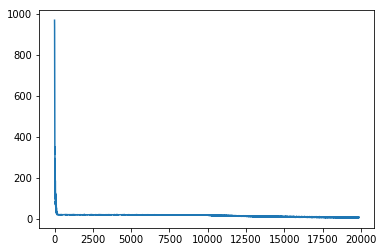

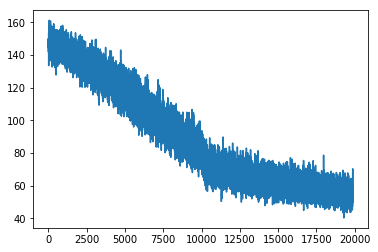

epoch 168 start


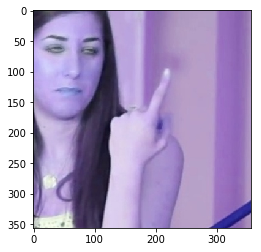

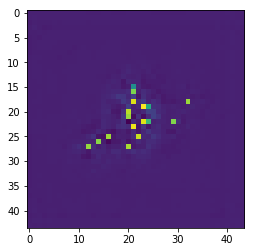

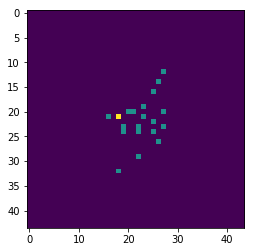

heatmap cost
Heat_loss :  8.998568
vectormap cost
Vector_loss :  60.149483




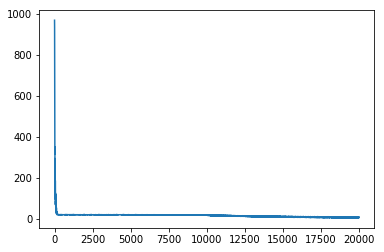

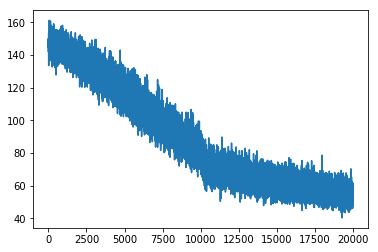

epoch 169 start


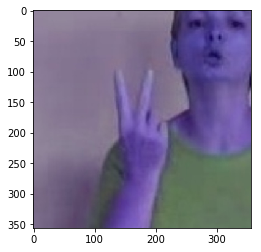

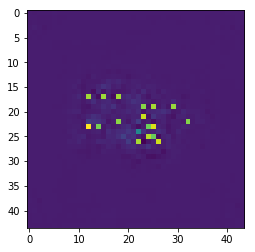

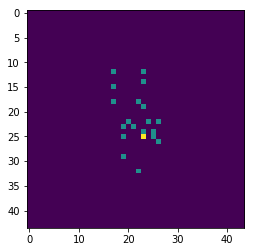

heatmap cost
Heat_loss :  5.193462
vectormap cost
Vector_loss :  48.51952




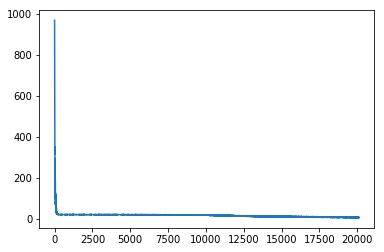

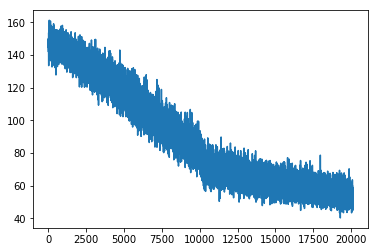

epoch 170 start


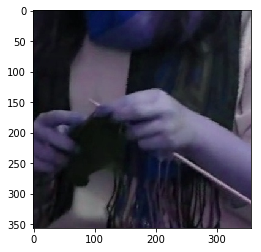

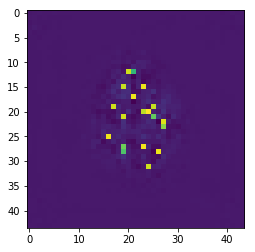

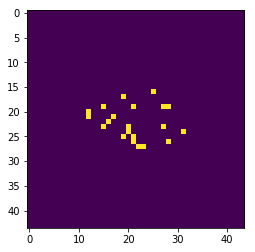

heatmap cost
Heat_loss :  7.131547
vectormap cost
Vector_loss :  51.44407




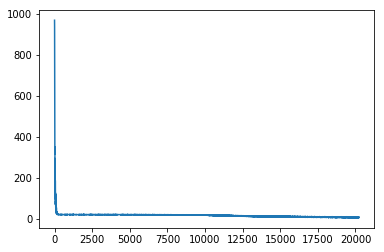

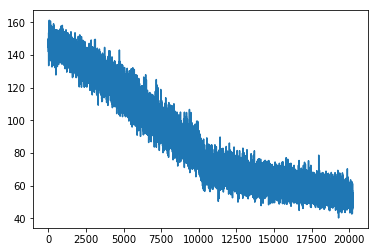

epoch 171 start


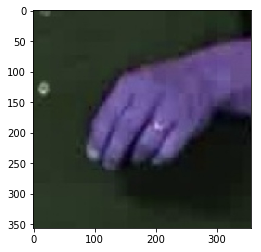

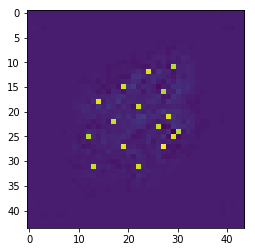

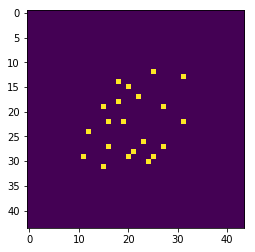

heatmap cost
Heat_loss :  5.8398433
vectormap cost
Vector_loss :  48.607166




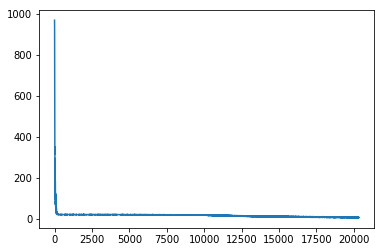

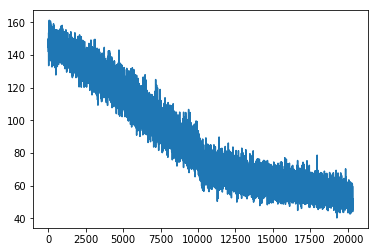

epoch 172 start


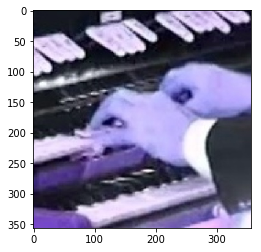

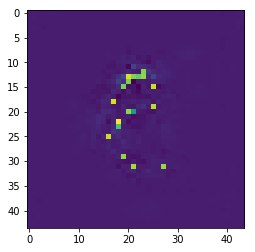

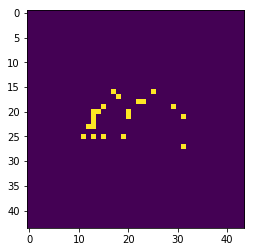

heatmap cost
Heat_loss :  5.1912947
vectormap cost
Vector_loss :  48.22453




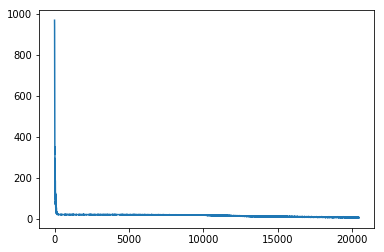

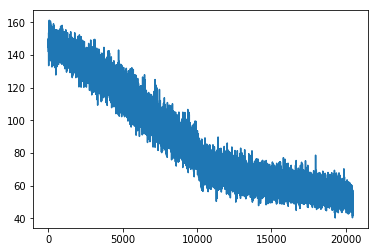

epoch 173 start


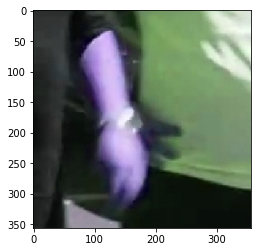

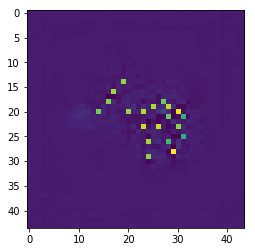

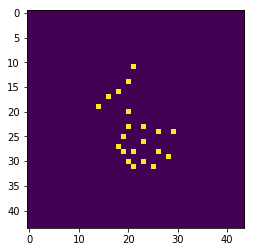

heatmap cost
Heat_loss :  6.2012234
vectormap cost
Vector_loss :  46.306164




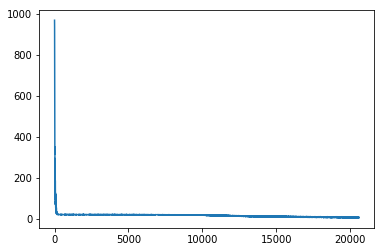

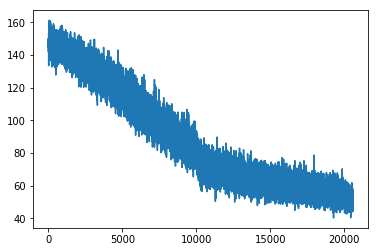

epoch 174 start


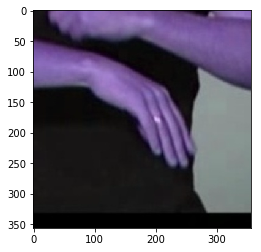

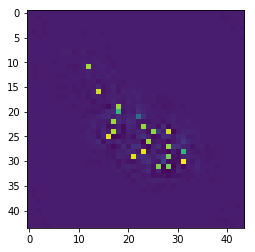

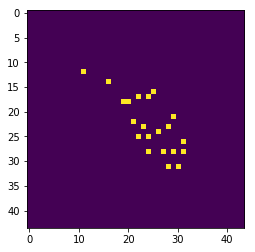

heatmap cost
Heat_loss :  6.1428785
vectormap cost
Vector_loss :  50.85512




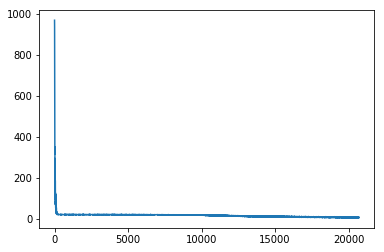

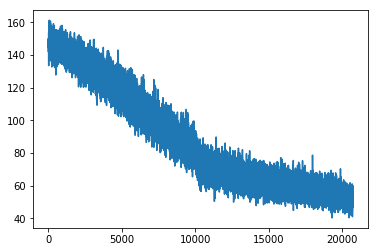

epoch 175 start


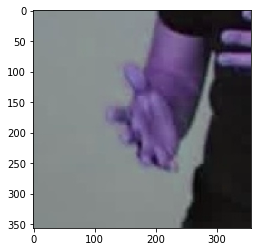

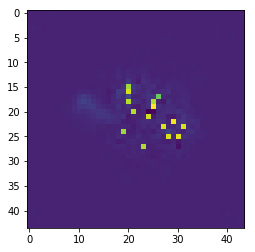

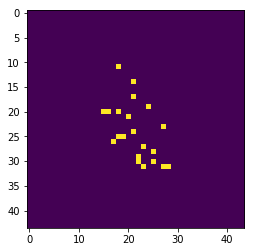

heatmap cost
Heat_loss :  5.5382347
vectormap cost
Vector_loss :  48.08704




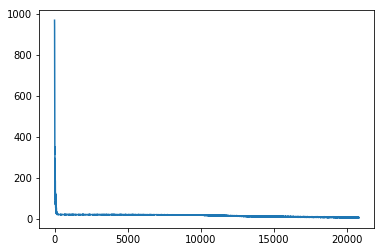

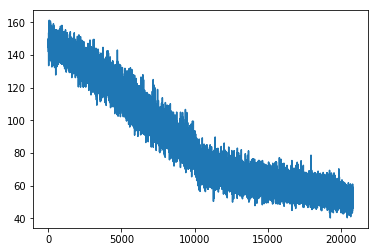

epoch 176 start


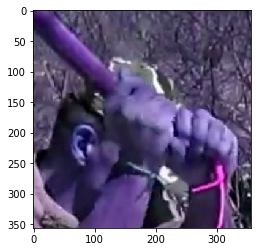

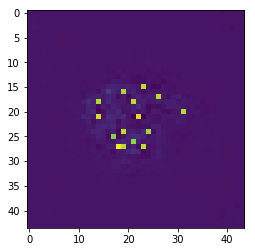

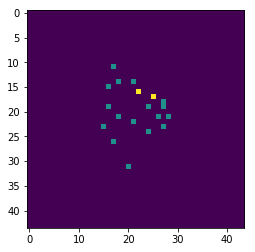

heatmap cost
Heat_loss :  6.309085
vectormap cost
Vector_loss :  53.25576




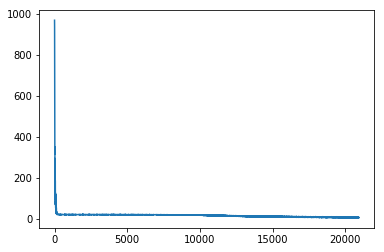

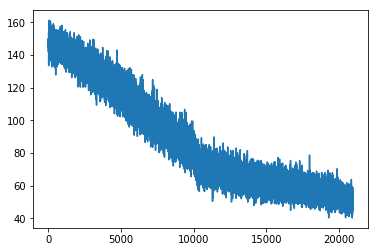

epoch 177 start


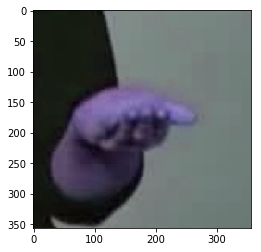

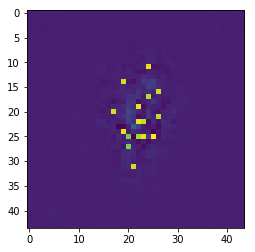

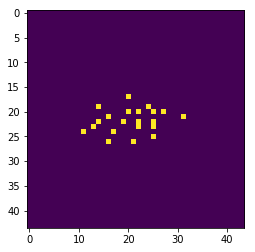

heatmap cost
Heat_loss :  5.44479
vectormap cost
Vector_loss :  46.335987




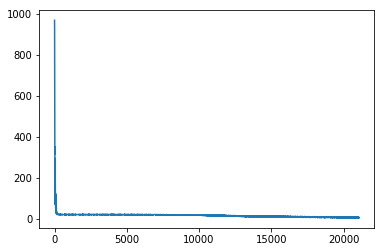

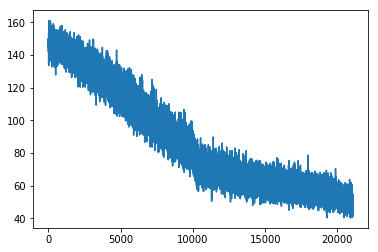

epoch 178 start


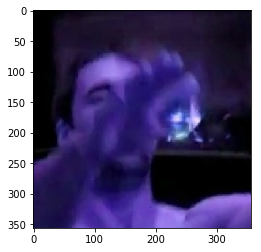

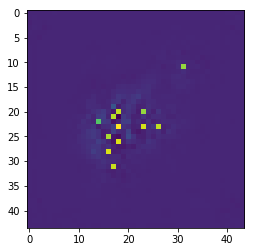

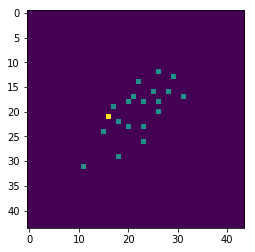

heatmap cost
Heat_loss :  5.7119045
vectormap cost
Vector_loss :  46.862873




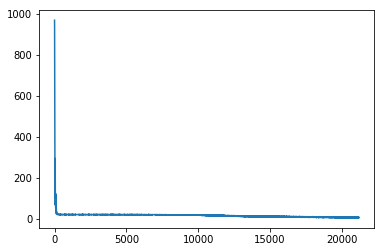

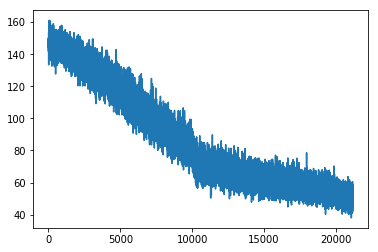

epoch 179 start


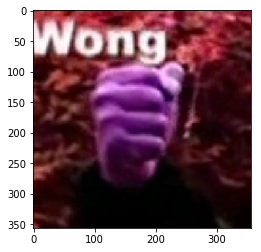

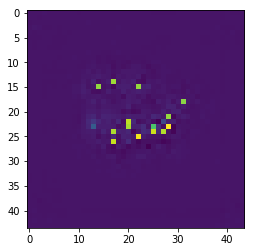

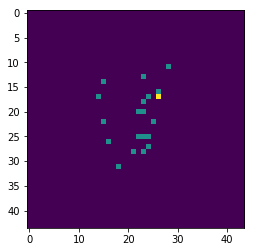

heatmap cost
Heat_loss :  6.3352675
vectormap cost
Vector_loss :  56.958427




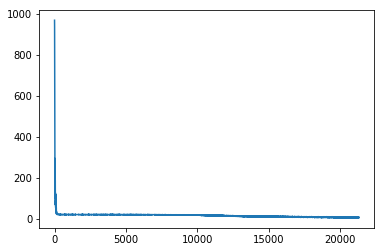

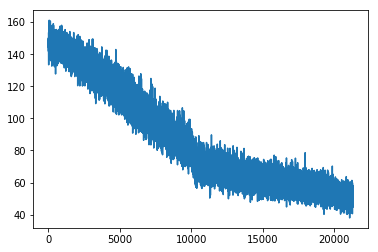

epoch 180 start


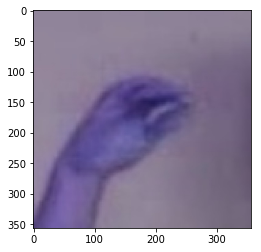

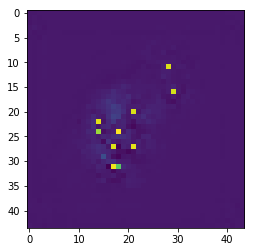

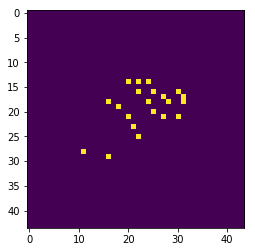

heatmap cost
Heat_loss :  7.1441565
vectormap cost
Vector_loss :  52.528854




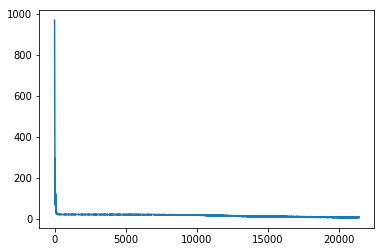

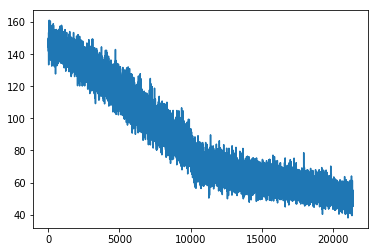

epoch 181 start


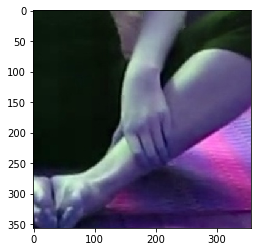

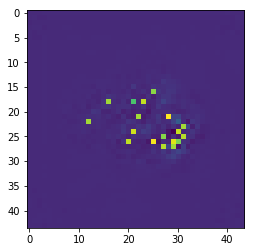

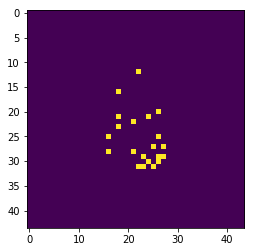

heatmap cost
Heat_loss :  5.668152
vectormap cost
Vector_loss :  47.18922




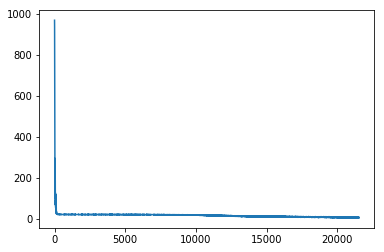

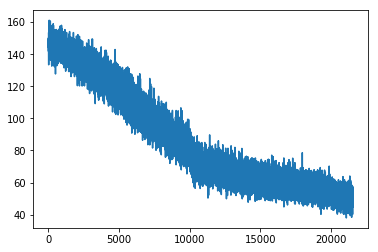

epoch 182 start


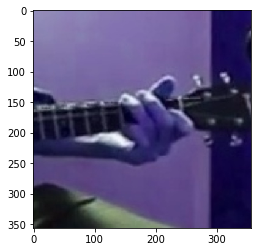

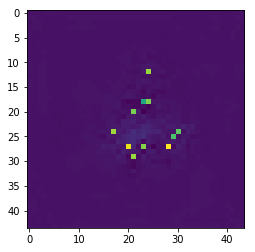

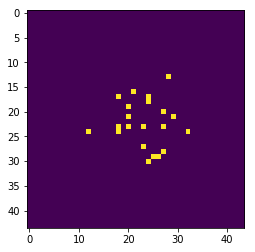

heatmap cost
Heat_loss :  8.022292
vectormap cost
Vector_loss :  59.695442




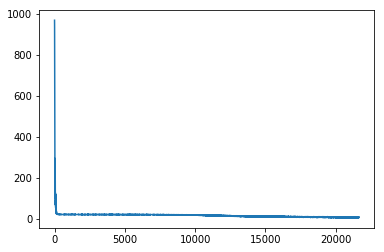

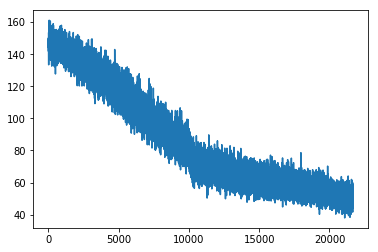

epoch 183 start


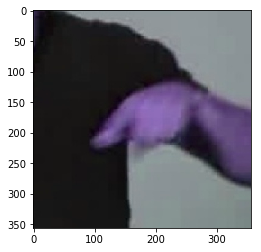

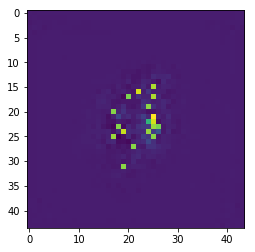

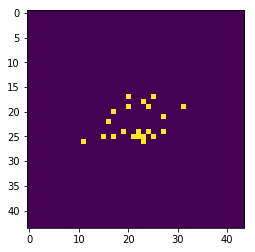

heatmap cost
Heat_loss :  5.6376066
vectormap cost
Vector_loss :  49.580196




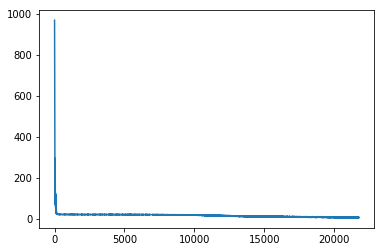

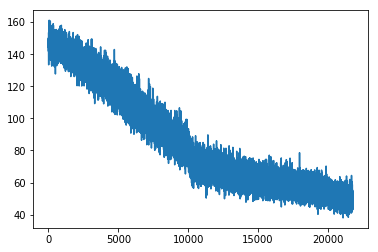

epoch 184 start


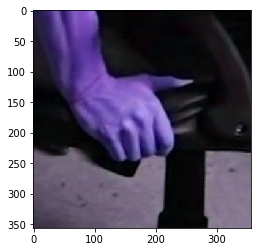

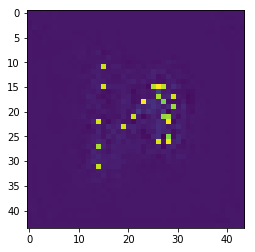

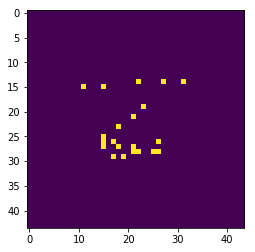

heatmap cost
Heat_loss :  5.533892
vectormap cost
Vector_loss :  50.030323




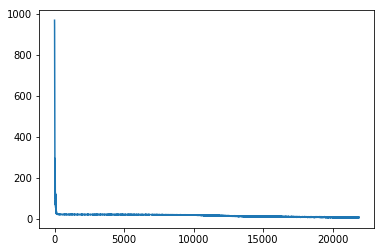

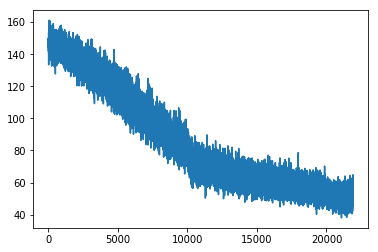

epoch 185 start


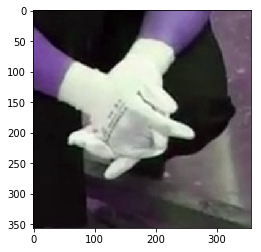

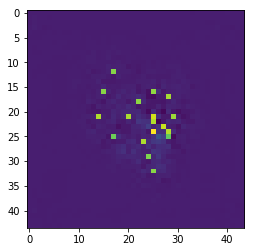

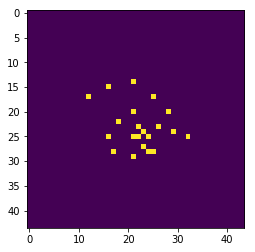

heatmap cost
Heat_loss :  5.8965874
vectormap cost
Vector_loss :  57.709995




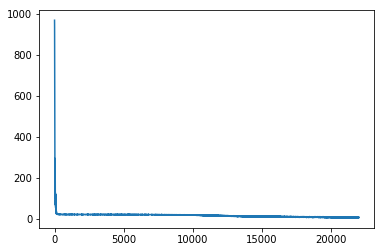

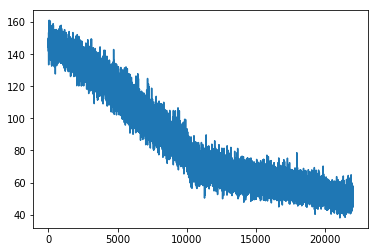

epoch 186 start


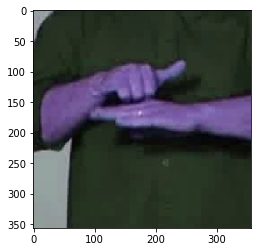

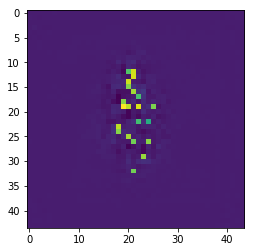

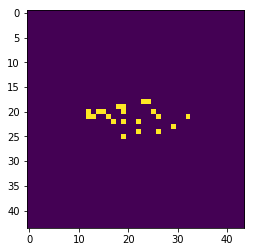

heatmap cost
Heat_loss :  4.543149
vectormap cost
Vector_loss :  44.98711




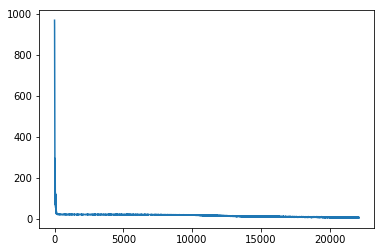

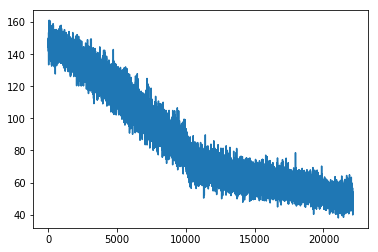

epoch 187 start


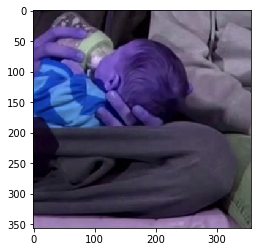

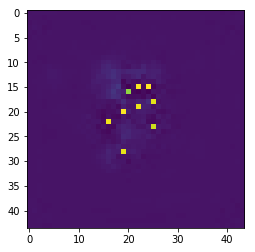

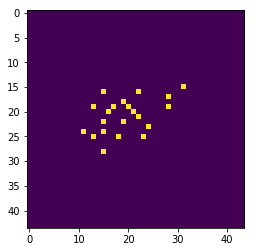

heatmap cost
Heat_loss :  7.2324905
vectormap cost
Vector_loss :  55.185074




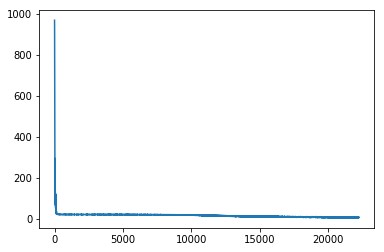

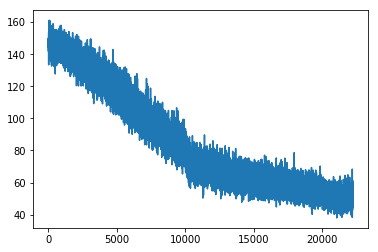

epoch 188 start


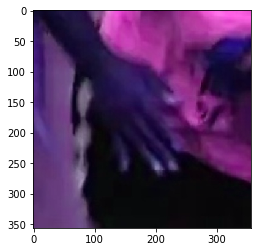

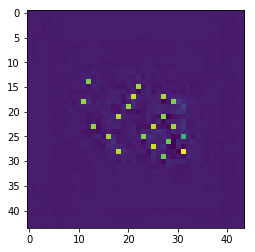

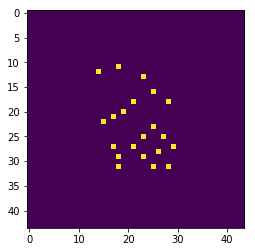

heatmap cost
Heat_loss :  5.0654263
vectormap cost
Vector_loss :  47.50116




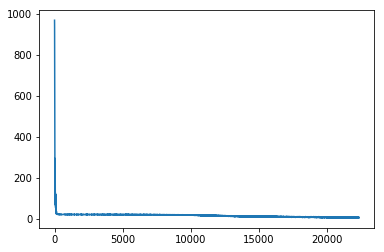

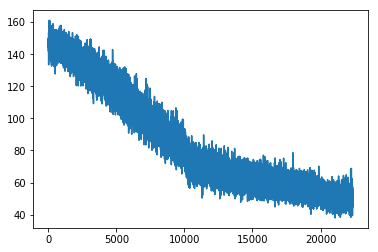

epoch 189 start


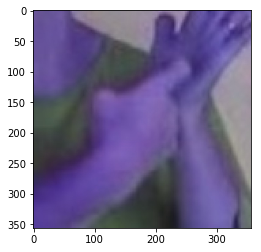

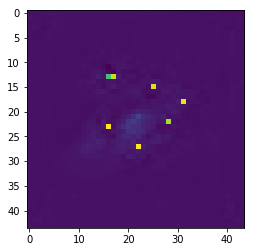

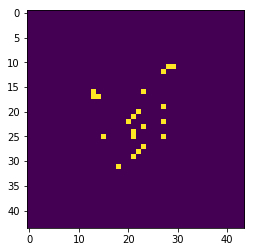

heatmap cost
Heat_loss :  6.272045
vectormap cost
Vector_loss :  50.011993




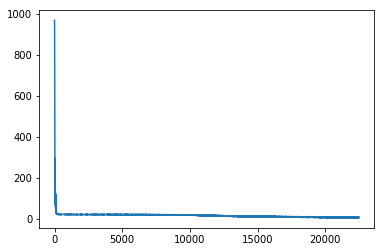

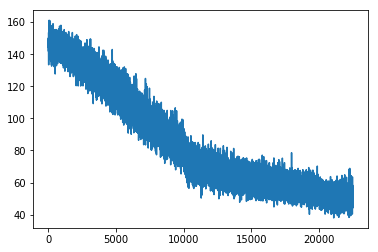

epoch 190 start


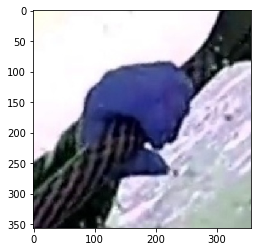

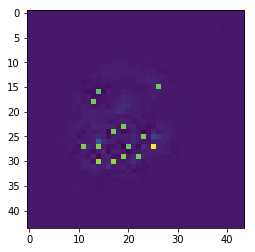

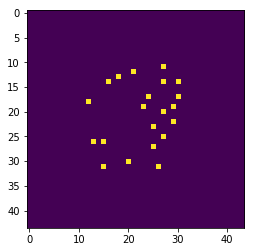

heatmap cost
Heat_loss :  4.9915814
vectormap cost
Vector_loss :  46.922077




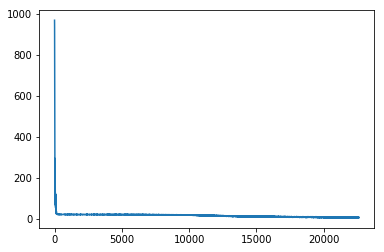

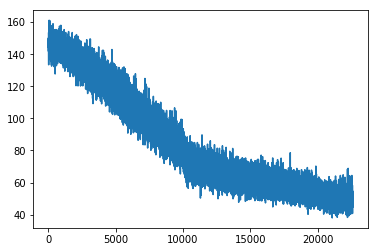

epoch 191 start


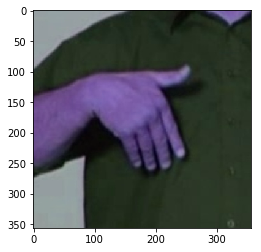

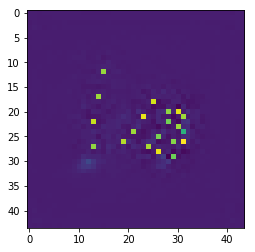

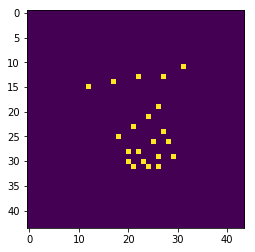

heatmap cost
Heat_loss :  6.5336103
vectormap cost
Vector_loss :  50.10418




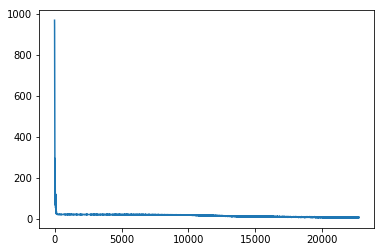

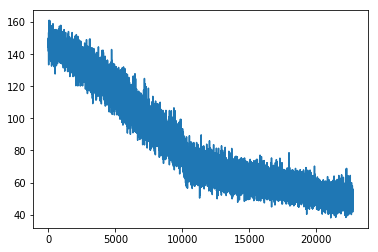

epoch 192 start


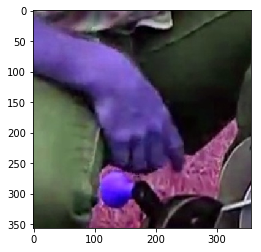

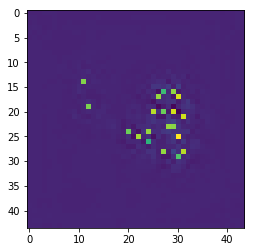

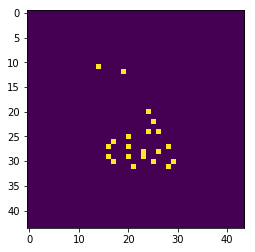

heatmap cost
Heat_loss :  6.42954
vectormap cost
Vector_loss :  51.113697




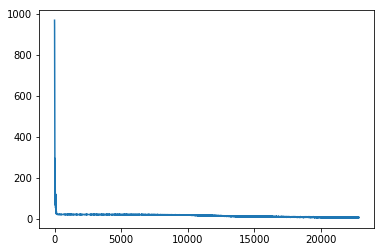

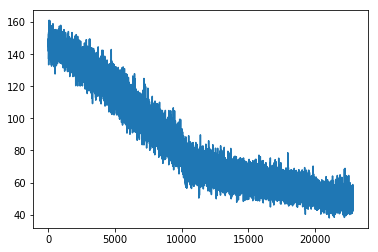

epoch 193 start


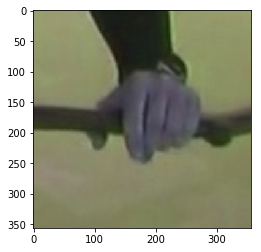

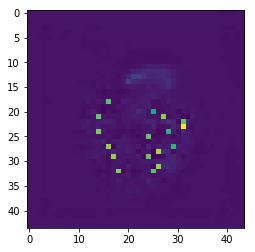

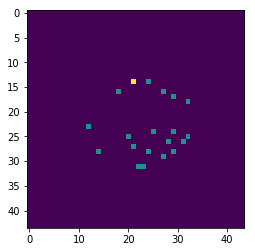

heatmap cost
Heat_loss :  4.051016
vectormap cost
Vector_loss :  42.440132




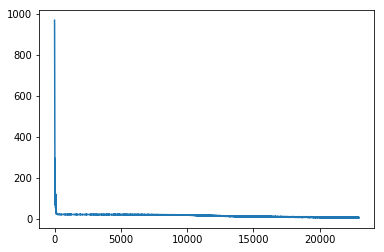

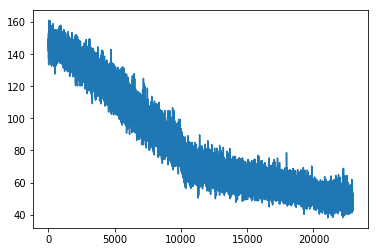

epoch 194 start


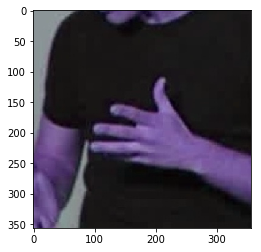

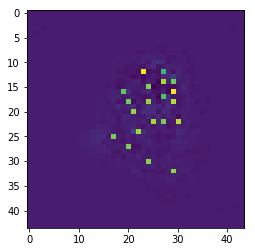

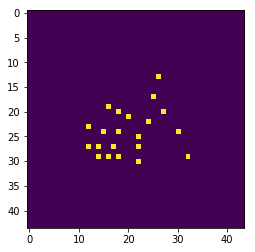

heatmap cost
Heat_loss :  4.825661
vectormap cost
Vector_loss :  41.537674




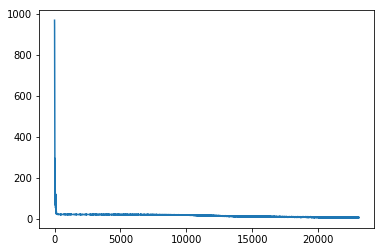

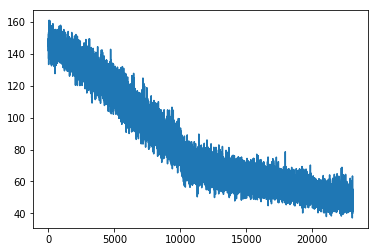

epoch 195 start


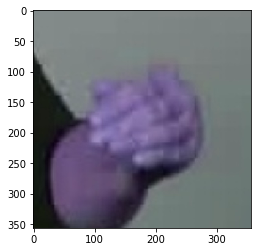

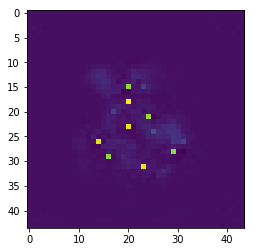

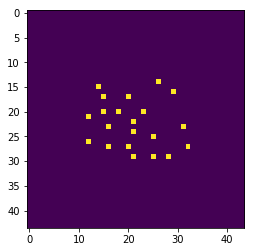

heatmap cost
Heat_loss :  6.101459
vectormap cost
Vector_loss :  47.90796




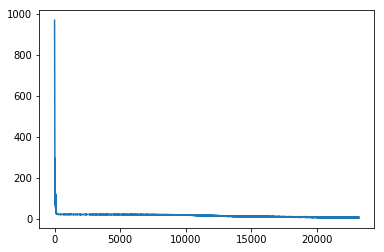

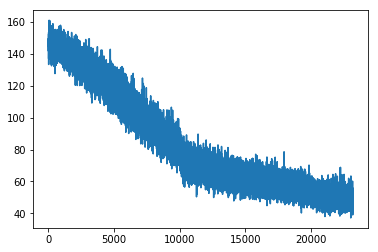

epoch 196 start


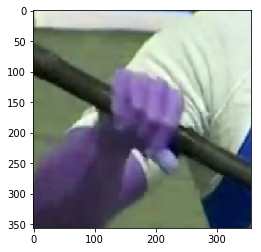

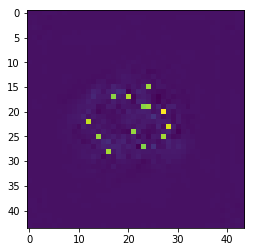

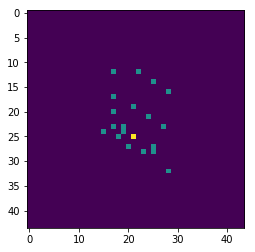

heatmap cost
Heat_loss :  4.6095333
vectormap cost
Vector_loss :  45.724106




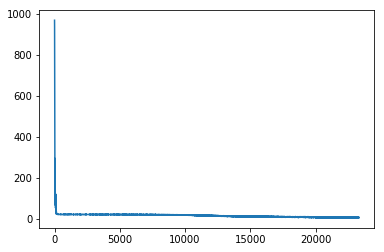

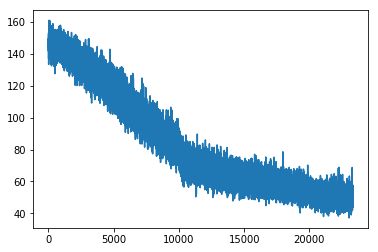

epoch 197 start


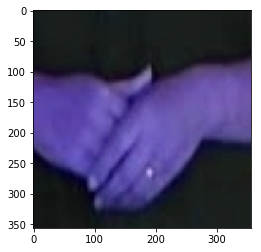

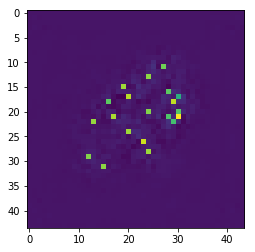

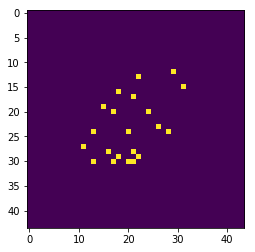

heatmap cost
Heat_loss :  5.869854
vectormap cost
Vector_loss :  45.829582




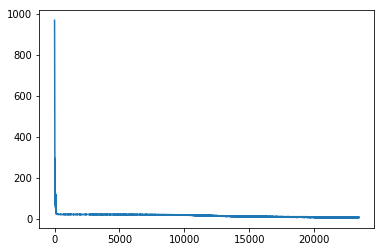

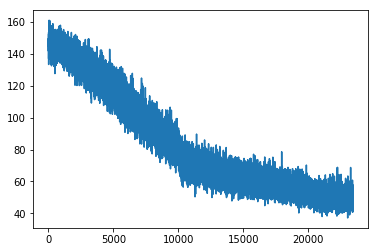

epoch 198 start


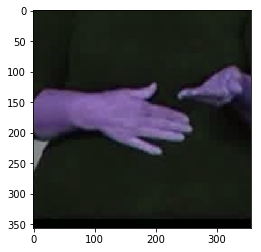

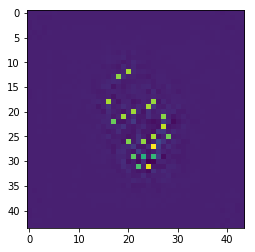

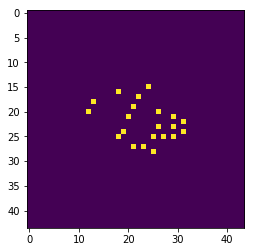

heatmap cost
Heat_loss :  4.580783
vectormap cost
Vector_loss :  41.43903




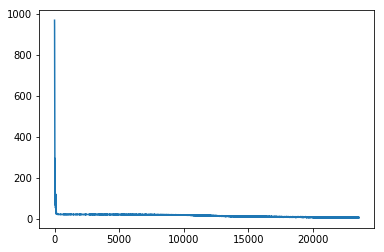

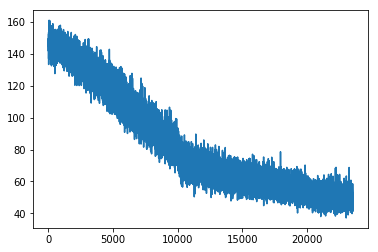

epoch 199 start


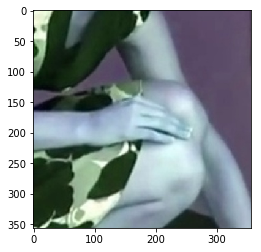

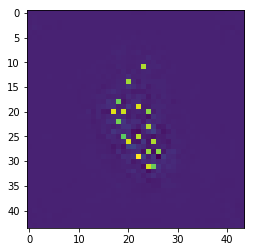

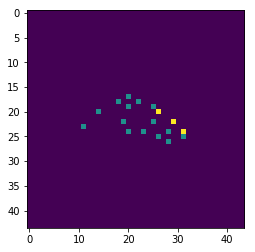

heatmap cost
Heat_loss :  5.815181
vectormap cost
Vector_loss :  51.190285




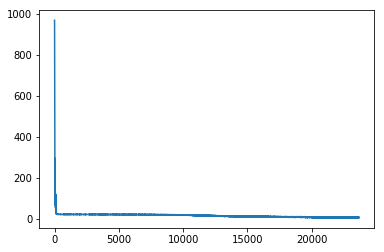

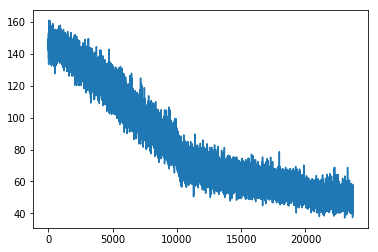

epoch 200 start


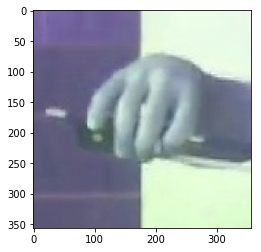

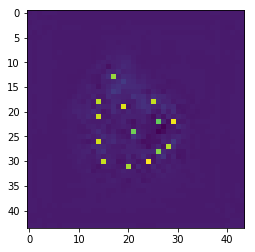

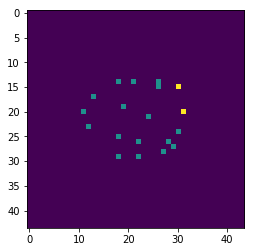

heatmap cost
Heat_loss :  5.804006
vectormap cost
Vector_loss :  49.97272




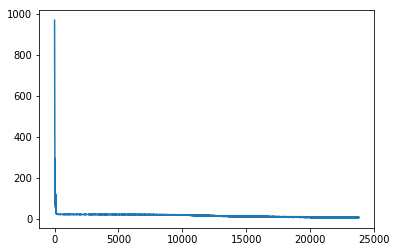

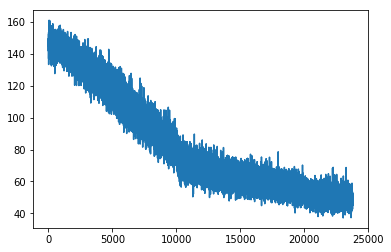

In [5]:
with tf.Session() as sess:
    obj = OpenPose(sess = sess, epochs=200, batch_size=16)
    #img, confidencemap, PAFs = obj.train()
    obj.train()

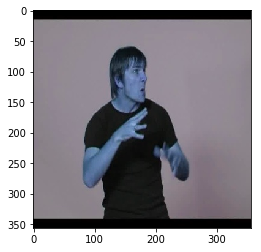

In [16]:
plt.imshow(img[1])
plt.show()

In [17]:
_confidencemap = confidencemap[1]

In [18]:
__confidencemap = np.transpose(_confidencemap, [2, 0, 1])

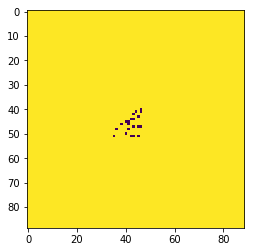

In [19]:
plt.imshow(__confidencemap[21])
plt.show()

In [10]:
buffer = np.zeros((356, 356))
for i in range(21):
    buffer = buffer + __confidencemap[i]

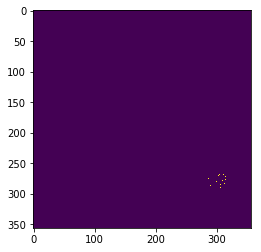

In [11]:
plt.imshow(buffer)
plt.show()